In [1]:
import matplotlib.pyplot as plt
import random
import json

In [56]:
%matplotlib widget

In [3]:
from scipy import ndimage
import numpy as np
from copy import deepcopy
from PIL import Image
import IPython.display
from math import floor

In [4]:
import torch
import torch.nn as nn                     # neural networks
import torch.nn.functional as F           # layers, activations and more
import torch.optim as optim  
import torchvision.transforms.functional as TF

In [5]:
import torchvision
from torchvision import datasets, models, transforms

In [6]:
is_cuda = torch.cuda.is_available()
is_cuda

False

In [7]:
if(is_cuda):
    USE_GPU = True
else:
    USE_GPU = False

In [8]:
ENDWORD = '<END>'
STARTWORD = '<START>'
PADWORD = '<PAD>'
HEIGHT = 299
WIDTH = 299
INPUT_EMBEDDING = 300
HIDDEN_SIZE = 300
OUTPUT_EMBEDDING = 300

CAPTION_FILE = 'caption_datasets/dataset_flickr8k.json'
IMAGE_DIR = 'Flicker8k_Dataset/'

In [9]:
import string

In [10]:
inception =models.inception_v3(pretrained=True)

In [11]:
inception

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, t

In [12]:
def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [13]:
num_ftrs = inception.fc.in_features
num_ftrs

2048

In [14]:
set_parameter_requires_grad(inception, True)
num_ftrs = inception.fc.in_features
inception.fc = nn.Linear(num_ftrs,INPUT_EMBEDDING)

In [15]:
inception.load_state_dict(torch.load('models/inception_epochs_40.pth'))

In [16]:
if(USE_GPU):
    inception.cuda()

## Class for holding data

In [322]:
class Flickr8KImageCaptionDataset:
    
    def __init__(self):
        
        all_data = json.load(open('caption_datasets/dataset_flickr8k.json', 'r'))
        all_data=all_data['images']
        
        self.training_data = []
        self.test_data = []
        self.w2i = {ENDWORD: 0, STARTWORD: 1}
        self.word_frequency = {ENDWORD: 0, STARTWORD: 0}
        self.i2w = {0: ENDWORD, 1: STARTWORD}
        self.tokens = 2 #END is default
        self.batch_index = 0
        
        for data in all_data:
            if(data['split']=='train'):
                self.training_data.append(data)
            else:
                self.test_data.append(data)
                
            for sentence in data['sentences']:
                for token in sentence['tokens']:
                    if(token not in self.w2i.keys()):
                        self.w2i[token] = self.tokens
                        self.i2w[self.tokens] = token
                        self.tokens +=1
                        self.word_frequency[token] = 1
                    else:
                        self.word_frequency[token] += 1
                        
    def image_to_tensor(self,filename):
        image = Image.open(filename)
        image = TF.resize(img=image, size=(HEIGHT,WIDTH))
       
        image = TF.to_tensor(pic=image)
        image = TF.normalize(image, mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
        
        return torch.unsqueeze(image,0)

    
    def return_train_batch(self): #size of 1 always
        
        #np.random.shuffle(self.training_data)
        for index in range(len(self.training_data)):
        
        #index = np.random.randint(len(self.training_data))
            sentence_index = np.random.randint(len(self.training_data[index]['sentences']))
            output_sentence_tokens = deepcopy(self.training_data[index]['sentences'][sentence_index]['tokens'])
            output_sentence_tokens.append(ENDWORD) #corresponds to end word

            image = self.image_to_tensor('Flicker8k_Dataset/'+self.training_data[index]['filename'])


            yield image, list(map(lambda x: self.w2i[x], output_sentence_tokens)), output_sentence_tokens, index
    
    def convert_tensor_to_word(self, output_tensor):
        output = F.log_softmax(output_tensor.detach().squeeze(), dim=0).numpy()
        return self.i2w[np.argmax(output)]
    
    def convert_sentence_to_tokens(self, sentence):
        
        tokens = sentence.split(" ")
        converted_tokens= list(map(lambda x: self.w2i[x], tokens))
        converted_tokens.append(self.w2i[ENDWORD])
        return converted_tokens
    
    def caption_image_greedy(self, net, image_filename, max_words=15): #non beam search, no temperature implemented
        net.eval()
        inception.eval()
        image_tensor = self.image_to_tensor(image_filename)
        hidden=None
        embedding=None
        words = []
    
        input_token = STARTWORD
        input_tensor = torch.tensor(self.w2i[input_token]).type(torch.LongTensor)
        
        
        for i in range(max_words):
            
            if(i==0):
                out, hidden=net(input_tensor, hidden=image_tensor, process_image=True)
            else:
                out, hidden=net(input_tensor, hidden)
                
            word = self.convert_tensor_to_word(out)
            
            input_token = self.w2i[word]
            input_tensor = torch.tensor(input_token).type(torch.LongTensor)
            
            
            if(word==ENDWORD):
                break
            else:
                words.append(word)

        return ' '.join(words)
    
    
    def forward_beam(self, net, hidden, process_image, partial_sentences, sentences, topn_words=5, max_sentences=10):
        
        max_words = 50
        
        hidden_index = {}
        
        while(sentences<max_sentences):
            
            #print("Sentences: ",sentences)
            
            new_partial_sentences = []
            new_partial_sentences_logp = []
            new_partial_avg_logp= []
            
            if(len(partial_sentences[-1][0])>max_words):
                break
            
            
        
            for partial_sentence in partial_sentences:

                input_token = partial_sentence[0][-1]

                input_tensor = torch.tensor(self.w2i[input_token]).type(torch.FloatTensor)

                if(partial_sentence[0][-1]==STARTWORD):
                    out, hidden=net(input_tensor, hidden, process_image=True)
                else:
                    out, hidden=net(input_tensor, torch.tensor(hidden_index[input_token]))

                #take first topn words and add as children to root

                out = F.log_softmax(out.detach().squeeze(), dim=0).numpy()
                out_indexes = np.argsort(out)[::-1][:topn_words]

        
                for out_index in out_indexes:
                    
                    if(self.i2w[out_index]==ENDWORD):
                        sentences=sentences+1
                        
                    else:
                    
                        total_logp = float(out[out_index]) + partial_sentence[1]
                        new_partial_sentences_logp.append(total_logp)
                        new_partial_sentences.append([np.concatenate((partial_sentence[0], [self.i2w[out_index]])),total_logp])
                        
                        len_words = len(new_partial_sentences[-1][0])
                        
                        
                        
                        new_partial_avg_logp.append(total_logp/len_words)
                        
                        #print(self.i2w[out_index])
                        
                        hidden_index[self.i2w[out_index]] = deepcopy(hidden.detach().numpy())
                
        
            
                
            #select topn partial sentences
        
            top_indexes = np.argsort(new_partial_sentences_logp)[::-1][:topn_words]
            
            
            
            
            
            
        
        
            new_partial_sentences = np.array(new_partial_sentences)[top_indexes]
        
            #print("New partial sentences (topn):", new_partial_sentences)
        
            partial_sentences = new_partial_sentences
        
            
        return partial_sentences
    
    def caption_image_beam_search(self, net, image_filename, topn_words=10, max_sentences=10):
        
        net.eval()
        inception.eval()
        image_tensor = self.image_to_tensor(image_filename)
        hidden=None
        embedding=None
        words = []
    
        
        sentences = 0
        partial_sentences = [[[STARTWORD], 0.0]]
        #root_id = hash(input_token) #for start word
        #nodes = {}
        
        #nodes[root_id] = Node(root_id, [STARTWORD, 0], None)
       
        partial_sentences = self.forward_beam(net, image_tensor, True, partial_sentences, sentences,  topn_words, max_sentences)
    
        logp = []
        
        joined_sentences = []
    
        for partial_sentence in partial_sentences:
            
        
            joined_sentences.append([' '.join(partial_sentence[0][1:]),partial_sentence[1]])
            
            
                
        return joined_sentences

    def print_beam_caption(self, net, train_filename,num_captions=0):
        beam_sentences = f.caption_image_beam_search(net,train_filename)
        if(num_captions==0):
            num_captions=len(beam_sentences)
        for sentence in beam_sentences[:num_captions]:
            print(sentence[0]+" [",sentence[1], "]")
        
        
    

## class for network

In [333]:
class IC_V6(nn.Module):
    
    #V2: Fed image vector directly as hidden and fed words generated as iputs back to LSTM
    #V3: Added an embedding layer between words input and GRU/LSTM
    
    def __init__(self, token_dict_size):
        super(IC_V6, self).__init__()
        
        #Input is an image of height 500, and width 500
        
        
        self.embedding_size = INPUT_EMBEDDING
        self.hidden_state_size = HIDDEN_SIZE
        self.token_dict_size = token_dict_size
        self.output_size = OUTPUT_EMBEDDING
        
        self.batchnorm = nn.BatchNorm1d(self.embedding_size)
        
        self.input_embedding = nn.Embedding(self.token_dict_size, self.embedding_size)
        
        self.embedding_dropout = nn.Dropout(p=0.22)
        self.gru_layers = 3
        
        self.gru = nn.GRU(input_size=self.embedding_size, hidden_size=self.hidden_state_size, num_layers=self.gru_layers, dropout=0.22)
        self.linear = nn.Linear(self.hidden_state_size, self.output_size)
        self.out = nn.Linear(self.output_size, token_dict_size)
        
    def forward(self, input_tokens, hidden, process_image=False, use_inception=True):
        
        
        
        if(USE_GPU):
            device = torch.device('cuda')
        else:
            device = torch.device('cpu')
        
        if(process_image):
            if(use_inception):
                inp=self.embedding_dropout(inception(hidden))
            else:
                inp=hidden
            #inp=self.batchnorm(inp)
            hidden=torch.zeros((self.gru_layers,1, self.hidden_state_size))
        else:
            inp=self.embedding_dropout(self.input_embedding(input_tokens.view(1).type(torch.LongTensor).to(device)))
            #inp=self.batchnorm(inp)
            
        
        hidden = hidden.view(self.gru_layers,1,-1)
        inp = inp.view(1,1,-1)
        
        out, hidden = self.gru(inp, hidden)
        out = self.out(self.linear(out))
        
        
        
        return out, hidden
    
    

In [334]:
f = Flickr8KImageCaptionDataset()

In [335]:
net = IC_V6(f.tokens)

In [336]:
net.load_state_dict(torch.load('models/epochs_40_loss_2_841_v6.pth'))

In [22]:
if(USE_GPU):
    net.cuda()
    inception.cuda()

In [337]:
net.eval()

IC_V6(
  (batchnorm): BatchNorm1d(300, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (input_embedding): Embedding(8385, 300)
  (embedding_dropout): Dropout(p=0.22)
  (gru): GRU(300, 300, num_layers=3, dropout=0.22)
  (linear): Linear(in_features=300, out_features=300, bias=True)
  (out): Linear(in_features=300, out_features=8385, bias=True)
)

Original caption:  A sports team is lined up outside .

Greedy caption: a group of people are playing soccer on a field

Beam caption:
a group of people are playing soccer game [ -6.904660165309906 ]
a group of people are playing in a [ -7.547600746154785 ]
a group of people in a soccer game [ -7.869019985198975 ]
a group of people are playing in the [ -8.054644107818604 ]
a group of people are running in a [ -8.629364609718323 ]
a group of people are in a field [ -8.643963813781738 ]
a group of people are playing a goal [ -8.707083702087402 ]
a group of people are in a game [ -8.858504891395569 ]
a group of people are playing soccer ball [ -8.858513355255127 ]
a group of people are playing in front [ -8.882670164108276 ]


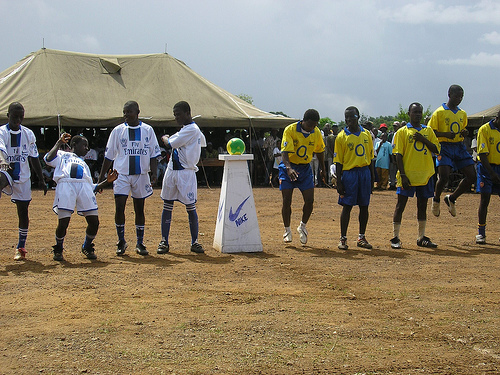

In [339]:
#traindataset
random_train_index =  np.random.randint(len(f.training_data))
train_filename = 'Flicker8k_Dataset/'+f.training_data[random_train_index]['filename']
print("Original caption: ",f.training_data[random_train_index]['sentences'][0]['raw'])
print("")
print("Greedy caption:", f.caption_image_greedy(net,train_filename))
print("")
print("Beam caption:")
f.print_beam_caption(net, train_filename)

IPython.display.Image(filename=train_filename) 


Original caption:  A green Volkswagen Bug and other vintage cars are admired by people in a courtyard .

Greedy caption: a group of people are standing in front of a truck

Beam caption:
a group of people in front of a city [ -8.800378501415253 ]
a group of people are sitting on the street [ -8.842676341533661 ]
a group of people in front of a busy [ -8.8475701212883 ]
a group of people are sitting in the street [ -8.943396270275116 ]
a group of people are gathered in the street [ -9.100977599620819 ]
a group of people are standing in the street [ -9.174256026744843 ]
a group of people are walking down the street [ -9.221777141094208 ]
a group of people in front of a building [ -9.239275634288788 ]
a group of people in front of a race [ -9.642388045787811 ]
a group of people in front of a street [ -9.791738212108612 ]


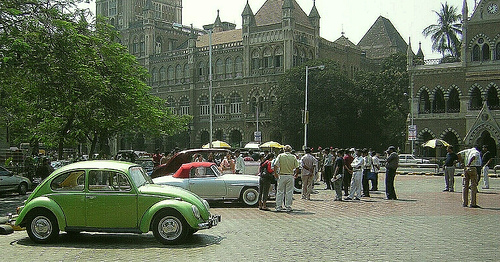

In [34]:

#test dataset
random_test_index = np.random.randint(len(f.test_data))
test_filename = IMAGE_DIR+f.test_data[random_test_index]['filename']
print("Original caption: ",f.test_data[random_test_index]['sentences'][0]['raw'])
print("")
print("Greedy caption:", f.caption_image_greedy(net,test_filename))
print("")
print("Beam caption:")
f.print_beam_caption(net, test_filename, 10)
IPython.display.Image(filename=test_filename) 


In [420]:
train_filename = 'my-images/phone.jpeg'
print("Greedy caption:", f.caption_image_greedy(net,train_filename))
print("")
print("Beam caption:")
f.print_beam_caption(net, train_filename, 3)
pil_im = Image.open(train_filename, 'r')
plt.figure()
plt.imshow(np.asarray(pil_im))
plt.show()

Greedy caption: a young boy is playing with a red toy

Beam caption:
a group of people are watching a game [ -9.680127739906311 ]
a group of people are watching a instruments [ -10.102285027503967 ]
a group of people in a red instruments [ -10.187032699584961 ]


FigureCanvasNbAgg()

## Train the network

In [35]:
l = torch.nn.CrossEntropyLoss(reduction='none')

In [36]:
o = optim.Adam(net.parameters(), lr=0.0001)

Epoch:  0 , index:  1029  loss:  3.999  | running avg loss:  3.0
Original caption: 
a man leads two cows down the dirt shoulder of a paved road .
a man walking his cow down the side of the road .
a man walks down the road leading a cow with no rider and another cow with a rider .
a man walks with a cow down a dirt sidewalk .
two men pull two cows down the road .

Greedy caption: a man is riding a horse on a dirt road

Beam caption:
a man in front of a [ -6.292452096939087 ]
a man is standing on a [ -7.2234721183776855 ]
a man wearing a horse on [ -7.342361688613892 ]


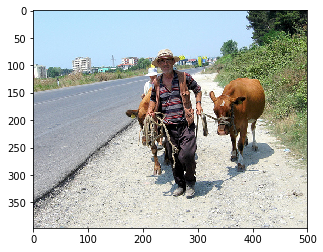

Epoch:  0 , index:  1295  loss:  3.008  | running avg loss:  2.992
Original caption: 
two athletic men climbing a waterfall .
two men are climbing a rock face at a waterfall .
two men climb up a waterfall using a rope while wearing shorts and hard hats .
two men hanging from ropes over a waterfall .
two men tethered by ropes climbing a hill where water is flowing .

Greedy caption: a man in a wetsuit is surfing

Beam caption:
a man is splashing in the [ -5.949769139289856 ]
a man is surfing in the [ -6.342067718505859 ]
a surfer is surfing in the [ -6.359756231307983 ]


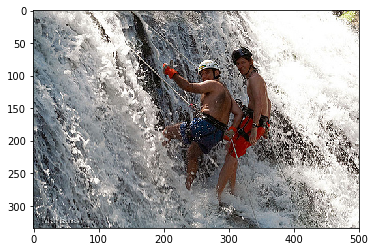

Epoch:  0 , index:  1663  loss:  3.55  | running avg loss:  2.99
Original caption: 
a dog chases another dog .
the white and brown dog is shaking its ears .
two dogs are playing in a fenced in area of gravel .
two dogs run in a gravel lot with a fence in the foreground .
two dogs walk over the gravel yard inside a gated area .

Greedy caption: a dog is running through the grass

Beam caption:
a black and a white dog are [ -6.75545060634613 ]
a black and a black dog are [ -7.249029040336609 ]
a black and a black and a [ -7.307608604431152 ]


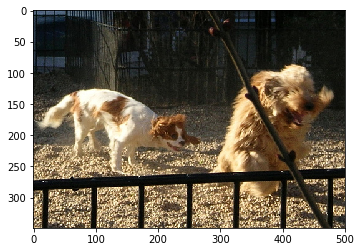

Epoch:  0 , index:  1672  loss:  3.188  | running avg loss:  2.992
Original caption: 
two hikers are climbing through a rocky and snowy passage in the mountains .
two mountain climbers walk through a pass with snowy mountains behind them .
two mountain-climbing hikers ascend a rocky path through patches of snow .
two people are climbing up a huge , snowy mountain .
two people are walking up a mountain .

Greedy caption: a man is climbing a cliff

Beam caption:
a hiker is sitting on a [ -6.131499946117401 ]
a man is sitting on a [ -6.274135768413544 ]
a man is standing on a [ -6.3012136816978455 ]


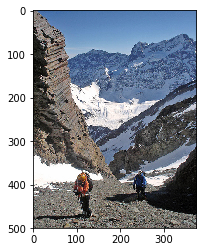

Epoch:  0 , index:  1904  loss:  1.092  | running avg loss:  2.989
Original caption: 
a boy in a swing .
a boy swings on a swing set .
a child at the height of a swing .
a young boy swinging on a swing .
a young boy swings in the air .

Greedy caption: a boy in a red shirt is swinging on a swing

Beam caption:
a boy are swinging on a swing [ -5.975644290447235 ]
a boy are swinging on a park [ -7.216874539852142 ]
a boy are swinging on the woods [ -7.440264821052551 ]


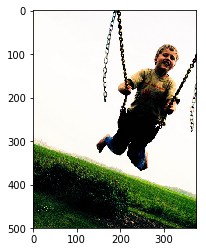

Epoch:  0 , index:  2035  loss:  3.309  | running avg loss:  2.994
Original caption: 
a boy on a bicycle in midair after going off of a wooden ramp .
a man jumping off a ramp in a bike
a person jumping their bike in the woods in front of trees with no leaves .
a person jumps a bicycle off a ramp in a barren forest .
a person on a bike is making a high jump along a trail in the woods .

Greedy caption: a man is climbing a rope

Beam caption:
a man is climbing up a rope [ -6.029198169708252 ]
a man is sitting on a rope [ -6.69191300868988 ]
a boy is climbing a rope to [ -8.015883088111877 ]


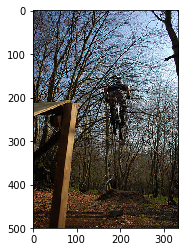

Epoch:  0 , index:  2465  loss:  3.16  | running avg loss:  3.005
Original caption: 
a child at a party swings a bat at a pinata , encouraged by a father .
a little boy in an orange collared shirt is swinging a baseball bat .
a little boy in a red shirt is swinging at a pinata .
a little boy in orange hit the pinata as a man stands behind him .
the small boy in an orange shirt gets some help from an adult while swinging at a pinata .

Greedy caption: a man in a red shirt and sunglasses is standing next to a woman in

Beam caption:
a group of people stand in a [ -7.4780213832855225 ]
a group of people are playing with [ -7.871245503425598 ]
a group of people stand in the [ -8.010454893112183 ]


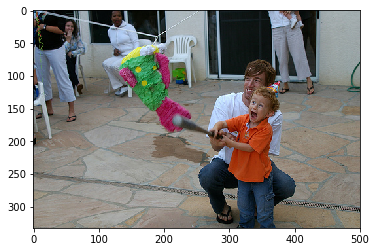

Epoch:  0 , index:  4128  loss:  2.409  | running avg loss:  3.003
Original caption: 
a person is riding a snowboard doing an air stunt over a snowy mound .
a snowboarder flies through the air .
a snowboarder in white soaring through the air .
a snowboarder is in the middle of a jump with one hand raised .
someone in white winter clothes is snowboarding through the air .

Greedy caption: a snowboarder is doing a trick on a ramp

Beam caption:
a person is skiing in the air [ -6.651110529899597 ]
a person is jumping in the air [ -6.992759704589844 ]
a person is doing a jump in [ -7.753745794296265 ]


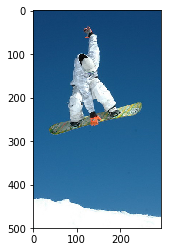

Epoch:  0 , index:  4504  loss:  1.852  | running avg loss:  3.006
Original caption: 
a brown and white dog is playing in a pool with a man .
a man and a dog are in a pool together .
a man and dog are splashing in a swimming pool .
a man is standing in the pool behind the dog that is swimming .
a small brown and white dog swimming through the pool next to a man .

Greedy caption: a boy in a blue shirt is swimming underwater

Beam caption:
a child is splashing in the water [ -6.492454767227173 ]
a girl is splashing in the water [ -6.6982200145721436 ]
a boy is splashing in the water [ -6.855494022369385 ]


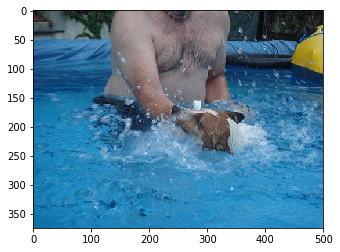

Epoch:  0 , index:  4729  loss:  2.958  | running avg loss:  3.013
Original caption: 
a man wearing a gray swimsuit stands in the water amidst white waves .
a surfer stands in a crashing wave .
a surfer surfs .
a young man in a swimsuit with water crashing behind him .
young man with black shorts jumping in the ocean waves .

Greedy caption: a surfer surfs a wave

Beam caption:
a surfer is getting ready to catch [ -6.951720952987671 ]
a young boy is surfing in the [ -7.732417106628418 ]
a surfer is getting ready to take [ -8.196096897125244 ]


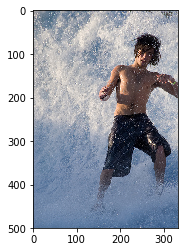

Epoch:  0 , index:  5434  loss:  3.527  | running avg loss:  3.016
Original caption: 
a girl with a star painted on her face smiles .
a lady in a sequined hat with red face paint .
a woman wearing a red hat and face paint smiles at another woman .
a woman with a painted face smiling .
the woman has her face painted with a red star and is drinking a beer .

Greedy caption: a man in a black shirt is holding a drink

Beam caption:
a group of young girls dressed in [ -8.865854322910309 ]
a group of young girls in front [ -8.973027765750885 ]
a man in black and white and [ -9.49687385559082 ]


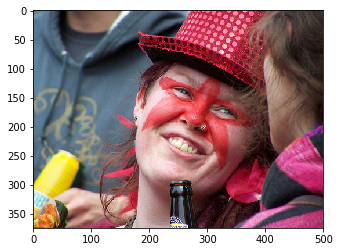

Epoch:  0 , index:  5990  loss:  4.794  | running avg loss:  3.015
Original caption: 
a soccer game at sunset
a soccer game being played as the sun sets .
green sports field with players beneath blue sky with pink clouds
people playing soccer on a soccer field during sunset
soccer players on a field from a distance .

Greedy caption: a man in a wetsuit is standing on a rock overlooking a lake

Beam caption:
a group of people are standing on a mountain road [ -10.354039371013641 ]
a group of people are standing on a stage with [ -10.41529393196106 ]
a group of people are sitting on a stage with [ -10.877217441797256 ]


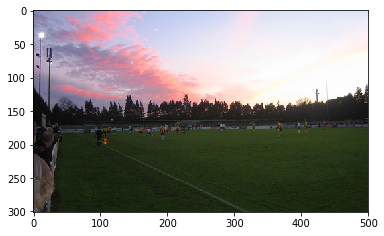




==== EPOCH DONE. === 



Epoch:  1 , index:  214  loss:  3.786  | running avg loss:  3.013
Original caption: 
a boy in swimming trunks is splashing in a swimming pool .
a boy jumps into the pool .
a boy splashes in a pool with his arms out to catch something .
a young boy jumping to catch something in a pool .
boy reaches up while in pool .

Greedy caption: a boy in a blue shirt is jumping into a pool

Beam caption:
a boy are playing in the water fountain [ -6.402464747428894 ]
a young boys are playing in a pool [ -6.8790364265441895 ]
a young boys are playing in a swimming [ -7.479257225990295 ]


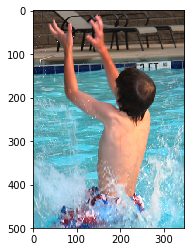

Epoch:  1 , index:  420  loss:  2.633  | running avg loss:  3.014
Original caption: 
a big tan wet dog in shallow water .
a brown dog gets wet in the water .
a brown dog walks through natural water .
a soaking wet dog walks across a stream .
a wet golden retriever is walking through a lake

Greedy caption: a brown dog is running through the water

Beam caption:
a brown dog is running on the water [ -5.613458812236786 ]
a brown dog is running through the water [ -5.796974539756775 ]
a black dog is running on the water [ -5.922320544719696 ]


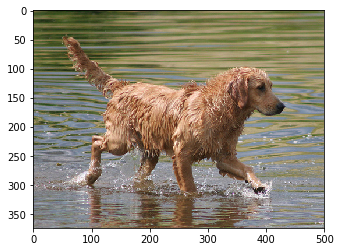

Epoch:  1 , index:  743  loss:  4.43  | running avg loss:  3.011
Original caption: 
a black and white dog jumps over a hurdle .
a black dog jumps over hurdles .
a black , white and brown tri-colored mid-sized dog jumps over a red and white jump in a field with tents and cars nearby .
a dog is jumping over a barrier at a agility competition .
a dog jumping over an obstacle course fence .

Greedy caption: a dog jumps over a hurdle

Beam caption:
a black dog is jumping over a [ -6.23434317111969 ]
a dog is jumping over the grass [ -6.448439836502075 ]
a dog is jumping over a hurdle [ -6.578124582767487 ]


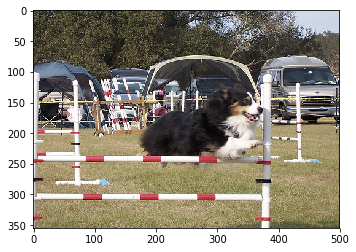

Epoch:  1 , index:  1053  loss:  2.217  | running avg loss:  3.007
Original caption: 
a corgi runs out of a tunnel .
a dog runs out of a tunnel on a course .
dog running out of tunnel on obstacle course
the dog is running out of the tunnel on a dog obedience course .
the small brown and white dog is running out of a small tunnel .

Greedy caption: a dog is jumping over a fence

Beam caption:
a dog is jumping over a field of [ -6.6386260986328125 ]
a dog is jumping over a grassy field [ -7.1366190910339355 ]
a dog is jumping over a grassy area [ -7.6972527503967285 ]


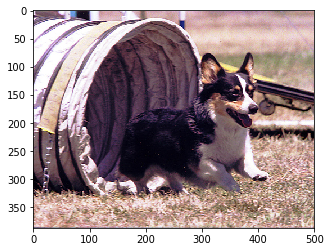

Epoch:  1 , index:  3243  loss:  3.92  | running avg loss:  2.991
Original caption: 
a man talks on his cellphone while he walks down the street .
a member of the clergy carries a blue bag in his hand and talks on the phone as he walks .
a priest carrying a small blue bag walking down the street talking on a cellphone .
priest in black walking on sidewalk carrying a blue bag and talking on cellphone .
priest walking with blue bag while talking on cellphone .

Greedy caption: a woman in a red jacket is walking down the street

Beam caption:
a group of the middle of a [ -6.452397108078003 ]
a man in the middle of a [ -6.973971724510193 ]
a group of the middle of the [ -7.072604417800903 ]


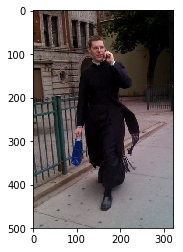

Epoch:  1 , index:  3638  loss:  2.226  | running avg loss:  2.995
Original caption: 
kids running across the grass .
three young boys are running on grass .
two boys , one wearing glasses , run across grass . third child partially in shot .
two young boys running on a grassy field
young boys running on grass .

Greedy caption: a boy in a blue shirt is running on a track

Beam caption:
a young boys playing in a [ -7.657093822956085 ]
a boy are playing in a [ -7.6650630831718445 ]
a young boys run in a [ -7.808532238006592 ]


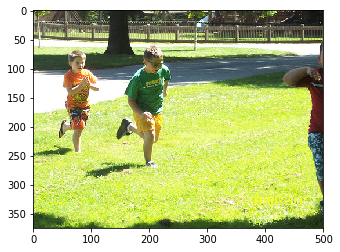

Epoch:  1 , index:  3726  loss:  2.426  | running avg loss:  2.994
Original caption: 
a bird flies across the water .
a white bird flies over a lake .
a white bird grazes above the water .
a white crane flies over water .
the magnificant bird flies low over the water .

Greedy caption: a bird flies through the water

Beam caption:
a bird off water [ -3.3973108530044556 ]
a white birds are [ -4.071455717086792 ]
a bird over water [ -4.634223937988281 ]


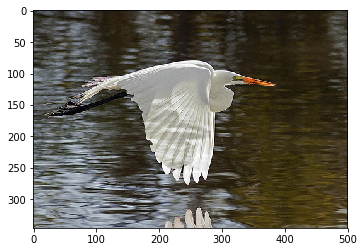

Epoch:  1 , index:  4273  loss:  3.251  | running avg loss:  2.991
Original caption: 
a white dog carries a bottle in its mouth through the snow .
a white dog carries a soda bottle on the snowy ground .
a white dog in the snow carries a plastic mountain dew bottle in its mouth .
a white dog runs through the snow with a mountain-dew bottle .
the white dog is drinking mountain dew in the snow .

Greedy caption: a dog runs through the snow

Beam caption:
a brown dog are running through [ -5.339123725891113 ]
a dog runs through the snow [ -5.357897698879242 ]
a brown dog play in the [ -5.579199373722076 ]


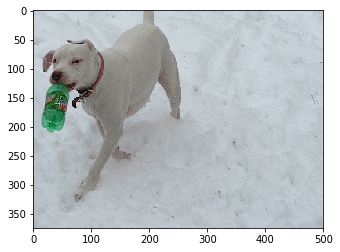

Epoch:  1 , index:  4393  loss:  3.468  | running avg loss:  2.991
Original caption: 
one person is tumbling on the ground next to another person with his shoes off .
two boys , one is climbing a roof , the other is bending down looking at the ground .
two children playing on rocks
two people climbing some sort of object in the distance
two young people at park .

Greedy caption: a man in a red shirt and a backpack is standing on a rock

Beam caption:
a man is sitting in front of a [ -7.06383740901947 ]
a man in the side of a rock [ -7.680904448032379 ]
a man is standing on a rock overlooking [ -8.467477917671204 ]


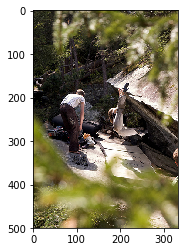

Epoch:  1 , index:  4783  loss:  1.858  | running avg loss:  2.987
Original caption: 
a man crouched in the bare branches of a fallen tree .
a man in a white shirt and khaki pants crouches on a fallen tree trunk .
a man in tan capris , brown sandals , and a white t-shirt , crouches on the trunk of a tree .
a man is crouched on top of a horizontal tree .
a man sitting in the middle of branches on a fallen tree .

Greedy caption: a man in a blue shirt is standing on a rock

Beam caption:
a man in a stick of water [ -8.371450424194336 ]
a man in a baby of water [ -8.627883076667786 ]
a man with a stick of water [ -8.631222248077393 ]


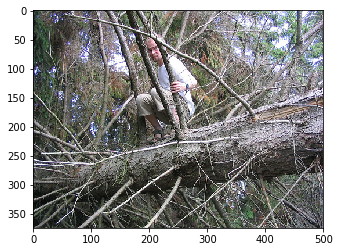

Epoch:  1 , index:  5058  loss:  2.045  | running avg loss:  2.983
Original caption: 
a biker makes a high jump .
a man doing an aerial stunt on a bike .
a man on a bicycle performing a jump .
a person on a bicycle wears a helmet and jumps , soaring over the ground in front of a skyline and lake .
the cyclist is making a high jump with his bike .

Greedy caption: a man is performing a trick on a bike

Beam caption:
a man is performing a trick on [ -6.560488224029541 ]
a man is performing a trick in [ -6.788608074188232 ]
a person is performing a trick on [ -7.300430774688721 ]


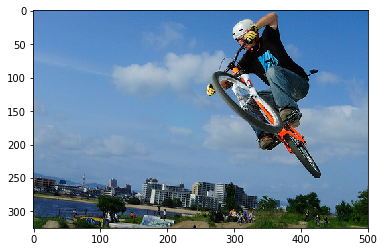

Epoch:  1 , index:  5094  loss:  1.563  | running avg loss:  2.983
Original caption: 
a black dog and a black and white dog are running in dirt .
a black dog and a black and white dog are running on sandy ground .
two dogs running on wet sand .
two dogs , one black , the other black and white runs on the beach .
two large dogs run in the sand .

Greedy caption: a black dog is running through the snow

Beam caption:
a dog are playing in [ -3.9937506914138794 ]
two dogs are playing in [ -4.2925543785095215 ]
a black dog are playing [ -4.321943402290344 ]


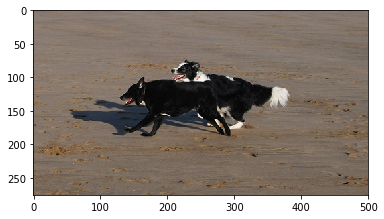

Epoch:  1 , index:  5476  loss:  4.241  | running avg loss:  2.98
Original caption: 
a man climbing an icy glacier with the assistance of a pick .
a man donning an orange helmet is climbing up a white glacier .
a man is chiseling into ice .
a mountain climber wearing an orange helmet swings his axe .
an ice climber wearing an orange helmet is hacking the ice with his ice pick .

Greedy caption: a man in a red jacket is snowboarding

Beam caption:
a man in the snow is snowboarding [ -6.774713695049286 ]
a man in the middle of a [ -6.918711245059967 ]
a snowboarder in the snow covered mountain [ -7.041717052459717 ]


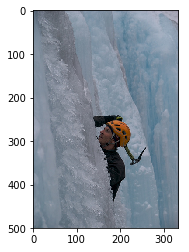




==== EPOCH DONE. === 



Epoch:  2 , index:  169  loss:  2.332  | running avg loss:  2.983
Original caption: 
a boy in yellow is riding a scooter on the street .
a boy on a scooter .
a boy wearing a helmet rides a scooter in a suburban neighborhood .
a child on a scooter is jumping the curb .
a young boy wearing an orange helmet riding a scooter

Greedy caption: a skateboarder jumps off a ramp

Beam caption:
a skateboarder in the trick on [ -5.331533670425415 ]
a man in the trick on [ -5.486438751220703 ]
a skateboarder in the trick in [ -5.612255811691284 ]


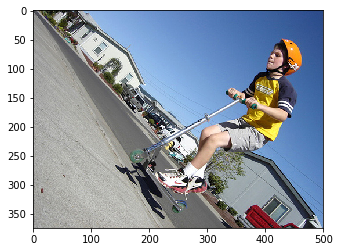

Epoch:  2 , index:  688  loss:  2.831  | running avg loss:  2.982
Original caption: 
a boy flipping off a skateboard going down a flight of stairs
a skateboarder leaps over stairs in a city .
boy jumping off skateboard as it goes down the stairs .
skateboarding on stairs , with open air trick .
the skateboarder does a jump down stairs .

Greedy caption: a man is skateboarding on a skateboard

Beam caption:
a man sits on a stone wall [ -8.550249218940735 ]
a man in a stone wall with [ -8.746665716171265 ]
a man in a stone wall near [ -8.999619722366333 ]


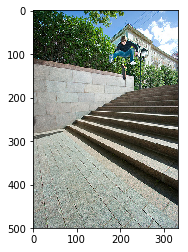

Epoch:  2 , index:  1715  loss:  4.745  | running avg loss:  2.977
Original caption: 
a martial artist kicks the face of his opponent .
martial artists are sparring against one another .
two black belts sparring , one kicking the other in the face .
two men wearing black belt martial arts uniforms are sparring , one of whom has kicked his feet up to the other man 's face .
two men with black belts engage in martial arts .

Greedy caption: a man in a white shirt is standing in front of a crowd

Beam caption:
a man in the ball on a game [ -7.580293536186218 ]
a man in the ball in a game [ -7.599528670310974 ]
a man in the ball on a basketball [ -7.76151168346405 ]


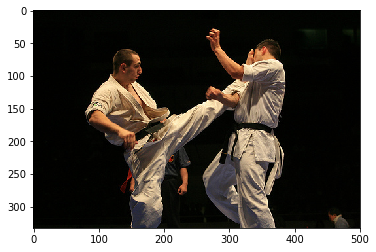

Epoch:  2 , index:  2376  loss:  3.039  | running avg loss:  2.977
Original caption: 
a child in a red and grey coat in front of a wooden shed .
a child 's shadow is shown behind him .
a little boy in a thick jacket stands with his hand high over his head .
the little boy in the red jacket is casting a shadow .
this boy is waving around his arms outside .

Greedy caption: a young boy in a red shirt and jeans is jumping on a trampoline

Beam caption:
a boy in a pink shirt is [ -7.057975947856903 ]
a girl in a pink shirt is [ -7.312111079692841 ]
a boy in a pink shirt and [ -7.712274253368378 ]


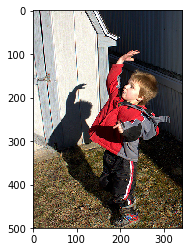

Epoch:  2 , index:  2393  loss:  2.258  | running avg loss:  2.977
Original caption: 
a man admires a rock formation on the water .
a man climbing a huge rock wall overlooking the blue ocean
a man kicks a large rock near the ocean .
a man stands by a boulder near an ocean .
a scuba diver stands on top of rocks after emerging from the water .

Greedy caption: a man is rock climbing

Beam caption:
a man is sitting on a rocky [ -5.916117250919342 ]
a man is sitting on the rocks [ -6.594473302364349 ]
a person is sitting on a rocky [ -6.633787930011749 ]


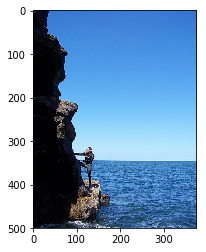

Epoch:  2 , index:  2808  loss:  4.443  | running avg loss:  2.975
Original caption: 
a few people standing around and a couple hugging .
a woman embraces a smiling man at a party .
a woman hugging a man at a formal occassion .
a woman hugs a man at an evening event .
person in black with brown hair hugging man in black pinstripe jacket in a room of other people .

Greedy caption: a man in a black shirt and a black shirt is sitting on a bench

Beam caption:
a group of people are sitting on [ -7.372175693511963 ]
a group of people are posing for [ -7.62224817276001 ]
a group of the middle of people [ -7.626378059387207 ]


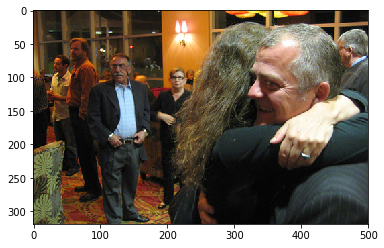

Epoch:  2 , index:  3333  loss:  3.763  | running avg loss:  2.972
Original caption: 
a girl in a white shirt poses and smiles as someone holds up a peace sign behind her .
a girl smiles while a boy makes a v sign behind her head .
girl smiling for camera with boy giving her bunny ears
smiling girl with white shirt with boy standing behind making rabbit ears behind her head .
the young girl is given rabbit ears by the young boy behind her .

Greedy caption: a woman in a blue shirt is smiling

Beam caption:
a man in the middle of [ -5.461519360542297 ]
a woman wearing sunglasses and white [ -7.098609626293182 ]
a man is wearing sunglasses and [ -7.334185719490051 ]


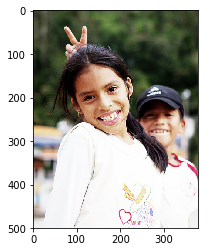

Epoch:  2 , index:  3834  loss:  2.813  | running avg loss:  2.971
Original caption: 
a man is throwing another around in a wrestling ring .
a wrestler is being held in the air by another man in the ring .
a wrestler is being lifted off the ground by another wrestler .
professional wrestler getting flipped by another .
two people are in a wrestling match .

Greedy caption: a woman in a blue and black outfit is playing with a volleyball

Beam caption:
a professional wrestler are playing in the [ -8.559555530548096 ]
a professional wrestler are playing in a [ -8.592587947845459 ]
a woman is wearing a game on [ -9.401101350784302 ]


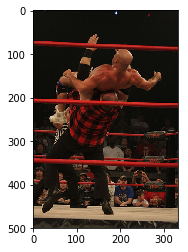

Epoch:  2 , index:  4637  loss:  1.351  | running avg loss:  2.972
Original caption: 
one black dog chases another on grass nearby a road that was recently snowed on .
two black dogs are playing in a grassy plain .
two black dogs chase each other on grass .
two black dogs running
two black dogs running on grass .

Greedy caption: a black dog is running through the grass

Beam caption:
a black dogs are playing in the ball [ -7.772349715232849 ]
a black dogs are running through the ball [ -7.9406737089157104 ]
a brown dogs are playing in the ball [ -8.09287416934967 ]


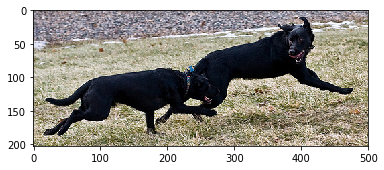

Epoch:  2 , index:  5198  loss:  2.615  | running avg loss:  2.972
Original caption: 
a young boy runs while wearing sandals .
little boy in a striped shirt and brown shorts is running .
the little boy , in a short sleeved shirt and shorts , is running outside .
the little boy is wearing a black pinstripe shirt and walking on a deck .
young boy running outside on the pavement .

Greedy caption: a young boy in a blue shirt is running on a wooden bench

Beam caption:
a little girls are playing in the grass path [ -10.479276180267334 ]
a young boys are playing in the grass path [ -10.593124866485596 ]
a little girls are playing in the grass covered [ -10.694976568222046 ]


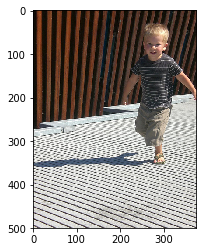

Epoch:  2 , index:  5285  loss:  1.579  | running avg loss:  2.972
Original caption: 
a group of men lift their arms to signal while they look to the left .
a group of young men watching something .
four young men wearing red ribbons on their wrists are making gestures
men with orange wristbands perform a dance .
several men in front of a white building .

Greedy caption: a woman in a white shirt is standing in front of a crowd

Beam caption:
a man is standing in the same dress [ -9.053646326065063 ]
a group of people standing in front of [ -9.098351895809174 ]
a group of people in a red dress [ -9.949650406837463 ]


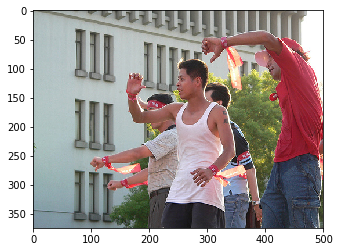

Epoch:  2 , index:  5295  loss:  1.667  | running avg loss:  2.972
Original caption: 
a closeup of a little girl on a swing .
a little girl in a dress with pink flowers swings on a red-seated swing .
a little girl in a pink and white flowered dress and blue sweater swinging .
a young girl is swinging in a backyard .
the little girl swings in the backyard .

Greedy caption: a young girl in a pink shirt is swinging on a swing

Beam caption:
a young girls are playing on a [ -5.923822641372681 ]
a young girls are playing in a [ -6.370782136917114 ]
a little girls are playing on a [ -6.6358864307403564 ]


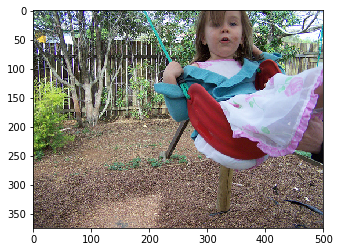

Epoch:  2 , index:  5395  loss:  6.654  | running avg loss:  2.972
Original caption: 
a person in a hoodie and red cap holding pizza and root beer advertisements .
a woman holding signs advertising food
a woman in a pink hooded sweatshirt carrying advertisement signs down a sidewalk .
a woman wearing a pink sweatshirt walks carrying signs .
the lady solicits her restaurants 's products on the street .

Greedy caption: a group of people are walking down a street

Beam caption:
a group of a man in [ -5.964033842086792 ]
a man in front of a [ -6.086200177669525 ]
a group of people in the [ -6.522425293922424 ]


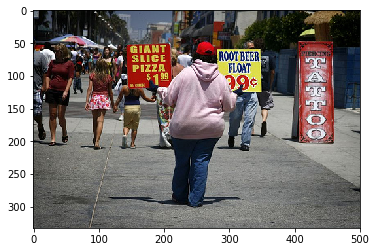

Epoch:  2 , index:  5567  loss:  2.581  | running avg loss:  2.972
Original caption: 
a man in a red shirt and glasses is bending down towards a small dog on a blanket with several stuffed animals .
a man in a red shirt is giving toys to a small dog .
a man is playing tug of war with his dog .
a man playing with a black dog on a white blanket .
a man playing with his dog on the blanket on the floor .

Greedy caption: a dog is playing with a stuffed animal

Beam caption:
a dog are playing with [ -4.097161531448364 ]
a dog are playing in [ -4.219877481460571 ]
a brown dog are playing [ -4.415327608585358 ]


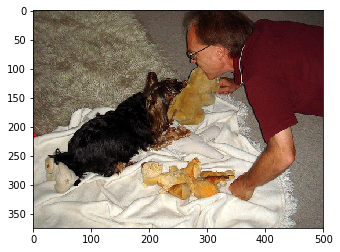

Epoch:  2 , index:  5700  loss:  2.016  | running avg loss:  2.973
Original caption: 
a man and a woman in a brown room posing for the camera .
a man in a striped shirt hugging a blond short-haired woman with a black apron on .
a man in a striped shirt poses with a blond girl in a black apron .
a man is standing next to a woman , with his arm around her waist .
a man with glasses is standing next to a woman with blonde hair .

Greedy caption: a woman and a woman are sitting on a bench

Beam caption:
a group of people are sitting in front of [ -9.17446318268776 ]
a group of children are sitting in front of [ -10.05301383137703 ]
a man is sitting on a couch with a [ -10.374242424964905 ]


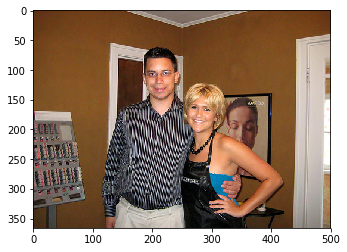




==== EPOCH DONE. === 



Epoch:  3 , index:  195  loss:  0.966  | running avg loss:  2.972
Original caption: 
a brown dog running through the water .
a wet dog is splashing through shallow water .
the wet brown dog is running in the water .
the white dog is running in the shallow water .
wet blonde dog running through water

Greedy caption: a dog is running through the water

Beam caption:
a black and a ball in [ -5.528572082519531 ]
a brown and a ball in [ -5.596970558166504 ]
a dog is playing in the [ -6.1060380935668945 ]


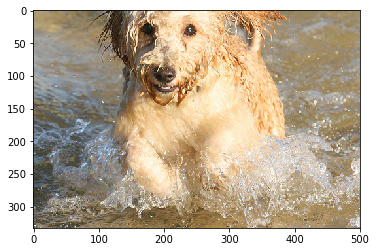

Epoch:  3 , index:  373  loss:  1.655  | running avg loss:  2.97
Original caption: 
a small child running on the beach
a young boy in swim trunks runs along a sandy beach .
a young boy runs through the water on a beach near trees .
a young child is running through a large puddle at a beach surrounded by trees .
young boy walking along the beach .

Greedy caption: a boy in a blue shirt is running on the beach

Beam caption:
a young boys play in the beach on [ -8.339464545249939 ]
a young boys playing in the beach on [ -8.409831643104553 ]
a young boys play in the ocean on [ -8.43307101726532 ]


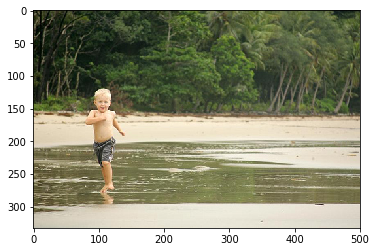

Epoch:  3 , index:  1928  loss:  6.991  | running avg loss:  2.963
Original caption: 
a man loses control of his watercraft .
a man parasails on the water .
a windsurfer falls off his boat in the ocean .
the man was sailing in the ocean and fell off his boat .
the sailboarder is falling in the water .

Greedy caption: a man in a yellow kayak is paddling through the water

Beam caption:
a person a man in the sun in [ -6.5629518032073975 ]
a person a person in the sun in [ -6.828205347061157 ]
a man is sitting on the sun in [ -7.377152681350708 ]


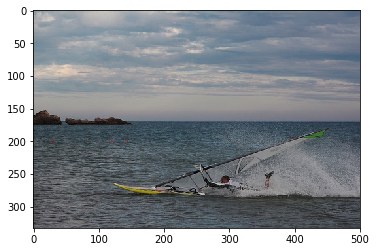

Epoch:  3 , index:  1964  loss:  1.329  | running avg loss:  2.962
Original caption: 
a climber wearing a white helmet is perched on the side of a rock face .
a lone climber wearing a white helmet climbing a wall .
a man wearing blue climbs a steep cliff .
the man in a blue shirt , wearing a helmet , is readying to climb .
the rock climber looks down from above .

Greedy caption: a man is rock climbing

Beam caption:
a man is jumping off a large [ -7.600180149078369 ]
a man is wearing a helmet and [ -7.763351202011108 ]
a man is climbing a rock face [ -7.788658618927002 ]


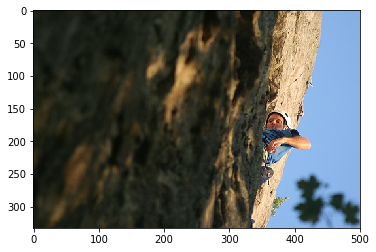

Epoch:  3 , index:  2353  loss:  2.404  | running avg loss:  2.962
Original caption: 
a man has his hands up while standing next to another man with a drink .
a young man stands in a crowd beside another young man holding a beverage can .
the man wearing the brown jacket is holding a cigarette and the man behind him is holding a can of beer .
two young men are at a party .
two young men are posing for the camera .

Greedy caption: a man and a woman in a black shirt

Beam caption:
a man in the black shirt and [ -6.948107481002808 ]
a man in a white shirt and [ -7.153212785720825 ]
a man in a black shirt and [ -7.19372832775116 ]


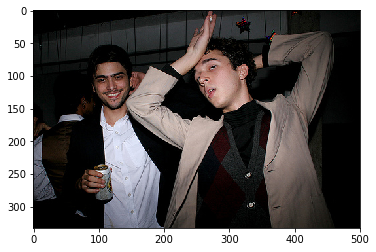

Epoch:  3 , index:  3488  loss:  2.109  | running avg loss:  2.962
Original caption: 
a group of people in a dim room .
a man and two women sit in a darkened room at a table with candles .
a man speaking with two women .
patrons share a drink at nightclub .
three people sit at table by red siren .

Greedy caption: a group of people are sitting on a couch

Beam caption:
a group of people are sitting [ -5.017566155642271 ]
a group of people are seated [ -6.072048854082823 ]
a group of people are standing [ -6.284963559359312 ]


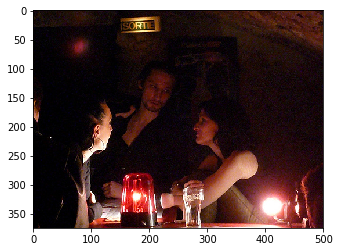

Epoch:  3 , index:  3807  loss:  2.538  | running avg loss:  2.961
Original caption: 
a brown dog chasing a frisbee , a barbeque in the background .
a brown dog is trying to catch a flying disk but missed it .
a dog is twisting in the air as it tries to catch a frisbee .
brown dog plays with frisbee .
the brown dog dives backwards to catch the football .

Greedy caption: a brown dog is running through the grass

Beam caption:
a dog is jumping over a [ -5.20793616771698 ]
a brown dog is jumping over [ -5.344283699989319 ]
a brown dog is chasing another [ -5.854509353637695 ]


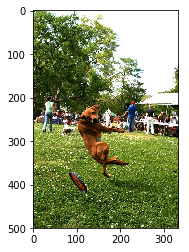

Epoch:  3 , index:  4044  loss:  3.553  | running avg loss:  2.96
Original caption: 
a girl straddles a bike rack on a city street .
a little girl in a blue outfit is climbing on metal railings in the street .
a little girl in navy blue is posing on a railing .
a little girl wearing a navy skirt is climbing on some silver poles .
a young girl in a blue skirt is propping herself up on bars of a metal structure outside .

Greedy caption: a girl in a pink shirt is playing with a hula hoops

Beam caption:
a little girl is playing with a park [ -8.606437385082245 ]
a young woman is playing with a park [ -8.7701935172081 ]
a little girl is playing in a park [ -8.999521374702454 ]


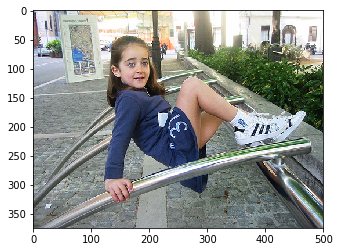

Epoch:  3 , index:  4062  loss:  4.344  | running avg loss:  2.96
Original caption: 
a closeup of a shirtless man rock climbing .
a man is climbing up a large rocky mountain .
a rock climber grasps a ledge with his chalk covered hand .
a young man climbing on a rock with no shirt on
there is an oriental man climbing up a mountain .

Greedy caption: a man is rock climbing

Beam caption:
a man is rock climbing up a rock [ -6.598759412765503 ]
a man is rock climbing a stone rock [ -7.547181963920593 ]
a group of people are sitting on a [ -7.7437437772750854 ]


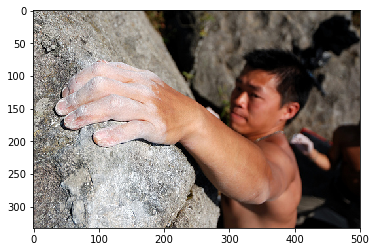

Epoch:  3 , index:  4137  loss:  2.776  | running avg loss:  2.96
Original caption: 
a girl has rested her bike by a bench so that she can eat and ice cream .
a girl is sitting on a bench eating ice cream with a bike next to her .
a girl with a hat is sitting outside on a table with a bike leaning against the table .
a little girl eats ice cream near her bike .
a young girl sits on a metal bench with her bike eating ice cream .

Greedy caption: a man in a red shirt and a helmet is riding a bicycle

Beam caption:
a man wearing a bicycle in the [ -7.175421953201294 ]
a man is riding a man in [ -7.343779802322388 ]
a man is riding a girl in [ -7.621748447418213 ]


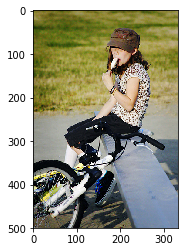

Epoch:  3 , index:  4160  loss:  5.663  | running avg loss:  2.96
Original caption: 
an asian man in a black tracksuit is watching students doing exercised on basketball court .
men training for ballet dancing in gym
people dancing in front of instructor
several people are participating in an athletics class .
various people on a basketball court .

Greedy caption: a young boy in a blue shirt is playing basketball

Beam caption:
a basketball player in the violin while another [ -9.240370035171509 ]
two men playing basketball while another man in [ -9.329507827758789 ]
two men playing basketball while another in a [ -9.365100860595703 ]


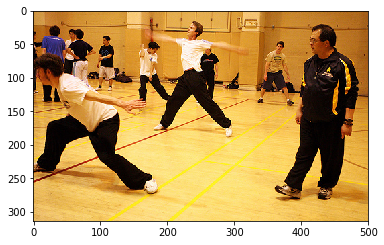

Epoch:  3 , index:  4180  loss:  2.182  | running avg loss:  2.96
Original caption: 
a girl sits on a rock wall while looking at her cellphone .
a woman sitting down checking her cellphone .
a woman with a backpack looks at her cellphone while sitting on a short concrete wall .
the young person reviews his photos while sitting on a bench .
woman sitting and looking at phone , with a black backpack .

Greedy caption: a man and woman sit on a bench

Beam caption:
a group of people sitting in front of a [ -8.207792520523071 ]
a group of people sit in front of a [ -8.522475481033325 ]
a group of children are sitting on the water [ -10.66196072101593 ]


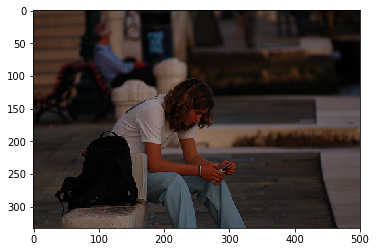

Epoch:  3 , index:  4210  loss:  4.426  | running avg loss:  2.961
Original caption: 
a group of college students walk in nice weather .
a group of people walk in the park , while some talk on phones .
a group of students are walking through the campus .
a group of young people walking with two talking on cellphones .
several young people walking casually around

Greedy caption: a man and woman are standing in front of a building

Beam caption:
a man is standing in front of store [ -8.00227802991867 ]
a man is standing in front of building [ -8.89294022321701 ]
a man is standing in front of waterfall [ -9.400489509105682 ]


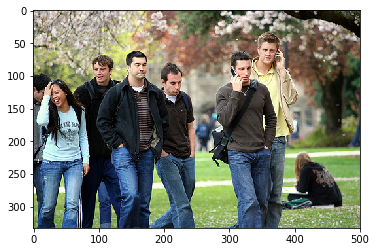

Epoch:  3 , index:  4499  loss:  2.059  | running avg loss:  2.958
Original caption: 
a brown dog chases the water from a sprinkler on a lawn .
a brown dog plays with the hose .
a brown dog running on a lawn near a garden hose
a dog is playing with a hose .
large brown dog running away from the sprinkler in the grass .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown two brown dog are [ -4.356993675231934 ]
a brown two dogs are playing [ -5.737124919891357 ]
a brown two dogs are standing [ -5.808108806610107 ]


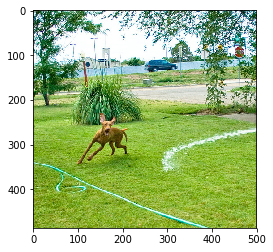

Epoch:  3 , index:  5021  loss:  3.294  | running avg loss:  2.957
Original caption: 
a boy lays on top of a girl in a field .
a girl and a boy in a park kissing in the grass on a sunny day
a young boy and girl cuddle in a grassy field .
person in black shirt lying on top of person in red shirt in the grass .
two people are laying down and kissing on a grassy lawn .

Greedy caption: a dog runs through a field

Beam caption:
a black and white dog in [ -6.087765455245972 ]
a black and a black and [ -6.119118928909302 ]
a black and black dog in [ -6.140828847885132 ]


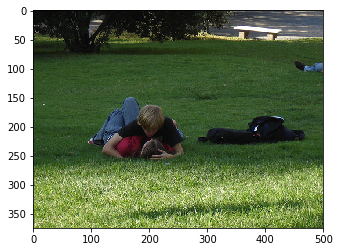

Epoch:  3 , index:  5959  loss:  3.028  | running avg loss:  2.953
Original caption: 
a man and a dog are sitting on the pavement are sitting by a wall .
a man and his husky sitting in the snow at the corner of a building .
a man is sitting in the snow with his dog asking for spare change .
a man sits outside in the snow with his dog and blue blanket .
person sitting in snow on a sidewalk holding small black dog and a husky laying beside him .

Greedy caption: a dog is running through the snow

Beam caption:
a white dogs are running through [ -6.455272793769836 ]
a white dogs play in the [ -6.4991679191589355 ]
a black dogs are running through [ -6.50190269947052 ]


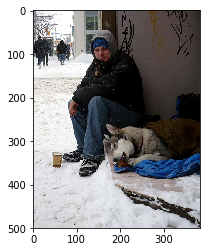




==== EPOCH DONE. === 



Epoch:  4 , index:  121  loss:  5.075  | running avg loss:  2.953
Original caption: 
a black and white bird eating seeds out of someone 's hand
a black and white bird standing on a hand .
a small bird sits in a person 's hand and eats seeds .
black and white bird standing on hand of someone holding sunflower seeds
the small bird is clinging to a finger of the hand holding the seeds .

Greedy caption: a white bird is running through the snow

Beam caption:
a black and a white dog [ -6.525285482406616 ]
a black and a white bird [ -6.798514127731323 ]
a black dogs are running across [ -7.354215979576111 ]


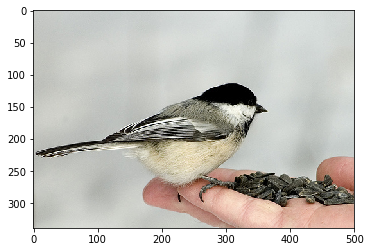

Epoch:  4 , index:  1155  loss:  2.352  | running avg loss:  2.949
Original caption: 
a man drinking juice on a sunny day .
a man drinking orange juice while walking .
a man drinking orange juice while walking on a sunny day .
a man drinks orange juice and walks outside .
a man in a suit is taking a sip of something while walking outdoors .

Greedy caption: a man in a red shirt is standing in front of a crowd of people

Beam caption:
a man walk down the street [ -6.525795042514801 ]
a man walking down the street [ -6.549466073513031 ]
a man walking through the street [ -6.656117498874664 ]


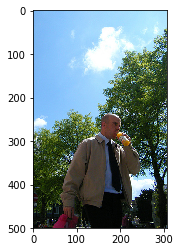

Epoch:  4 , index:  2542  loss:  2.542  | running avg loss:  2.943
Original caption: 
a crowd surrounds a grounded hot air balloon .
a group of people are firing up a hot air balloon .
a group of people climb into a hot air balloon .
a hot-air balloon getting filled .
people gathered around a hot air balloon in the process of inflating .

Greedy caption: a hot air balloon is flying in the air

Beam caption:
a group of people are watching [ -5.610518783330917 ]
a group of people are in [ -6.381257742643356 ]
a group of people are sitting [ -6.432114094495773 ]


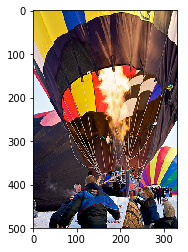

Epoch:  4 , index:  2814  loss:  3.766  | running avg loss:  2.944
Original caption: 
a woman dressed in a blue jacket and blue jeans rides a brown horse near a frozen lake and snow-covered mountain .
a woman in a blue jacket rides a brown pony near water .
a woman rides a horse near a frozen lake in the wintertime .
a young blond woman sitting atop a brown draft horse in the snowy mountains .
woman n blue jacket sits on daft horse near a frozen lake .

Greedy caption: a man is riding a horse on a beach

Beam caption:
a man is riding on a [ -5.822451591491699 ]
a dog is riding on a [ -5.97894287109375 ]
a man is riding a horse [ -6.21574592590332 ]


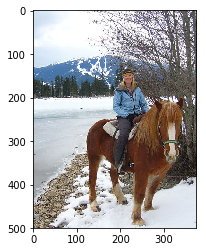

Epoch:  4 , index:  5542  loss:  2.766  | running avg loss:  2.938
Original caption: 
a man dressed like a rockstar poses in front of a brick wall .
a man with a heavy-metal hairstyle wearing a studded leather jacket and tight lace-up pants stands in front of a brick wall .
a man with a lot of jewelry and punk rock clothes poses against a brick wall .
a man with long blond hair and a lot of jewelry stands by a wall .
an older man with long blond hair wearing a rocker outfit

Greedy caption: a woman in a black jacket and a white skirt is standing in front of

Beam caption:
a man is smiling and white shirts [ -8.466929972171783 ]
a woman dressed up and white shirts [ -8.807834506034851 ]
a man in a red shirts and [ -9.220097422599792 ]


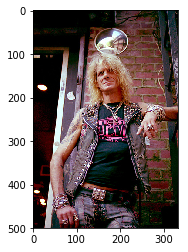




==== EPOCH DONE. === 



Epoch:  5 , index:  70  loss:  2.734  | running avg loss:  2.937
Original caption: 
a dark colored man is holding a protest banner in a busy city street with people staring from behind .
a man in a blue and yellow jacket holding a religious sign stands in a street with people behind him on the sidewalk .
a man is holding a religious poster .
a man wearing a hat holding a sign with writing on it .
man standing on the street holding a sign

Greedy caption: a man in a red shirt and a white cap is standing on a sidewalk

Beam caption:
a group of people are standing in a city street [ -9.906856834888458 ]
a group of people are walking down at a building [ -9.971027493476868 ]
a group of people are standing in a busy street [ -10.014017403125763 ]


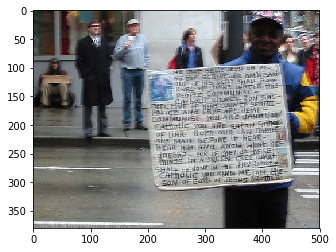

Epoch:  5 , index:  128  loss:  1.626  | running avg loss:  2.938
Original caption: 
a black dog has caught a bird in its mouth .
a black dog in tall grass with a bird in its mouth .
a black dog standing in a field is holding a bird in his mouth .
black retriever stands in the grass , holding a bird in its mouth .
the black dog in the field has something in its mouth .

Greedy caption: a black dog is running through the grass

Beam caption:
a black dog is running through the [ -5.345206260681152 ]
a black and a black dog are [ -5.840402126312256 ]
a black dog is running through a [ -5.982137203216553 ]


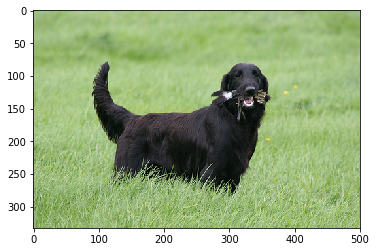

Epoch:  5 , index:  611  loss:  1.309  | running avg loss:  2.936
Original caption: 
a big black dog with fluffy fur runs in the surf of a rocky shore .
a black dog jumps through the water .
a black dog splashes in the water .
the black dog is in the water on the shore .
the black dog is running through the water .

Greedy caption: a black dog runs through the water

Beam caption:
a black dog running in the beach [ -4.79557991027832 ]
a dog is running in the beach [ -5.290632247924805 ]
a black dog running on the beach [ -5.377033710479736 ]


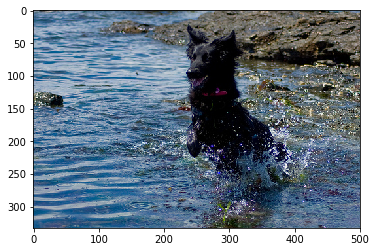

Epoch:  5 , index:  1172  loss:  3.98  | running avg loss:  2.935
Original caption: 
a dog zips along the beach .
a fuzzy white lap dog runs along a rocky beach .
a small white dog running on a pebble covered beach .
a white dog runs along a rocky shoreline .
fluffy white dog running on pebbles along the shore .

Greedy caption: a dog is running through the grass

Beam caption:
a black and a small dog [ -4.803815841674805 ]
a brown and a small dog [ -5.322545051574707 ]
a white and a small dog [ -5.451904058456421 ]


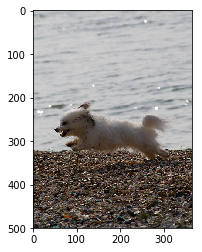

Epoch:  5 , index:  1242  loss:  3.998  | running avg loss:  2.935
Original caption: 
a baby girl wearing a pink jacket climbs wooden steps .
a small child climbs stairs at a beach .
a small child climbs steps outdoors in a grassy area .
a small child in a pink hoodie ascending tall stairs outdoors .
a small child in a pink sweater begins to climb a concrete staircase .

Greedy caption: a man in a red shirt is standing on a wooden bench

Beam caption:
a man in the middle of a park [ -9.400897979736328 ]
a man in the middle of a garden [ -9.55224609375 ]
a man in the middle of a puddle [ -9.651451349258423 ]


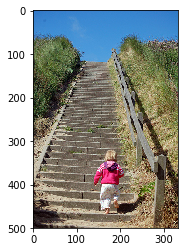

Epoch:  5 , index:  1371  loss:  4.628  | running avg loss:  2.934
Original caption: 
a man wearing a orange vest is canoeing in the blue water .
a person paddles a boat while another has fallen into the water .
one person kayaks as another kayer sinks their boat .
two kayakers ; one paddling and one in the water .
two small canoes are out in the middle of the water .

Greedy caption: a man in a yellow kayak with a paddle in his hand

Beam caption:
a man in a boat in a [ -7.42657470703125 ]
a man in a boat in the [ -7.55197286605835 ]
a person in the water boat in [ -8.117398858070374 ]


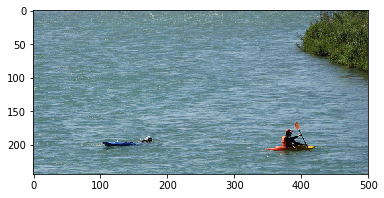

Epoch:  5 , index:  1529  loss:  3.762  | running avg loss:  2.934
Original caption: 
a group of women in matching uniforms , one of which is speaking .
a woman wearing a blue and white uniform with a white and blue hat on with her mouth open near others dressed the same .
a young woman with a white and blue hat and uniform yells to others dressed the same .
group of women in blue and white uniforms , in profile , facing offstage .
woman wearing a blue shirt with a white vest and a white cap talking while marching .

Greedy caption: a man in a black shirt and a black shirt is standing in front of

Beam caption:
a man in the two boys are [ -8.168184340000153 ]
a group of a man in a [ -8.43912935256958 ]
a man in the man in a [ -8.47059029340744 ]


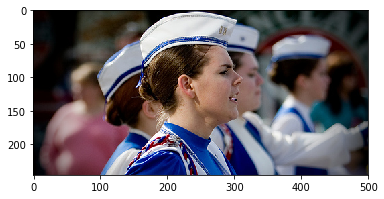

Epoch:  5 , index:  2897  loss:  0.914  | running avg loss:  2.932
Original caption: 
a brown and white dog fetching a toy .
a brown dog is carrying a toy in its mouth .
a dog running though a grassy field .
brown dog with objest in mouth moving toward camera .
the brown dog with the white chest is carrying a ball .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown dog is running through [ -5.238088130950928 ]
a brown dog is playing with [ -5.533824324607849 ]
a brown dog in the air [ -5.664789915084839 ]


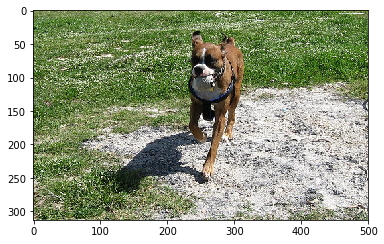

Epoch:  5 , index:  3135  loss:  4.657  | running avg loss:  2.931
Original caption: 
a colourfully dressed and painted woman working a hula hoop in a crowd .
a woman in purple pants is using a green hula hoop .
a woman wearing purple and green is spinning a green hula hoop around her waist .
a woman with jewels on her face wearing a green sports bra and purple pants is hula hooping in a crowd .
costumed girl playing with a hula-hoop in a crowd .

Greedy caption: a woman in a pink shirt is holding a bottle of water

Beam caption:
a group of people are playing in front of [ -10.601820051670074 ]
a group of people are standing in front of [ -10.737060010433197 ]
a group of people are playing in the beach [ -12.349898040294647 ]


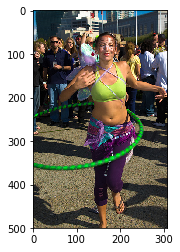

Epoch:  5 , index:  4606  loss:  2.811  | running avg loss:  2.927
Original caption: 
a man is carrying a surfboard along a stone wall that leads to the ocean .
man in green swim trunks carrying a surfboard along a rock wall to the ocean .
surfers walking along a seawall as the ocean churns around them .
two surfers carry their boards to the end of a walkway to join the others in the water .
two surfers walk along a rock wall to reach the waves .

Greedy caption: a man in a wetsuit is sitting on a beach

Beam caption:
a man is walking along a beach in [ -9.588409900665283 ]
a man is sitting on the beach in [ -9.59941816329956 ]
two people are playing in the beach in [ -9.643721342086792 ]


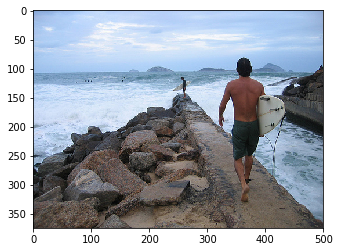

Epoch:  5 , index:  4768  loss:  4.531  | running avg loss:  2.927
Original caption: 
business women walk outside .
smartly dressed asian women are passing by a doorway in the street .
three women in business wear walk across a courtyard .
three women in dress suits walk by a building .
two women wearing dresses are walking by a building .

Greedy caption: a woman in a red dress and a white cap is walking down a street

Beam caption:
a group of people walk down a street [ -7.894044041633606 ]
a group of people walk down the street [ -8.802827775478363 ]
a woman walk down the street in a [ -8.916915223002434 ]


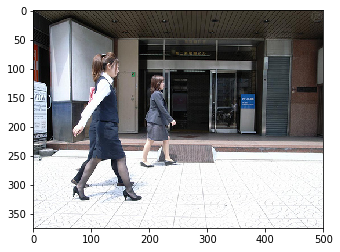

Epoch:  5 , index:  5137  loss:  1.842  | running avg loss:  2.926
Original caption: 
a black dog fetches a large stick out of the water .
a black dog is juming into the water and catches a stick in its mouth .
a black dog rears out of a pond , carrying a big stick in his mouth .
a black dog runs through the water carrying a stick .
dog fetching a stick in the lake .

Greedy caption: a black dog is running through the water

Beam caption:
a black dogs are running through [ -4.218890190124512 ]
a dog are running through the [ -4.662463665008545 ]
a black dogs running through the [ -4.687260389328003 ]


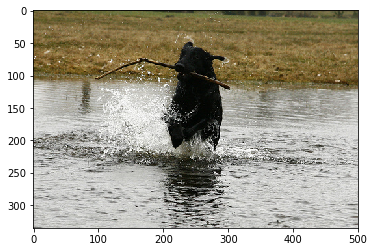

Epoch:  5 , index:  5668  loss:  1.644  | running avg loss:  2.926
Original caption: 
a blond person climbs a sheer rock cliff face .
a girl climbing a rock face .
a girl on the very top of a large rock wall climbing .
a person climbs a rock face .
a person is climbing to the top of a rock cliff .

Greedy caption: a dog is standing on a rock overlooking a forest

Beam caption:
a man is running through the water in a [ -10.39096999168396 ]
a brown dogs are jumping over a white dog [ -10.478218644857407 ]
a brown dogs are standing on a white dog [ -10.734268188476562 ]


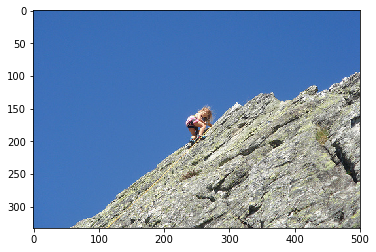




==== EPOCH DONE. === 



Epoch:  6 , index:  1905  loss:  1.842  | running avg loss:  2.921
Original caption: 
a dog wearing a cape is running through the snow .
a dog wearing a cover runs in the snow .
dog in jacket running through snow
dog running though the snow in a green cover .
dog wearing a coat running in a snowy field .

Greedy caption: a dog is running through the snow

Beam caption:
two dogs run through the [ -4.584949493408203 ]
two dogs play in the [ -4.761475026607513 ]
a black dogs are playing [ -4.833885669708252 ]


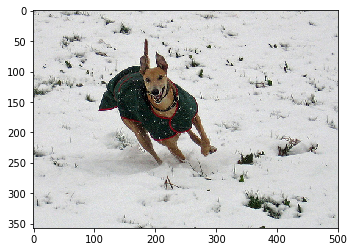

Epoch:  6 , index:  2991  loss:  3.365  | running avg loss:  2.92
Original caption: 
a man is laying down inside a black , non-working boat .
a man lays down to rest inside a wood structure against a building .
a man sleeping on a sheltered public bench .
a man sleeps in the lining of a boat that is propped against a brick wall .
man is lying down inside of a black structure outdoors .

Greedy caption: a man is sitting on a rock

Beam caption:
a group of people are sitting on a [ -8.600139141082764 ]
a group of people are sitting under a [ -9.543443083763123 ]
a group of people sitting on a rock [ -10.065165042877197 ]


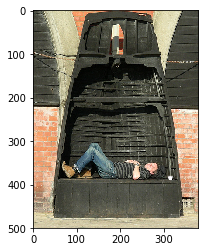

Epoch:  6 , index:  3300  loss:  3.528  | running avg loss:  2.92
Original caption: 
a child walking along side long legged birds .
a little boy and 4 turkeys walking
a small boy following 4 geese .
a small boy walks next to a group of four large birds .
a young boy walks down a road with four turkeys

Greedy caption: a man is sitting on a bench with a dog in his hand

Beam caption:
a man is wearing a bench with a [ -9.42438530921936 ]
a man is wearing a bench with his [ -9.569273710250854 ]
a man is wearing a bench in the [ -9.682545185089111 ]


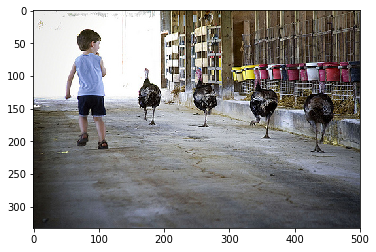

Epoch:  6 , index:  3377  loss:  4.073  | running avg loss:  2.919
Original caption: 
a girl sits outside at a large fountain .
a woman and two others are sitting nearby a decorative water fountain .
a woman sits on a wall next to a large conical fountain .
a young woman sits near a fountain .
woman in black poses near a pyramid fountain .

Greedy caption: a man is rock climbing

Beam caption:
a man in the side of a [ -6.491229236125946 ]
a man is climbing a rock formation [ -7.020805239677429 ]
a man is climbing on a rock [ -7.734217166900635 ]


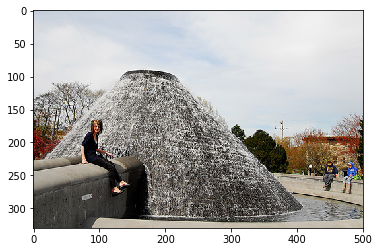

Epoch:  6 , index:  3423  loss:  2.562  | running avg loss:  2.92
Original caption: 
motorcyclists near the beach .
there are two motorcycles with a man and a woman on it .
two guys with helmets are on motorcycles , each with a woman riding behind him
two motorcycles and four riders are on the road .
two motorcycles with two riders each .

Greedy caption: a man in a red helmet and helmet is riding a motorcycle on a dirt

Beam caption:
a group of people are racing [ -5.907163619995117 ]
a group of people are riding [ -6.116275787353516 ]
a group of people in the [ -6.394412517547607 ]


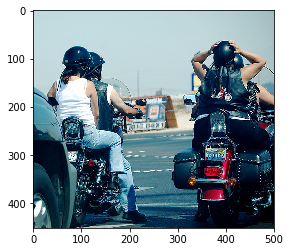

Epoch:  6 , index:  4211  loss:  2.597  | running avg loss:  2.919
Original caption: 
three elderly women , two with canes , walk through a parking lot .
three elderly women walking from behind .
three elderly women walking together .
three elderly women wearing coats and carrying purses are walking with their back to the camera .
three old ladies walking and carrying purses

Greedy caption: a man in a black shirt is standing in front of a brick wall

Beam caption:
a man in a man in front of a [ -9.288144320249557 ]
a group of people stand in front of a [ -9.288513869047165 ]
a man in a man in front of the [ -10.38703653216362 ]


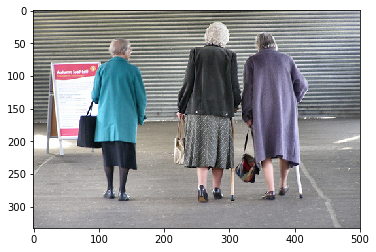

Epoch:  6 , index:  4663  loss:  1.69  | running avg loss:  2.917
Original caption: 
a man in a blue helmet and sunglasses bikes through wooded terrain
a man in a blue helmet rides a mountain bike .
a man rides his bicycle through some grass in a wooded area .
a man with a blue helmet and a yellow and black jacket is riding a bike in the woods .
a mountain biker riding through the woods .

Greedy caption: a man on a bike is riding a bike on a dirt road

Beam caption:
a man is doing a wooded area [ -6.8727216720581055 ]
a man is being ridden in the [ -7.182406902313232 ]
a man is being ridden in front [ -8.142117500305176 ]


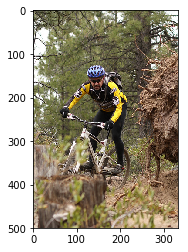

Epoch:  6 , index:  4790  loss:  3.382  | running avg loss:  2.917
Original caption: 
a brown dog is on top of a triangular structure .
a brown dog is running down a slope while a man follows beside him .
a brown lab dog runs over an obstacle on a course .
brown dog runs down ramp .
the large , dark colored dog is doing a climbing stunt outdoors , while a man watches .

Greedy caption: a brown dog is jumping into the water

Beam caption:
a brown and a brown dog are playing in [ -7.069842219352722 ]
a brown and a brown dog are fighting in [ -7.46654212474823 ]
a brown dog is jumping over a grassy yard [ -7.652454495429993 ]


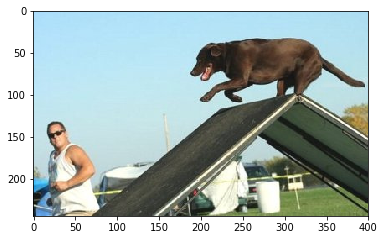

Epoch:  6 , index:  5171  loss:  1.53  | running avg loss:  2.917
Original caption: 
a group of people at a distance on a beach .
a man , woman , and two girls walk on the beach barefoot .
four people are walking on a beach .
people walking in the water along the beach .
this family is walking on the beach .

Greedy caption: a man is running on the beach

Beam caption:
a man is running along a beach on [ -8.25674295425415 ]
a group of people stand on the beach [ -8.27299165725708 ]
a man is running along the beach on [ -8.349750280380249 ]


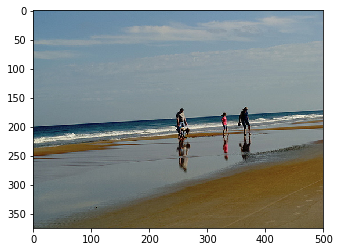

Epoch:  6 , index:  5679  loss:  3.455  | running avg loss:  2.916
Original caption: 
a beagle dog is walking on the shoreline at the beach .
a beagle walking on the beach next to some waves .
a beagle walks along the calm shore .
the beagle is on a beach walking along the shoreline
the beagle is walking on the beach at the waterline .

Greedy caption: a dog swims through the water

Beam caption:
a black dogs are playing in [ -5.04284930229187 ]
a dog swimming in the water [ -5.516951560974121 ]
a black dogs play in the [ -5.569807052612305 ]


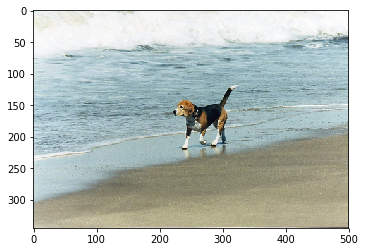




==== EPOCH DONE. === 



Epoch:  7 , index:  14  loss:  3.684  | running avg loss:  2.915
Original caption: 
a little old lady sitting next to an advertisement .
an asian woman waiting at an underground train stop .
an old woman sits in a transit station next to a backlit advertisement .
a woman sits in a subway station .
a woman with an umbrella is sitting at a station , with an aquos commercial on the wall .

Greedy caption: a group of people are standing in front of a large building

Beam caption:
a group of people in front of [ -7.20993185043335 ]
a group of people are in front [ -7.512681722640991 ]
a group of people are standing in [ -7.594573020935059 ]


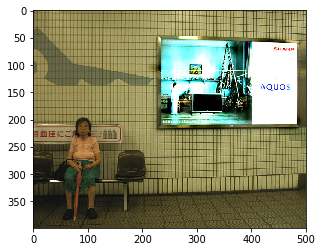

Epoch:  7 , index:  810  loss:  1.73  | running avg loss:  2.913
Original caption: 
a man holding girl at top of a slide
a man in a black shirt is holding a child wearing sunglasses .
a man in sunglasses is holding a child at the top of a slide
a man with sunglasses is helping a child with sunglasses slide down a slide .
a person helping a small baby down a blue slide

Greedy caption: a little girl in a red shirt is sitting on a bed

Beam caption:
a boy are sitting on a [ -5.7359490394592285 ]
a child is sitting on a [ -5.761628150939941 ]
a woman is sitting on a [ -5.813192129135132 ]


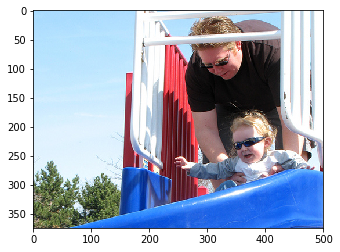

Epoch:  7 , index:  886  loss:  2.051  | running avg loss:  2.913
Original caption: 
a blond gear with a pink shirt is blowing on a dandelion .
a girl blows on a dandelion .
a young girl blowing on a dandelion puff .
a young girl is blowing on a dandelion .
a young girl is preparing to blow on a dandelion in her hand .

Greedy caption: a young girl wearing a pink shirt is playing with a toy

Beam caption:
a girl in a striped shirt is [ -8.89809000492096 ]
a woman in a striped shirt is [ -9.136404395103455 ]
a girl in a blue shirt is [ -9.48230230808258 ]


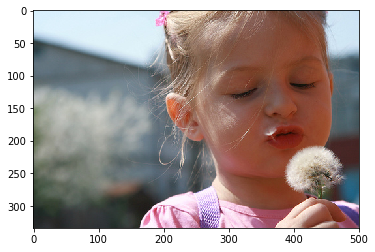

Epoch:  7 , index:  1375  loss:  2.098  | running avg loss:  2.912
Original caption: 
a baby in a life jacket on a raft .
a baby is wearing an adult life jacket whilst sitting in a dinghy inside the house .
a happy baby wears an orange life vest .
a young kid wearing a life jacket
the toddler sits in the boat with a life jacket on indoors .

Greedy caption: a little girl in a pink shirt is eating a piece of bread

Beam caption:
a little girl in the guitar on a bed [ -10.116235971450806 ]
a little girl in the guitar on the bed [ -10.360493659973145 ]
a little girl in the guitar on the floor [ -10.567922115325928 ]


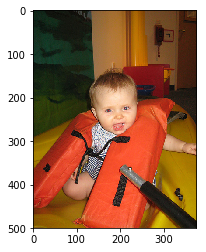

Epoch:  7 , index:  2720  loss:  4.166  | running avg loss:  2.91
Original caption: 
a burst of fire emerges from an experimenter in a darkened backyard .
a man breathes fire .
a man breathing fire , obscured by a fence .
a night photo of a person making a fireball .
two houses and fire

Greedy caption: a man in a red shirt and a red shirt is sitting on a bench

Beam caption:
a group of people stand in front of [ -7.726178348064423 ]
a man is sitting in front of a [ -8.020984768867493 ]
a woman in a woman are sitting on [ -9.043526709079742 ]


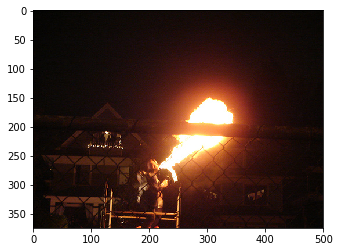

Epoch:  7 , index:  3741  loss:  2.847  | running avg loss:  2.908
Original caption: 
a brown dog is jumping up at a black and white dog .
a chow jumps on a huskey .
a smaller orange dog putting its head on a larger black and white dog
two dogs are playing around in the dirt .
two dogs play in a large fenced-in area , while two men watch from a distance .

Greedy caption: a brown and white dog is running through the snow

Beam caption:
two dogs play in the snow [ -5.168428421020508 ]
a brown dogs are playing in [ -5.740706562995911 ]
a brown dogs are running through [ -5.7465702295303345 ]


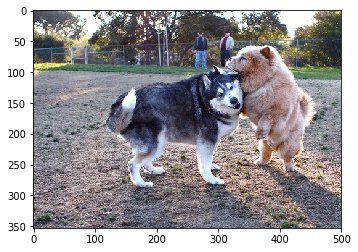

Epoch:  7 , index:  3945  loss:  2.206  | running avg loss:  2.908
Original caption: 
two dogs play tug-of-war with a dark object in the snow .
two poodles playing tug-o-war
two white poodles fighting over something in their mouths in the snow
two white standard poodles playing tug of war in the snow .
two white standard poodles play with a toy in the snow

Greedy caption: a black and white dog is running through the snow

Beam caption:
a black and a black dog are [ -4.8580238819122314 ]
a black and a white dog are [ -5.00567889213562 ]
a black and a black dog playing [ -5.900287628173828 ]


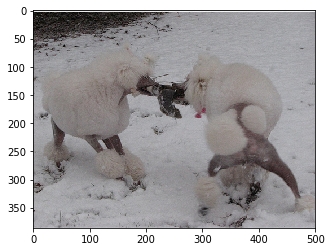

Epoch:  7 , index:  4166  loss:  4.315  | running avg loss:  2.907
Original caption: 
a hiker is walking up the mountain on a snow-covered road .
a man in black carrying an orange backpack stands next to a red backpack that is laying in the snow .
a man stands at dusk on an almost-pristine , snowy road , lit only by headlights .
a person stands in the snow at the edge of a mountain .
a traveler on a snowy road

Greedy caption: a snowboarder in a red jacket is jumping over a snow covered hill

Beam caption:
a snowboarder is standing on a wooded area [ -7.037037372589111 ]
a snowboarder is standing on a snowy area [ -7.127556324005127 ]
a snowboarder is standing in the snow with [ -8.631482124328613 ]


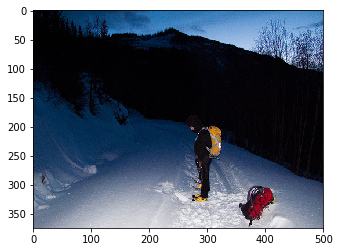

Epoch:  7 , index:  4279  loss:  1.394  | running avg loss:  2.907
Original caption: 
a black and white dog jumping in the air to get a toy .
a black and white dog jumps up towards a yellow toy .
a dog leaps to catch a ball in a field .
a white dog is trying to catch a ball in midair over a grassy field .
the white dog is playing in a green field with a yellow toy .

Greedy caption: a dog runs through the grass

Beam caption:
a black and white dog is running through [ -6.983487606048584 ]
a black and white dog running through the [ -7.058139801025391 ]
a black and white dog running in the [ -7.272478342056274 ]


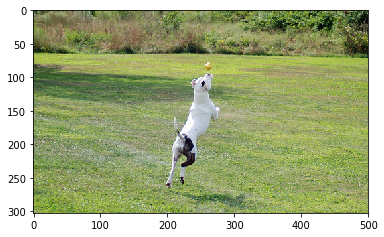

Epoch:  7 , index:  4648  loss:  3.587  | running avg loss:  2.906
Original caption: 
a woman is running along the side of a road , casting her shadow on a concrete wall .
a woman jogs beside a tall concrete wall .
a woman runs beside a concrete wall .
woman jogging beside the road .
woman running on sidewalk

Greedy caption: a man in a red shirt and jeans is standing on a sidewalk

Beam caption:
a group of people are standing on a [ -8.337912321090698 ]
a group of people are standing on the [ -9.651127219200134 ]
a man is standing on a street near [ -10.239348530769348 ]


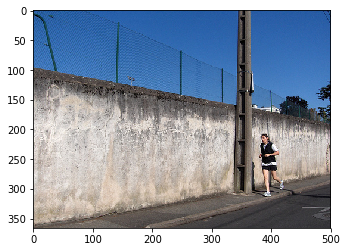

Epoch:  7 , index:  4689  loss:  2.045  | running avg loss:  2.906
Original caption: 
a black and brown dog is biting on a stick in the forest .
a brown dog chewing on a large piece of wood .
a brown dog is chewing on a stick .
a dark brown dog is chewing on a stick .
the brown dog is playing with a stick .

Greedy caption: a dog runs through the grass

Beam caption:
a black dog chases another dog [ -4.1544036865234375 ]
a black and a brown dog [ -4.752063751220703 ]
a brown dog chases another dog [ -5.169581413269043 ]


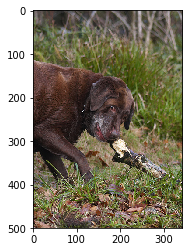

Epoch:  7 , index:  5385  loss:  2.882  | running avg loss:  2.905
Original caption: 
a group of horseback riders travel down a dirt path .
a group of people are riding horses on a wooded trail .
group of horse riders travel through the woods .
horseback riders file down a wooded path .
several people are riding horses on a wooded trail .

Greedy caption: a group of people are riding horses

Beam caption:
a group of people riding horses in front of [ -9.187038540840149 ]
a group of a man are sitting on the [ -9.70476484298706 ]
a group of a man are sitting on a [ -10.133501529693604 ]


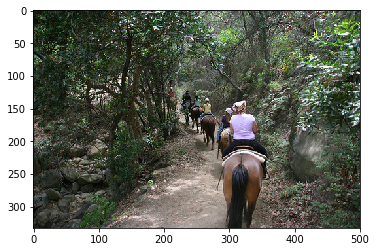

Epoch:  7 , index:  5421  loss:  1.99  | running avg loss:  2.905
Original caption: 
two dogs are walking on a rugged path , one with a blue rope tied to a red object in its mouth .
two dogs play in a grassy area with a red and blue toy .
two dogs playing keep-away with red toy on blue string .
two dogs play with a red plastic toy in the tall grass .
two dogs walking through nature .

Greedy caption: a dog runs through the grass

Beam caption:
a brown and a black dogs [ -5.711528301239014 ]
a brown and two other dogs [ -6.9615490436553955 ]
a dog is running on the [ -7.011246681213379 ]


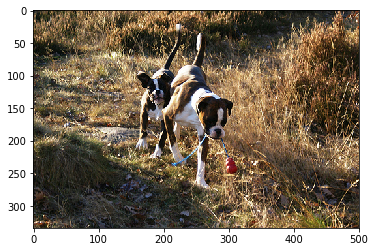

Epoch:  7 , index:  5971  loss:  2.261  | running avg loss:  2.905
Original caption: 
a black and tan dog plays with a stuffed toy .
a black dog plays with a white and blue colored stuffed animal .
a doberman jumping in the air playing with a toy
a dog playing with its toy .
black dog playing with a white and blue toy .

Greedy caption: a dog is running through the snow

Beam caption:
a black dogs are playing [ -4.634284019470215 ]
a black dogs play in [ -4.7715259194374084 ]
a black dogs run through [ -5.041183948516846 ]


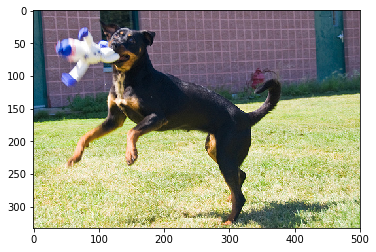




==== EPOCH DONE. === 



Epoch:  8 , index:  439  loss:  4.807  | running avg loss:  2.904
Original caption: 
a group of elephants are being ridden by men .
five men dressed in white ride on elephants that are painted with bright colors .
five men wearing turbans are riding on elephants a far eastern city street .
four men wearing turbans wait to give elephant rides to people .
several men riding elephants through the street .

Greedy caption: a crowd of people are riding horses in a crowd

Beam caption:
a group of people in front of [ -6.7939629554748535 ]
a group of people are riding a [ -6.838764667510986 ]
a group of people sit on a [ -6.981020450592041 ]


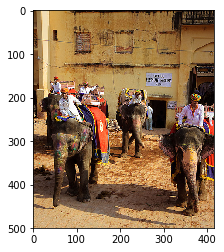

Epoch:  8 , index:  949  loss:  2.705  | running avg loss:  2.903
Original caption: 
a female in blue jeans sitting with luggage against a wall
a girl sits against a white wall with her belongings beside her .
a woman sits against a wall in a fancy building .
a woman with blond hair is sitting in a room or hallway with her luggage .
a young blond woman rests next to some luggage .

Greedy caption: a woman in a pink shirt is sitting on a bench

Beam caption:
a young girls are sitting in front of a [ -9.392566919326782 ]
a group of people are playing in front of [ -9.930506825447083 ]
a young girls are sitting in front of some [ -10.94967770576477 ]


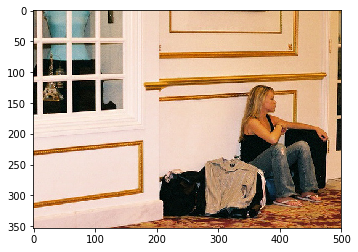

Epoch:  8 , index:  1258  loss:  2.724  | running avg loss:  2.902
Original caption: 
a closeup of two women standing together .
a woman wearing purple looks away while a woman in orange grins at the camera .
one girl wearing an orange tank top and black sunglasses smiling at the camera next to another girl .
the woman is wearing a purple shirt and red sunglasses while her friend wears an orange shirt .
two women stand wearing sunglasses .

Greedy caption: a woman in a pink shirt and sunglasses is standing next to a man who

Beam caption:
a woman in a pink and white shirt is [ -9.761138916015625 ]
a girl in a pink and white shirt is [ -9.869847774505615 ]
a woman wearing a pink is taking a picture [ -10.02790379524231 ]


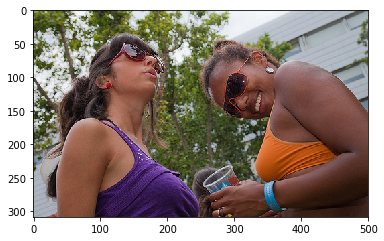

Epoch:  8 , index:  1545  loss:  1.689  | running avg loss:  2.901
Original caption: 
a dog runs through the forest with something in its mouth .
a dog runs while holding an object in its mouth .
a yellow dog running through a grassy area carrying something small in its mouth .
a young puppy with a red collar running with a leaf in its mouth .
the dog is carrying a toy through the grass .

Greedy caption: a dog is running through a field

Beam caption:
a black dogs run through the grass [ -6.370686054229736 ]
a black dogs run through a field [ -6.408082008361816 ]
a black dogs play in the grass [ -6.582765102386475 ]


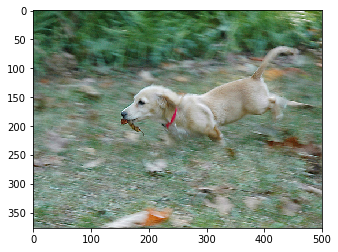

Epoch:  8 , index:  1923  loss:  1.793  | running avg loss:  2.901
Original caption: 
a black and white dog frolics in the snow .
a black and white dog is climbing stairs in the snow .
a black and white dog walks in the snow .
a brown and white dog is walking up snowy steps .
a dog walks on rocks covered by snow

Greedy caption: a dog is running through the snow

Beam caption:
a black dogs are running [ -5.139339208602905 ]
a black dogs are playing [ -5.177592039108276 ]
two dogs are playing in [ -5.264032185077667 ]


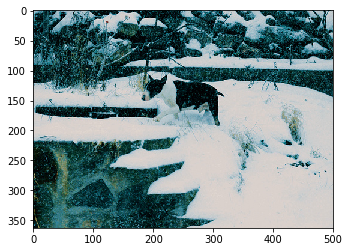

Epoch:  8 , index:  3190  loss:  2.556  | running avg loss:  2.899
Original caption: 
a baby boy plays outside with a blue toy .
a baby carrying a ball in stands in front of a house with a hose in the background .
a little boy is holding a blue ball in the yard .
a male child holding a ball standing on the sidewalk .
a young boy playing with a blue ball standing on a sidewalk

Greedy caption: a child in a blue shirt is playing with a toy

Beam caption:
a boy is playing with a game on [ -8.880261659622192 ]
a child is playing with a game on [ -9.09432315826416 ]
a little boy is playing with a small [ -9.33239459991455 ]


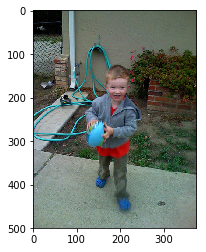

Epoch:  8 , index:  3428  loss:  1.436  | running avg loss:  2.899
Original caption: 
a brown dog is running in the grass between obstacles on a course
a dog runs through the grass .
a light brown dog running through an obstacle course .
a red furred dog runs on an obstacle course .
a small dog plays in the grass .

Greedy caption: a dog is jumping over a hurdle

Beam caption:
a black dog is playing with a red toy [ -10.247448742389679 ]
a black dog is playing with a pink toy [ -10.25598669052124 ]
a black dog is playing with a black dog [ -10.321905016899109 ]


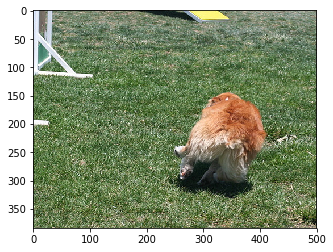

Epoch:  8 , index:  3804  loss:  4.218  | running avg loss:  2.898
Original caption: 
a man cleaning the inside of a large pane of glass .
a man holds up a blue cloth and smiles .
a man is holding up a plastic jug indoors .
a man smiles while he washes windows .
the man is wearing a black shirt and holding up a blue item in a window .

Greedy caption: a man in a black shirt is standing in front of a building

Beam caption:
a man in the boy are [ -5.939231872558594 ]
a man in the man are [ -6.051427364349365 ]
a man in the girl are [ -6.1651105880737305 ]


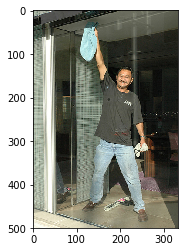

Epoch:  8 , index:  4787  loss:  3.734  | running avg loss:  2.897
Original caption: 
a woman is walking in front of a fast-food restaurant .
a woman walking down the sidewalk beside a cheeseburger advertisement .
a woman walking near a fast food restaurant .
a woman wearing a white jacket walks past a billboard that is advertising hamburgers .
a woman with a white jacket and black pants is walking down the sidewalk in front of a banner advertising hamburgers .

Greedy caption: a man in a red shirt and jeans is walking past a building

Beam caption:
a group of people in front of a street [ -8.852200776338577 ]
a group of people are standing on a street [ -8.966968417167664 ]
a group of people are sitting on a street [ -9.43770968914032 ]


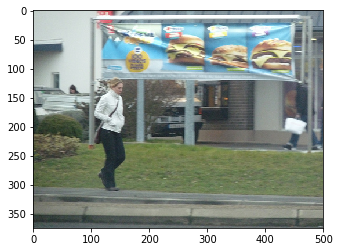

Epoch:  8 , index:  4868  loss:  2.991  | running avg loss:  2.897
Original caption: 
a child with a yellow cup and milk all over his face .
a little boy drinks milk and gets milk all over his face and table .
a little boy spilled his milk from the green cup .
small laughing child with blond hair sitting at a table holding a green sippy cup .
toddler with milk around his mouth .

Greedy caption: a young boy in a red shirt and blue jeans is sitting on a couch

Beam caption:
a young boy is sitting on his tongue out [ -11.05164349079132 ]
a little girl in the air with his tongue [ -11.338262796401978 ]
a young boy is sitting on the snow covered [ -11.731135964393616 ]


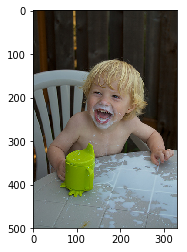

Epoch:  8 , index:  5348  loss:  3.748  | running avg loss:  2.897
Original caption: 
two people walk black dogs on leashes over the grass .
two women contestants are walking their dogs in a dog show .
two women lead black dogs around at an outdoor dog show .
two women walk there dogs at a dog show .
women walk dogs in a circular pattern over grassy terrain .

Greedy caption: a black dog is running through the grass

Beam caption:
a black dogs are running [ -4.225246906280518 ]
a black dogs are playing [ -4.65132999420166 ]
a black dogs play in [ -4.83536958694458 ]


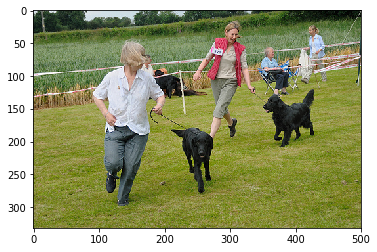

Epoch:  8 , index:  5669  loss:  1.03  | running avg loss:  2.897
Original caption: 
a brown dog is running on a snow covered path .
a brown dog is running through the snow .
a brown dog runs down a snow-covered path .
a brown dog runs through a snowy trail .
a dog runs on a snowy path .

Greedy caption: a dog is walking through snow

Beam caption:
a dog are running through snow [ -4.905918121337891 ]
a brown dogs are running through [ -5.316773414611816 ]
a brown dogs play in snow [ -5.628833055496216 ]


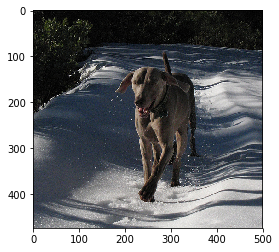

Epoch:  8 , index:  5883  loss:  2.799  | running avg loss:  2.897
Original caption: 
a basketball player in the air about to make a shot .
a basketball player jumps up with the ball as two others watch .
a school basketball game is in progress .
basketball player from eastern goes between two defenders for a shot .
men playing a basketball game .

Greedy caption: a basketball player in a blue uniform is running

Beam caption:
a basketball player in a [ -3.7356035709381104 ]
a basketball player in the [ -4.330085039138794 ]
a basketball player on the [ -5.297415941953659 ]


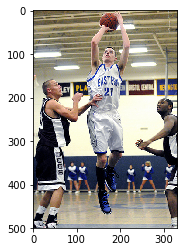




==== EPOCH DONE. === 



Epoch:  9 , index:  272  loss:  2.322  | running avg loss:  2.897
Original caption: 
a family is playing on the beach with their dog .
a fluffy black-and-white dog runs from three people on a sandy beach .
a shaggy dog runs in front of three people on the beach .
a small black and white dog running on the beach with several people in the background
dog in foreground with three people in background .

Greedy caption: a dog is running on the beach

Beam caption:
a black dogs are running [ -4.607856392860413 ]
a black dogs are playing [ -5.214479565620422 ]
a dog are running on [ -5.354780673980713 ]


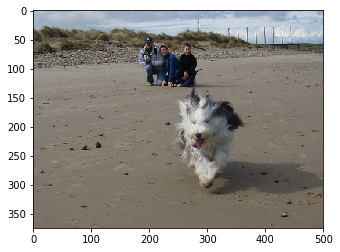

Epoch:  9 , index:  938  loss:  3.856  | running avg loss:  2.896
Original caption: 
a bus filled with passengers in chicago at night .
a bus full of people waiting at a stop .
people are sitting on a bus .
people in a bus which is heading to 84 peterson .
there are people sitting on a bus that is labeled 84 peterson .

Greedy caption: a man in a red shirt is standing on a bench

Beam caption:
a man in the middle of a street [ -9.467742919921875 ]
a man in the middle of a car [ -9.964873313903809 ]
a man in the middle of a road [ -9.970268249511719 ]


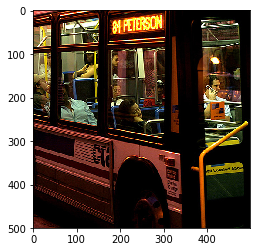

Epoch:  9 , index:  1093  loss:  3.534  | running avg loss:  2.895
Original caption: 
a child is jumping on an inflatable bouncer .
a child plays in a bounce house .
a child wearing a pink coat jumps over a plastic blow-up toy .
a girl bounces .
a girl bounces in a bounce house .

Greedy caption: a girl in a pink shirt is jumping into a swimming pool

Beam caption:
a little girls in a game on a [ -8.030412495136261 ]
a little girls in a game on the [ -8.698423743247986 ]
a young girls are playing in the street [ -8.808652698993683 ]


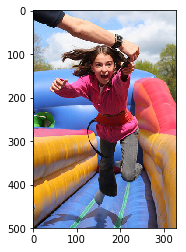

Epoch:  9 , index:  1469  loss:  3.66  | running avg loss:  2.895
Original caption: 
an ambulance is passing a man wearing a bandanna and girl .
an ambulance drives on the street .
a red ambulance drives down the street as two people look on .
two people in seattle looking at an ambulance in the street .
two people stand before an ambulance .

Greedy caption: a man in a black shirt and a black hat is standing next to a

Beam caption:
a group of people in a book [ -7.655921936035156 ]
a man in a street in a [ -8.51637876033783 ]
the man in a book in a [ -8.699517011642456 ]


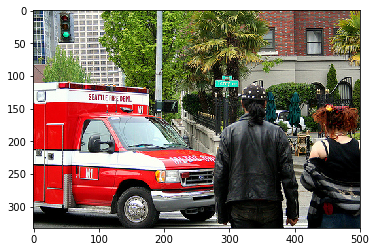

Epoch:  9 , index:  1755  loss:  2.735  | running avg loss:  2.894
Original caption: 
a baby with a pacifier saying i love you in sign language .
a little boy has a pacifier in his mouth and throwing up a sign with his hand .
a little boy is standing in front of an old fashioned fence with his hand up in the air .
a little boy wearing a brown t-shirt is sucking on a pacifier with his hand in the air .
a small child is giving heavy metal signs

Greedy caption: a young girl with a pink shirt is eating a peach

Beam caption:
a young girls are playing with a [ -7.430970668792725 ]
a little girls are playing with a [ -8.028607368469238 ]
a young girls wearing a game with [ -8.2845618724823 ]


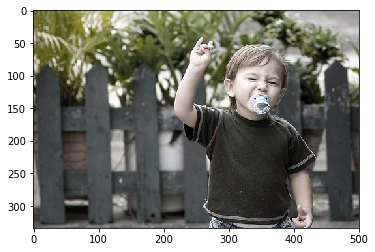

Epoch:  9 , index:  2358  loss:  4.253  | running avg loss:  2.894
Original caption: 
three children are jumping into the air into a swimming pool at a resort .
three children are jumping into the water under a palm tree .
three children jumping into a pool .
three children jumping into a pool with a palm tree in the middle .
three children jump into a hotel pool from an artificial island .

Greedy caption: a boy jumps into the pool

Beam caption:
a boy jump into a game in a [ -8.071928024291992 ]
a boy jump into a game in the [ -8.572823524475098 ]
a boy jump into a game in front [ -8.997465133666992 ]


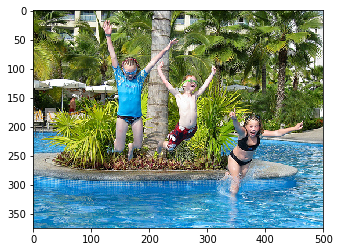

Epoch:  9 , index:  2551  loss:  2.138  | running avg loss:  2.893
Original caption: 
an african man in blue jeans is holding the hands of two boys that are eating ice creams .
man holds the hand of two children .
the man is holding the hands of two boys .
two boys eating ice cream are holding the hands of an adult .
two young boys hold a man 's hands .

Greedy caption: a man and a woman are standing on a sidewalk

Beam caption:
a group of people and a blue shirts [ -8.424874424934387 ]
a group of people and a red shirts [ -8.585821509361267 ]
a group of people are standing in a [ -8.662014961242676 ]


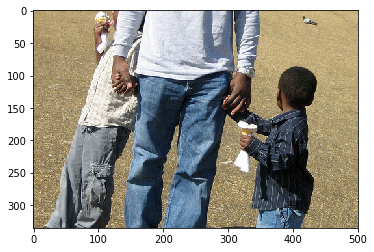

Epoch:  9 , index:  3290  loss:  3.057  | running avg loss:  2.892
Original caption: 
a little girl in a yellow dress lays on a wooden floor surrounded by flowers .
a young girl in a bright yellow dress surrounded by yellow flowers
a young girl wearing yellow lays on the ground .
the girl with a yellow dress and sandals on is surrounded by yellow flowers .
the small girl in the yellow dress laid on the bedspread surrounded by flowers .

Greedy caption: a little boy in a blue shirt is sitting on a bed

Beam caption:
a little boy is sitting on the bed [ -8.98272967338562 ]
a little girl is sitting on the bed [ -9.001463413238525 ]
a little girl in the guitar with a [ -9.016943216323853 ]


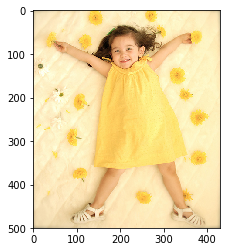

Epoch:  9 , index:  4741  loss:  4.033  | running avg loss:  2.891
Original caption: 
a bird is splashing in the water next to the swimming dog wearing the blue collar .
a dog chases a bird in the water .
a dog swims in a body of water while , slightly ahead , a black duck takes flight .
dog and bird together in water .
the retriever is swimming out to the goose who is about to get away .

Greedy caption: a dog is swimming in the water

Beam caption:
a brown dogs playing in [ -4.547351598739624 ]
two dogs playing in the [ -4.74607527256012 ]
a black dogs playing in [ -4.8173253536224365 ]


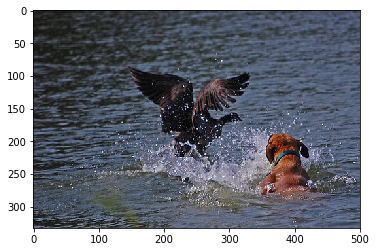

Epoch:  9 , index:  5337  loss:  1.812  | running avg loss:  2.891
Original caption: 
a soccer player in a red and white uniform was chasing the soccer ball and was tripped by a player in a purple uniform .
the guys are playing soccer .
the soccer player in purple keeps the ball from the man in red .
two soccer players are fighting over a soccer ball on a grassy field .
two soccer players kick a soccer ball .

Greedy caption: a soccer player in a blue uniform is kicking the ball

Beam caption:
a soccer in a soccer game [ -3.8907723426818848 ]
a young boys playing soccer game [ -4.787022113800049 ]
a little boys playing soccer game [ -5.443094253540039 ]


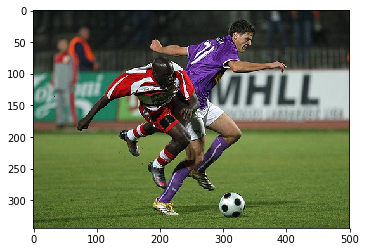

Epoch:  9 , index:  5505  loss:  2.877  | running avg loss:  2.891
Original caption: 
a couple and an infant , being held by the male , sitting next to a pond with a near by stroller .
a couple sit on the grass with a baby and stroller .
a couple with their newborn baby sitting under a tree facing a lake .
a man and woman care for an infant along the side of a body of water .
couple with a baby sit outdoors next to their stroller .

Greedy caption: a man in a blue shirt and a blue shirt is sitting on a bench

Beam caption:
a group of people are sitting on the street [ -9.322946548461914 ]
a group of people are sitting in the street [ -10.092641830444336 ]
a group of people are sitting on the road [ -10.294063568115234 ]


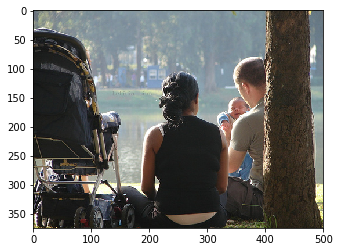

Epoch:  9 , index:  5529  loss:  2.703  | running avg loss:  2.891
Original caption: 
a little boy in a striped shirt going down a light and dark blue slide .
a little boy is sliding down a teal and blue slide .
a small boy is riding a water slide
small boy holding is arm out to balance himself while he goes down the fairground slide .
small boy in blue striped shirt coming down large slide .

Greedy caption: a girl in a pink shirt is sitting on a wooden bench

Beam caption:
a little girl is sitting in front of a [ -9.630776166915894 ]
a little girl is sitting in front of the [ -11.81925082206726 ]
a little girl is sitting on a park ride [ -12.401302546262741 ]


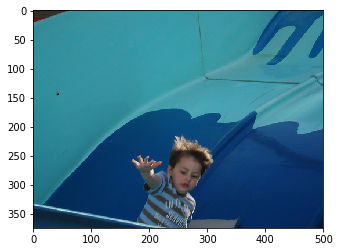

Epoch:  9 , index:  5738  loss:  3.025  | running avg loss:  2.891
Original caption: 
a boy in a white t-shirt does skateboard tricks .
a boy in t-shirt , jeans and knit cap jumps up with his skating board , arms flung out .
a man performs a skateboarding trick on a cement monument in a city park .
a skateboarder is airborne in a city green space .
young skateboarder doing a trick in the park .

Greedy caption: a skateboarder is doing a stunt on a skateboard

Beam caption:
a skateboarder performing a trick on [ -6.151953458786011 ]
a skateboarder are standing on a [ -6.318596243858337 ]
a skateboarder are skateboarding on a [ -6.50713574886322 ]


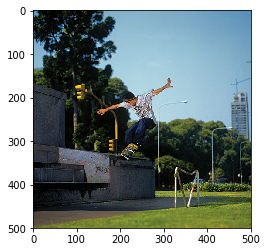




==== EPOCH DONE. === 



Epoch:  10 , index:  17  loss:  3.793  | running avg loss:  2.891
Original caption: 
man in a sweater pointing at the camera .
one man is posing with arms outstretched and finger pointed while another stares from behind him .
the man in the black hat stands behind the man who is pointing his finger .
two men look toward the camera , while the one in front points his index finger .
two men , one wearing a black hat while the one in front points , standing in a hallway .

Greedy caption: a woman in a white shirt and a white shirt is standing in front of

Beam caption:
a group of people are posing for [ -7.733685493469238 ]
a group of people are standing in [ -8.364316821098328 ]
a group of people stand in a [ -8.391854524612427 ]


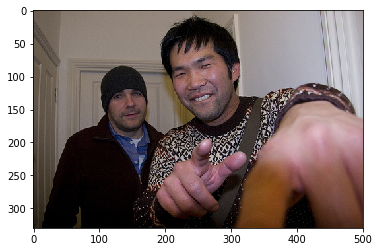

Epoch:  10 , index:  1175  loss:  2.068  | running avg loss:  2.889
Original caption: 
a female hiker is looking at the view of some mountains .
a lady is standing on the edge of a hill looking at the verizon .
a woman hiker stopped at the top of a mountain with a beautiful view
a woman in hiking gear on the top of a mountain , looking down at the valley below .
a woman stands on a mountain looking at others .

Greedy caption: a man in a red jacket is standing on a rock overlooking a valley

Beam caption:
a man in the top of a mountain [ -7.588057637214661 ]
a man in the side of a mountain [ -7.832973599433899 ]
a man in the top of a cliff [ -8.821057796478271 ]


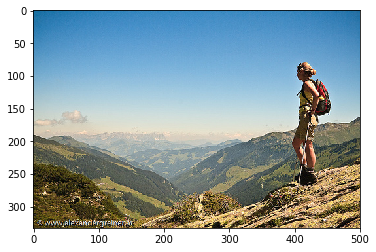

Epoch:  10 , index:  1625  loss:  2.037  | running avg loss:  2.888
Original caption: 
a man smiles and holds onto a rope on a boat .
a man wearing a brown shirt is talking to a man in a white shirt .
a man with a brown t-shirt holds on to a wire while another man looks on .
two men on a boat .
two men one has a white shirt and other one has on a brown shirt and sunglasses .

Greedy caption: a man in a red shirt and sunglasses is standing next to a woman in

Beam caption:
a man sitting on the edge of [ -8.054433465003967 ]
a man in the hay near a [ -8.278529465198517 ]
a girl in the hay near a [ -8.431138813495636 ]


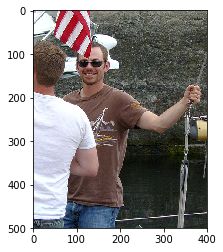

Epoch:  10 , index:  2296  loss:  3.097  | running avg loss:  2.887
Original caption: 
acrobatic entertainers with no shirts perform for spectators .
a midget jumps over another midget .
two men in bowler hats and union jack underwear perform acrobatics .
two men scantily clad performing acrobatic moves in front of a crowd
two men wearing red and blue trunks and bowler hats are performing in a crowded street .

Greedy caption: a group of people are jumping in a line of water

Beam caption:
a group of a line of [ -7.156098365783691 ]
a group of people in front [ -7.361759424209595 ]
a group of people in a [ -7.6678290367126465 ]


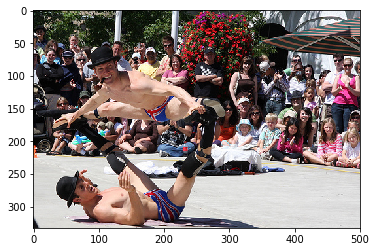

Epoch:  10 , index:  2733  loss:  2.199  | running avg loss:  2.886
Original caption: 
a boy in green jacket is riding a small motocross bike through the mud .
a dirt biker in the mud .
a young boy riding a dirt bike through the mud .
a young child rides a bike on a rough dirt path .
a young child rides a motorbike through the mud .

Greedy caption: a man on a bicycle is riding a bike on a dirt road

Beam caption:
a dirt biker on a bike on [ -6.763708591461182 ]
a man is doing a bike on [ -6.8956451416015625 ]
a dirt biker on a bike while [ -7.135326862335205 ]


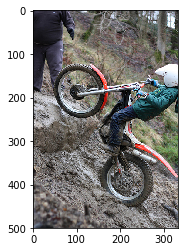

Epoch:  10 , index:  4443  loss:  4.007  | running avg loss:  2.885
Original caption: 
a girl smiles at another girl in a group of people hanging out .
a girl in pink giving another girl a hug .
a young teenage girl talks to another teenager with a red sweatshirt .
girl wearing a hat and holding her bike talks to her friend .
two young girls are talking to one another on a busy street in asia .

Greedy caption: a man wearing a black shirt and a black helmet is standing on a sidewalk

Beam caption:
a man in the street with their [ -9.081007480621338 ]
a woman in the street with their [ -9.290080070495605 ]
a girl is riding their bikes on [ -9.710299015045166 ]


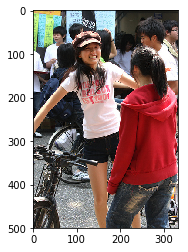

Epoch:  10 , index:  4673  loss:  2.285  | running avg loss:  2.885
Original caption: 
a dog in a lake .
a dog running into the water .
a dog runs through the water .
a dog swims in the lake .
a white dog jumps into natural water .

Greedy caption: a dog runs through the water

Beam caption:
a black dogs are running through [ -5.184680461883545 ]
a black dogs play in the [ -5.469656944274902 ]
a black dogs are running on [ -5.783393859863281 ]


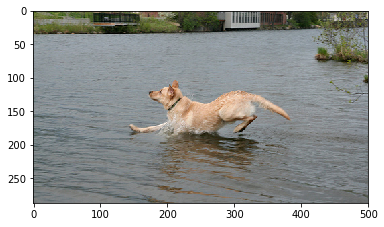

Epoch:  10 , index:  5794  loss:  2.05  | running avg loss:  2.884
Original caption: 
a man and woman , on a park trail , pose in front of a lake and distant mountain .
a man and woman posing for a picture on a mountain hike .
a man holds his arms open wide while standing with a woman .
a man without a shirt poses with his arms spread next to a woman .
a shirtless man poses with a girl hiking in a park .

Greedy caption: a woman in a white shirt is walking along a road

Beam caption:
a man is standing in front of rocks [ -8.942917346954346 ]
a man is standing in front of water [ -8.959972858428955 ]
a woman in the sand with the beach [ -9.239229917526245 ]


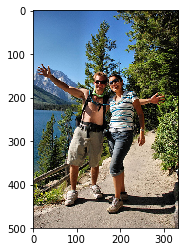




==== EPOCH DONE. === 



Epoch:  11 , index:  1  loss:  3.017  | running avg loss:  2.884
Original caption: 
a little baby plays croquet .
a little girl plays croquet next to a truck .
the child is playing croquette by the truck .
the kid is in front of a car with a put and a ball .
the little boy is playing with a croquet hammer and ball beside the car .

Greedy caption: a young boy in a blue shirt is running along a grassy road

Beam caption:
a little girl in a blue shirt and jeans [ -10.341526627540588 ]
a little girl in a red shirt and jeans [ -10.521637916564941 ]
a little boy in a blue shirt and jeans [ -10.662479043006897 ]


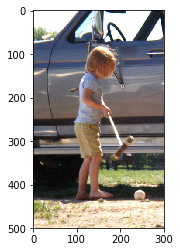

Epoch:  11 , index:  479  loss:  1.945  | running avg loss:  2.884
Original caption: 
four people are posing outside .
four people posing for a picture
four people , two women in the front and a man and woman in the back , pose at night .
one man and three women pose for the camera .
three women and one man are posing for a picture .

Greedy caption: a group of people pose for a picture

Beam caption:
a group of people are posing for a [ -7.940796613693237 ]
a group of people posing for a picture [ -7.953656196594238 ]
a group of men in front of a [ -8.753188610076904 ]


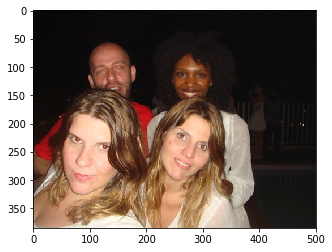

Epoch:  11 , index:  1729  loss:  2.297  | running avg loss:  2.882
Original caption: 
a puppy catching a bird
a small white dog holds a bird in its mouth as it runs in a field .
a white dog carries a gray bird in a field .
a white puppy is carrying a black bird in its mouth .
the dog returns with the hunter 's bird .

Greedy caption: a black and white dog is running through a field

Beam caption:
a black and white dog running on the grass [ -7.391832411289215 ]
a black and white dog is running on the [ -7.6375380754470825 ]
a black and white dog is running in the [ -7.9261980056762695 ]


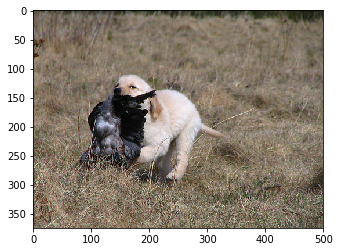

Epoch:  11 , index:  1771  loss:  3.016  | running avg loss:  2.882
Original caption: 
a man doing a trick on a skateboard .
a man is doing a trick on a skateboard in a covered area .
a skateboarder performs a trick .
a young boy playing on his skateboard on a patio of an interesting building , while two people are sitting in chairs in the background .
man doing a skateboard trick on an outdoor park porch .

Greedy caption: a man is rollerblading down a railing

Beam caption:
a man is performing a trick on [ -5.9137327671051025 ]
a man is doing a trick on [ -5.953620195388794 ]
a man is skateboarding on a skateboard [ -6.154247224330902 ]


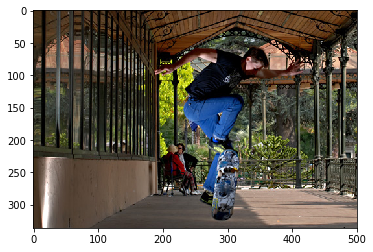

Epoch:  11 , index:  1903  loss:  3.179  | running avg loss:  2.882
Original caption: 
three people scuba dive under the sea .
two individuals underwater scuba diving .
two people are scuba diving in blue water with lots of bubbles .
two people are scuba diving in the blue ocean .
two scuba divers are diving underwater .

Greedy caption: scuba diver underwater

Beam caption:
scuba diver scuba in [ -3.427882432937622 ]
scuba diver scuba diving [ -3.696974992752075 ]
scuba diver scuba dive [ -4.315724611282349 ]


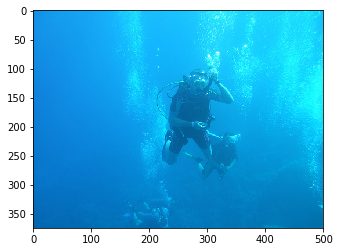

Epoch:  11 , index:  2396  loss:  2.282  | running avg loss:  2.881
Original caption: 
two guys running along a wall .
two men holding their arms out from their bodies .
two men in red shirts appear to be walking on the exterior walls of a decorative building .
two men in red shirts walking on the walls of a white building .
two men wearing dark pants and red shirts are leaping in-synch in front of a white building .

Greedy caption: a man in a white shirt is doing a trick on a skateboard

Beam caption:
a man is doing a handstand on [ -6.31983482837677 ]
a boy is doing a handstand on [ -6.8367520570755005 ]
a man is doing a flip on [ -7.087438464164734 ]


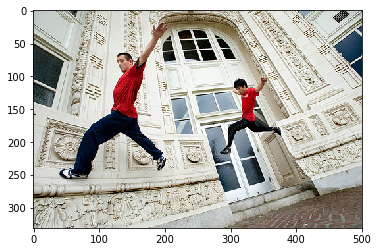

Epoch:  11 , index:  2508  loss:  1.566  | running avg loss:  2.881
Original caption: 
a dog plays in the snow .
a dog , wearing a coat , looks up from the snow .
a small white and grey dog in a jacket standing in the snow .
a white dog in a black coat is standing in the snow .
the white dog stands in the snow wearing a black jacket .

Greedy caption: a dog is running through the snow

Beam caption:
a dog are playing in a [ -6.5482834577560425 ]
a white dog is playing with [ -6.92536473274231 ]
a black dog is playing with [ -7.119505167007446 ]


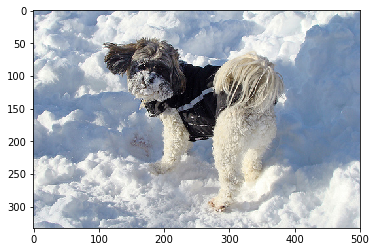

Epoch:  11 , index:  2591  loss:  1.105  | running avg loss:  2.881
Original caption: 
a black and white dog frolicks in the water .
a black and white dog leaps through the water .
a black-and-white dog running in the water .
a black and white dog runs through the white water at a beach .
the black and white dog is running through the ocean .

Greedy caption: a black and white dog is running through the water

Beam caption:
a black dogs are running in [ -3.9276809692382812 ]
a black dogs are playing in [ -4.161654710769653 ]
a black and white dog are [ -4.355325222015381 ]


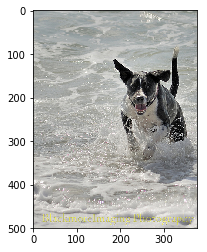

Epoch:  11 , index:  3109  loss:  2.14  | running avg loss:  2.88
Original caption: 
a few men sprint across the grass in competition with one another .
a man in a grey shirt is winning a race in the grass .
a man leads the way in a race .
people running a race and the guy in grey is in the lead .
two men running outside in a competition .

Greedy caption: a soccer player in a blue uniform is running

Beam caption:
a group of men playing soccer [ -5.706057071685791 ]
a group of boys playing soccer [ -6.476635932922363 ]
a group of men play soccer [ -6.585987567901611 ]


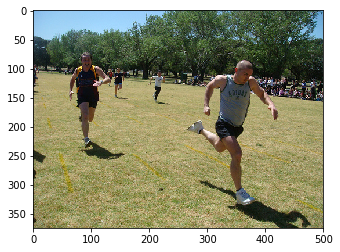

Epoch:  11 , index:  3787  loss:  1.682  | running avg loss:  2.879
Original caption: 
a girl in a bikini swimming in a body of water .
a girl swims in the blue-green waters .
a tan girl in a floral bikini is swimming in dark blue waters .
the girl is swimming in sparkling greenish blue water .
the girl is swimming is a blue-green ocean .

Greedy caption: a girl in swimming trunks swims underwater

Beam caption:
a girl is splashing in the ocean [ -7.04828405380249 ]
a young girl in a swimming pool [ -7.234016418457031 ]
a little girl in a swimming pool [ -7.526291847229004 ]


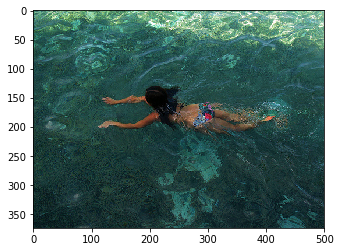

Epoch:  11 , index:  3967  loss:  2.824  | running avg loss:  2.879
Original caption: 
a man and two ladies looking faded as they hold bottles of beer in their hands .
a man in a red shirt and two women hold beer
bald man , two women with beers , posing at event .
man in red t-shirt posing with two young women and three beer bottles .
three people holding beers and posing for a picture .

Greedy caption: a group of young women are posing for a picture

Beam caption:
a group of people are posing for [ -8.047058343887329 ]
a group of people and a woman [ -8.932624697685242 ]
a group of people and a man [ -8.938140273094177 ]


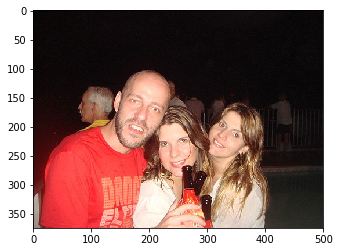

Epoch:  11 , index:  4096  loss:  3.551  | running avg loss:  2.879
Original caption: 
a brown and white dog with a black collar and gold tag licking the snow from its nose .
a dog licking its lips while snow falls .
a shaggy dog dusted with snow licks its nose .
a white and brown dog licks his lips during winter .
the brown and white dog licks the snow off of his cold nose .

Greedy caption: a white dog is running through the grass

Beam caption:
a white dog is running through the snow [ -7.144773721694946 ]
a white dog is running through the grass [ -7.185364723205566 ]
a white dog is running through the water [ -7.574845552444458 ]


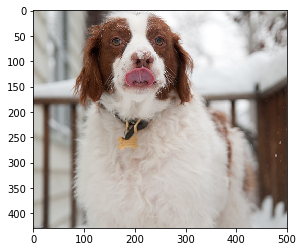

Epoch:  11 , index:  4565  loss:  2.878  | running avg loss:  2.878
Original caption: 
a brown dog is walking on the grass beside a fence .
a brown dog trotting across a grassy , fenced-in yard .
a large brown dog in a fenced yard
large dog is playing outdoors inside of a fence .
lean dog trots through a sunny park in front of a chain link fence .

Greedy caption: a dog running through the snow

Beam caption:
a brown dog is running through the grass path [ -6.976911544799805 ]
a brown dog is running on the grass path [ -7.687537670135498 ]
a brown dog is running through the sand dune [ -7.738539516925812 ]


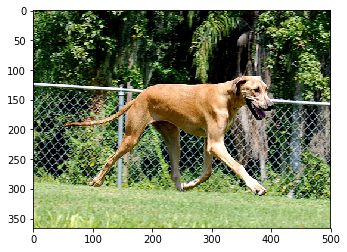

Epoch:  11 , index:  5617  loss:  2.442  | running avg loss:  2.877
Original caption: 
a man in a cap with a goatee leans against the window and reads a magazine .
a man sitting on an empty train
a man with a black hat and black beard is reading a magazine sitting on a blue bench .
a man with a hat sits in a booth and reads .
the man reading a magazine is sitting in the large room .

Greedy caption: a man in a black shirt is standing on a bench

Beam caption:
a man sitting on the middle of chairs [ -9.21204161643982 ]
a man in a white chairs in front [ -10.55456018447876 ]
a man in a black chairs in front [ -10.621097326278687 ]


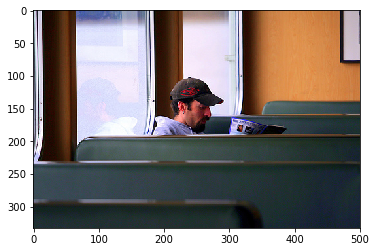




==== EPOCH DONE. === 



Epoch:  12 , index:  889  loss:  3.21  | running avg loss:  2.876
Original caption: 
a man with a damaged eye stands with a child and a woman .
a man , woman , and child .
a man , woman and little boy pose for a picture in front of an outside door .
man with injured eye and woman holding child pose outside of building .
two adults and a small child pose outside a dwelling .

Greedy caption: a man and woman are sitting on a bench

Beam caption:
a man is sitting on a row of [ -7.031734585762024 ]
a man in front of a row of [ -8.084475040435791 ]
a man is sitting on a red shirt [ -8.369512677192688 ]


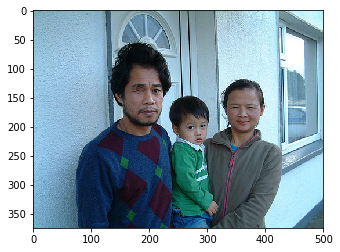

Epoch:  12 , index:  1377  loss:  3.924  | running avg loss:  2.876
Original caption: 
a girl goes down a red slide .
a girl inside a long tubular slide .
a little girl with long hear and something in her mouth , wearing light-colored clothing is sliding down a tunnel .
a young girl going down a tube slide .
young girl in tunnel slide

Greedy caption: a man in a yellow shirt is sitting on a boat with a red umbrella

Beam caption:
a brown dog is playing in a row of [ -11.633117318153381 ]
a brown dog is sitting on a row of [ -11.714237689971924 ]
a brown dog is playing in the grass with [ -12.793729543685913 ]


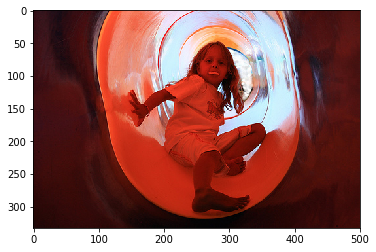

Epoch:  12 , index:  1387  loss:  1.712  | running avg loss:  2.876
Original caption: 
a skier doing a high jump from a snowy ramp near a mountain range .
a ski jumper enjoys winter fun .
a snowboarder flies off of a jump which is next to a big red atomic sign .
a snowboarder is up in the air having taken off from a big jump in a tournament .
a snowboarder jumps off a large ramp in the mountains .

Greedy caption: a man in a red jacket is standing on a snowy mountain

Beam caption:
a man is sitting on a snowy mountains [ -5.8955718874931335 ]
a man is standing on a snowy mountains [ -6.558886706829071 ]
a hiker is sitting on a snowy mountains [ -7.195256292819977 ]


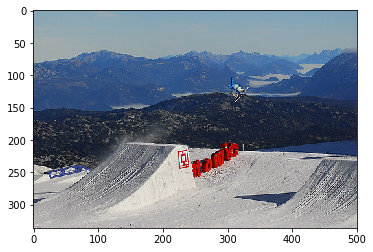

Epoch:  12 , index:  3121  loss:  1.824  | running avg loss:  2.874
Original caption: 
an older woman and a young girl standing in front of a large bush covered in pink flowers .
a woman poses with a small girl in front of a flower bush .
older woman puts hands on shoulders of little girl , plants in background .
old lady and little girl stand in front of purple flowers .
the woman is standing in the garden with a young girl .

Greedy caption: a young girl in a blue dress is sitting on a bench

Beam caption:
a little girls in a game [ -6.480234861373901 ]
a little girls are playing in [ -7.387694478034973 ]
a young children are playing in [ -7.462437272071838 ]


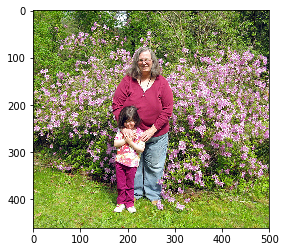

Epoch:  12 , index:  3423  loss:  2.349  | running avg loss:  2.873
Original caption: 
motorcyclists near the beach .
there are two motorcycles with a man and a woman on it .
two guys with helmets are on motorcycles , each with a woman riding behind him
two motorcycles and four riders are on the road .
two motorcycles with two riders each .

Greedy caption: a man in a red helmet and yellow helmet is riding a bike on a

Beam caption:
a group of people are riding a [ -7.170827865600586 ]
a man is being ridden around a [ -7.642819762229919 ]
a man is being ridden in a [ -7.699134349822998 ]


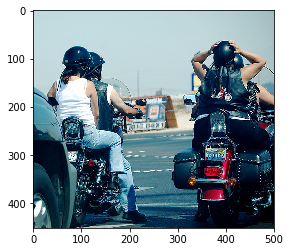

Epoch:  12 , index:  5122  loss:  3.115  | running avg loss:  2.872
Original caption: 
one dog shaking the water off , getting a second dog wet
two dogs are shaking off water while playing with a ball on the edge of a body of water .
two dogs shake off water in an area with very little vegetation .
two dogs shaking off water droplets on a beach .
two dogs shaking themselves dry on the sand .

Greedy caption: a dog is running through the snow

Beam caption:
a black dog is walking through the water with [ -10.06355619430542 ]
a black dog is running through the water with [ -10.287537574768066 ]
a black dog is walking through the snow with [ -10.364673614501953 ]


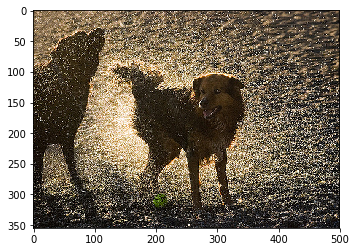

Epoch:  12 , index:  5845  loss:  1.154  | running avg loss:  2.872
Original caption: 
a black dog carrying a colorful ball swims .
a black dog is retrieving a ball in water .
a black dog is swimming with a ball in his mouth .
a black dog swims in water with a colorful ball in his mouth .
black dog paddles through the water with a bright ball in its mouth .

Greedy caption: a black dog is swimming in a pool

Beam caption:
a black and white dogs swimming in [ -4.455366849899292 ]
a black and black dogs swimming in [ -4.641111135482788 ]
a black and white dogs are swimming [ -5.377327561378479 ]


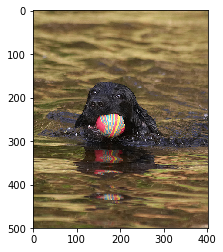




==== EPOCH DONE. === 



Epoch:  13 , index:  97  loss:  3.437  | running avg loss:  2.872
Original caption: 
a few girls with green foam statue of liberty hats on a train
some young adults are wearing green foam statute of liberty crowns .
some young people take photos of each other while in new york .
three woman with statue of liberty hats and taking a picture .
two woman wearing statue of liberty hats get their picture taken in a subway .

Greedy caption: a group of people are sitting on a couch

Beam caption:
a group of people are sitting [ -5.665572881698608 ]
a group of people pose for [ -5.71555233001709 ]
a group of people are gathered [ -5.853480577468872 ]


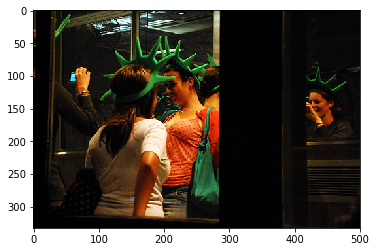

Epoch:  13 , index:  812  loss:  0.864  | running avg loss:  2.871
Original caption: 
a black and white dog is jumping fences in a dog show .
a black and white dog jumping over a steeple vault at a competition
a black and white dog performs a jump with his owner looking on .
a black and white dog running through an obstacle course
a dog leaping over a hurdle .

Greedy caption: a black and white dog jumps over a hurdle

Beam caption:
a black and a black dogs are [ -5.204587340354919 ]
a black and a white dogs are [ -5.2438777685165405 ]
a black and a dog are playing [ -5.773681640625 ]


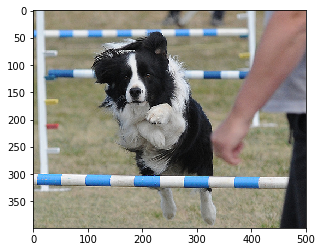

Epoch:  13 , index:  955  loss:  3.259  | running avg loss:  2.871
Original caption: 
a black man leans over as a white man jumps on his back backwards .
a man holding up another with his back .
a man in midair with his back touching that of another man hunched over
one man in a hat flips over another mans back in the grass .
two people play outdoors .

Greedy caption: a man in a red shirt is running along a track

Beam caption:
a man is wearing a trick on [ -6.518006324768066 ]
a man is performing a trick on [ -6.5412397384643555 ]
a man is wearing a trick in [ -7.407599449157715 ]


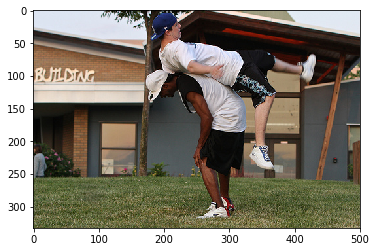

Epoch:  13 , index:  1355  loss:  2.188  | running avg loss:  2.871
Original caption: 
a group of cars parked on a hill
a group of off road vehicles parked together high in the mountains .
a group of vehicles are parked on a hill in the fall .
a line of off-road vehicles is parked on the hill outside a wooded area .
many cars parked on a mountain .

Greedy caption: a man in a red jacket is standing on a mountain with a mountain in

Beam caption:
a man in the side of a vehicle [ -8.122451066970825 ]
a man in the side of a dirt [ -9.5169677734375 ]
a man in the side of a mountain [ -9.636462211608887 ]


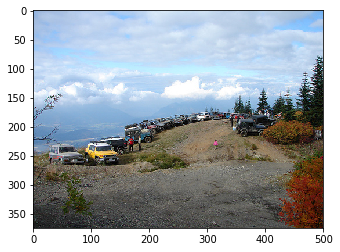

Epoch:  13 , index:  1382  loss:  2.243  | running avg loss:  2.871
Original caption: 
a bearded man reads while sitting on a wall in a park .
a man reads his paper on the bench .
a man wearing a red shirt sits on a cement bench and reads the paper .
an old man sits outside reading a newspaper .
an old man with a white beard is reading .

Greedy caption: a man in a red shirt is standing on a sidewalk

Beam caption:
a young boys are walking on the sidewalk [ -9.126079678535461 ]
a young boys are standing on the sidewalk [ -9.355195045471191 ]
a young boys are walking on the street [ -9.423124432563782 ]


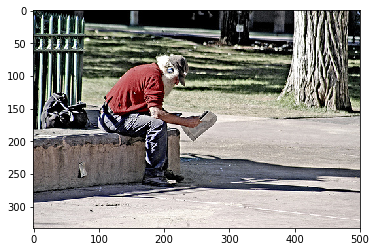

Epoch:  13 , index:  1426  loss:  4.367  | running avg loss:  2.87
Original caption: 
a jockey in yellow and a jockey in blue are racing their horses down a grassy raceway .
the jockey wearing a yellow hat edges out the jockey wearing blue .
two horses with riders , race along the track .
two jockeys , one in yellow , one in blue , riding horses in a race .
two jockeys race horses

Greedy caption: a greyhound is running on the sand

Beam caption:
a greyhound dogs are running [ -5.504133224487305 ]
a brown dogs are running [ -5.754317283630371 ]
a dog is jumping over [ -6.014845848083496 ]


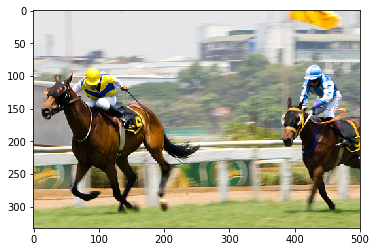

Epoch:  13 , index:  1711  loss:  2.326  | running avg loss:  2.87
Original caption: 
a woman helping a young blonde girl .
a woman in a sweater is painting the face of a young girl in a striped shirt .
a woman paints a picture on a girl 's face .
a woman with glasses is face painting a blond girl .
the woman wearing glasses is painting the face of the blonde girl .

Greedy caption: a woman wearing a red shirt and glasses is smiling

Beam caption:
a woman in front of a woman [ -6.4348649978637695 ]
a woman in front of a man [ -6.71630859375 ]
a woman wearing a man who is [ -7.851176619529724 ]


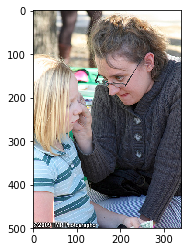

Epoch:  13 , index:  2432  loss:  3.562  | running avg loss:  2.869
Original caption: 
a girl is playing on a homemade swing that hangs from a tree over water .
a girl is sitting on a crudely made swing above the water .
a girl is swinging over waves on a rope swing .
a girl swinging from a tree on a rope over crashing waves .
a girl swings on a tree over breaking waves .

Greedy caption: a man in a wetsuit is surfing

Beam caption:
a young man in the crashing wave [ -7.76547771692276 ]
a man in the water wave while [ -8.682261049747467 ]
a man in the water wave over [ -8.960101187229156 ]


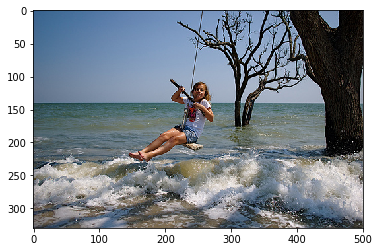

Epoch:  13 , index:  2440  loss:  2.6  | running avg loss:  2.869
Original caption: 
a baby is peeking his head over blue playpen .
a baby is peeking over the top of a blue playpen .
a baby looks out over the edge of its playpen .
a baby peeking out from inside her cot
a small child is standing in his blue and aqua playpen and all you see if from his eyes up .

Greedy caption: a little boy is playing on a red inflatable slide

Beam caption:
a little girls are playing on a [ -5.303894758224487 ]
a young girls are playing on a [ -5.899950742721558 ]
a little girls are playing on the [ -6.438380479812622 ]


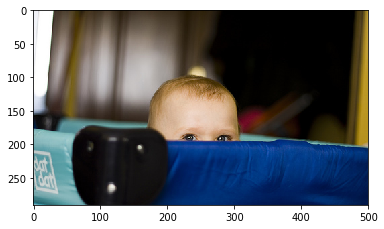

Epoch:  13 , index:  3350  loss:  1.296  | running avg loss:  2.868
Original caption: 
a black and brown dog is running through the woods .
a black and brown dog runs through the woods .
a dog running through the woods .
a dog runs through the woods .
brown dog with mouth open running toward camera in a wooded area .

Greedy caption: a dog is running through the grass

Beam caption:
a brown dogs are running [ -4.550586938858032 ]
two brown dogs are running [ -5.342910051345825 ]
a brown dogs are playing [ -5.4389119148254395 ]


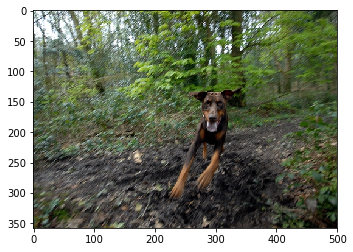

Epoch:  13 , index:  3807  loss:  2.633  | running avg loss:  2.868
Original caption: 
a brown dog chasing a frisbee , a barbeque in the background .
a brown dog is trying to catch a flying disk but missed it .
a dog is twisting in the air as it tries to catch a frisbee .
brown dog plays with frisbee .
the brown dog dives backwards to catch the football .

Greedy caption: a dog is jumping up to catch a frisbee

Beam caption:
a brown dog is jumping over a grassy grass [ -6.6539987325668335 ]
a brown dog is jumping over a grassy yard [ -7.54718816280365 ]
a brown dog is running through the grass while [ -8.00994324684143 ]


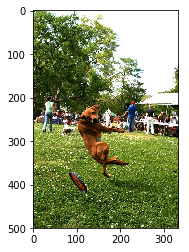

Epoch:  13 , index:  4015  loss:  1.755  | running avg loss:  2.868
Original caption: 
a boy hits the ball at a baseball game .
a softball player 's team watches as she swings at a pitch .
batter hits a baseball
one of the members of a baseball team in brown and white is at bat .
softball player swinging at a pitch

Greedy caption: a baseball player in a red uniform is running towards the ball

Beam caption:
a baseball players are playing cricket [ -6.154319405555725 ]
a baseball players are playing softball [ -6.524800658226013 ]
a baseball players are playing baseball [ -6.807730793952942 ]


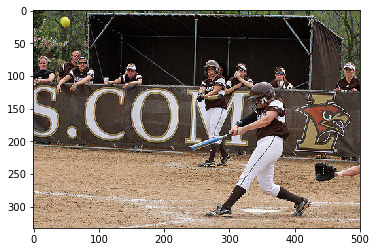

Epoch:  13 , index:  5314  loss:  3.615  | running avg loss:  2.866
Original caption: 
a child in a black shirt reaches for a white kitchen stove
a little kid in a black shirt and striped pants is playing with the controls on a stove .
a toddler in stripy pants is reaching for a white stove in a red floored kitchen .
a toddler is reaching up to touch a stove .
the toddler touches the white stove .

Greedy caption: a young boy in a red shirt is jumping into a pile of stairs

Beam caption:
a little girl is sitting on a chair with [ -10.03329849243164 ]
a little girl is sitting on the grass reading [ -10.084925413131714 ]
a little girl is sitting on a chair in [ -10.229833841323853 ]


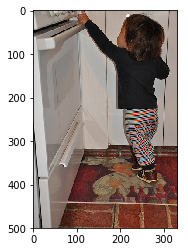

Epoch:  13 , index:  5928  loss:  4.016  | running avg loss:  2.866
Original caption: 
a little girl holding hands with her ice skating instructor .
an older girl helps a younger girl ice skate .
the two girls hold hands with one another while they skate on the ice .
two girls are ice skating with each other .
two people go ice skating in a rink .

Greedy caption: a man in a blue shirt is standing in front of a white building

Beam caption:
a young men are standing in a [ -9.180681645870209 ]
a young men in a hurdle in [ -9.516551852226257 ]
a young men are dancing in a [ -9.633845686912537 ]


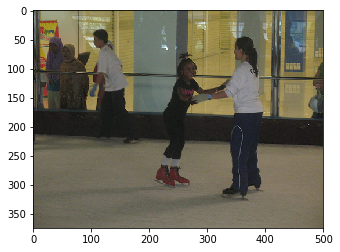




==== EPOCH DONE. === 



Epoch:  14 , index:  3  loss:  1.599  | running avg loss:  2.866
Original caption: 
a brown dog is running along a beach .
a brown dog wearing a black collar running across the beach .
a dog walks on the sand near the water .
brown dog running on the beach .
the large brown dog is running on the beach by the ocean .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown dogs are running through [ -5.40981137752533 ]
a brown dogs are playing in [ -5.8890990018844604 ]
a brown dogs play in the [ -5.9877026081085205 ]


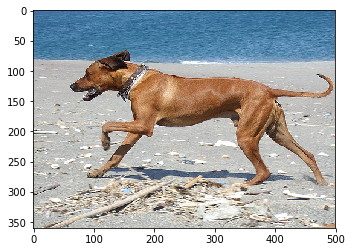

Epoch:  14 , index:  125  loss:  3.417  | running avg loss:  2.866
Original caption: 
an athlete performs the high jump .
a woman athlete launching herself over the bar during a pole vault .
a woman is black is pole vaulting .
a woman pole vaulter upside down as she attempts the vault .
a woman with her feet in the air about to do pole vaulting

Greedy caption: a girl in a pink shirt is jumping into the air

Beam caption:
a woman in the air to catch a frisbee [ -7.852461099624634 ]
a woman in the air to catch the ball [ -9.429813623428345 ]
a woman in the air to catch a ball [ -9.490761518478394 ]


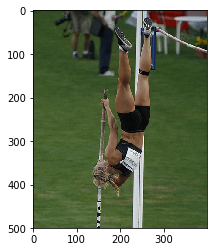

Epoch:  14 , index:  1041  loss:  3.399  | running avg loss:  2.865
Original caption: 
a girl jumping in the grass .
a girl jumps in the grass .
a young blonde girl with a pink shirt on jumps high into the air while kicking her foot out and sticking her tongue out .
the blond girl is jumping up in the air .
the girl in a pink shirt jumps high over the grass .

Greedy caption: a girl in a pink shirt is jumping over a hurdle

Beam caption:
a young girl in the air from another [ -7.648922860622406 ]
a young girl in the air while another [ -8.339539527893066 ]
a girl in a pink shirt is jumping [ -8.96187448501587 ]


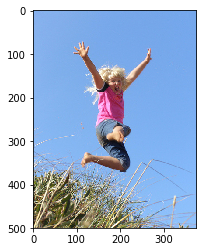

Epoch:  14 , index:  1606  loss:  3.611  | running avg loss:  2.864
Original caption: 
a baby girl has the contents of a red pot all over her face .
a baby girl holding a red plastic box in one hand and eating from it with the other , some of it on her face .
a little girl in a highchair has food all over her lower face and her finger in her mouth .
a toddler with pudding all over her face and hands from eating with her fingers .
the little girl is in her high chair eating jello .

Greedy caption: a little boy is eating a little girl

Beam caption:
a little girl in a violin in a [ -7.559816122055054 ]
a little girl with a violin in a [ -7.914914846420288 ]
a little girl is playing with a hospital [ -8.134681463241577 ]


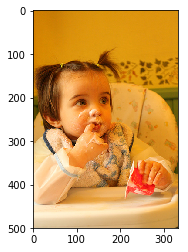

Epoch:  14 , index:  1756  loss:  1.372  | running avg loss:  2.864
Original caption: 
a fluffy white and brown puppy is playing with a white , curly haired puppy .
a spotted dog butting a white dog with his head .
a white dog and a white and brown puppy playing .
two dogs are playing together .
two dogs play with one another on the lawn .

Greedy caption: a dog runs through the grass

Beam caption:
a black and a white dog with [ -6.646624565124512 ]
a black and a white dog are [ -6.848056316375732 ]
a white dog is running on grass [ -7.194317579269409 ]


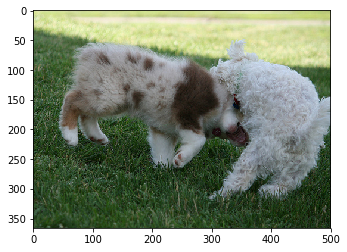

Epoch:  14 , index:  3771  loss:  1.547  | running avg loss:  2.863
Original caption: 
a boy runs through the puddle .
a boy splashing in a puddle .
a young boy is running through a large puddle outside .
a young boy is splashing through a puddle of water .
young boy playing in the water .

Greedy caption: a boy is jumping into a pool

Beam caption:
a young boys playing in a swimming pool [ -5.986354231834412 ]
a boy are playing in a swimming pool [ -6.070298790931702 ]
a young boys play in the water pool [ -7.265066385269165 ]


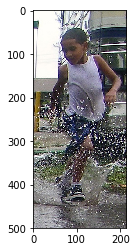

Epoch:  14 , index:  3889  loss:  1.689  | running avg loss:  2.863
Original caption: 
a man jumps through the air while snowboarding .
a snowboarder in gray pants and a white jacket catches some air .
a snowboarder in gray pants is doing a jump .
a snowboarder with brown pants .
person wearing grey pants airborne on a snowboard .

Greedy caption: a snowboarder is jumping over a hill

Beam caption:
a snowboarder is performing a jump on a [ -6.525743246078491 ]
a man is performing a jump on a [ -6.695055723190308 ]
a snowboarder is doing a jump on a [ -6.755245923995972 ]


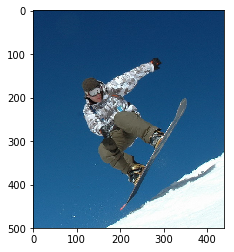




==== EPOCH DONE. === 



Epoch:  15 , index:  210  loss:  1.525  | running avg loss:  2.861
Original caption: 
a dog runs across the grass .
a golden dog is running on the grass .
a tan dog leaping in a grassy field .
brown dog leaps through field .
the dog is running quickly through the meadow .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown dog is jumping over a [ -5.683864951133728 ]
a brown dog is running through the [ -5.755780100822449 ]
a brown dog is running across the [ -5.875743865966797 ]


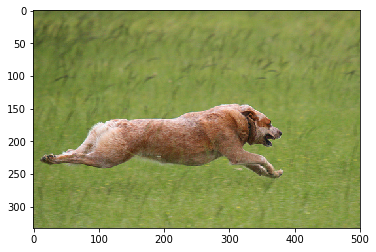

Epoch:  15 , index:  1742  loss:  2.044  | running avg loss:  2.86
Original caption: 
a lady and her daughter jump in a swimming pool .
a woman and a child play in the water .
a woman and a girl splashing in water .
a woman is holding a small girl in the midst of a large wave .
mother and daughter play in the waves .

Greedy caption: a man in a black wetsuit is swimming in the ocean

Beam caption:
a man in a swimming in the [ -7.796475648880005 ]
a man in a swimming in a [ -8.557372808456421 ]
a young man rides a surfboard on [ -8.897737979888916 ]


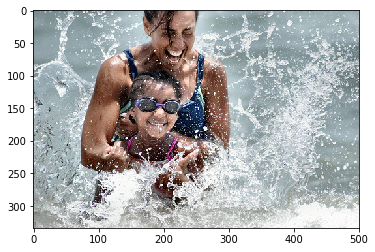

Epoch:  15 , index:  2769  loss:  2.955  | running avg loss:  2.859
Original caption: 
a brown dog is being attacked by two other dogs .
three dogs appear to be playing rough inside a fenced enclosure .
three dogs playfully wrestle .
two dogs standing and one dog laying down on its back .
two standing dogs and one brown dog lying on its back interact .

Greedy caption: two dogs play in the grass

Beam caption:
two dogs are playing in the grass [ -6.885161519050598 ]
two dogs playing in a grassy field [ -7.087348461151123 ]
two dogs play in a grassy field [ -7.15407657623291 ]


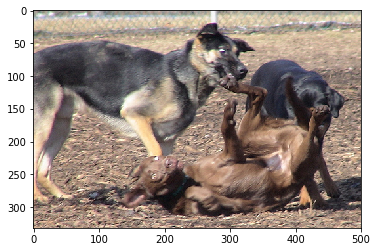

Epoch:  15 , index:  2902  loss:  3.209  | running avg loss:  2.859
Original caption: 
a black and brown dog walking in deep snow .
a black dog runs down a snowy hill with his legs deep in the snow .
a dog shoulder-deep in snow .
a dog up to its belly in the snow attempts to move .
the dog runs in the deep snow .

Greedy caption: a dog is running through the snow

Beam caption:
a white dog is running through the snow [ -7.043378114700317 ]
a dog are playing in the snow with [ -7.268526315689087 ]
two dogs are playing in the snow with [ -7.273559331893921 ]


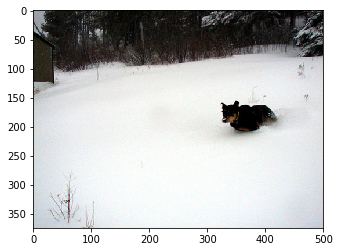

Epoch:  15 , index:  3031  loss:  2.643  | running avg loss:  2.859
Original caption: 
a man swings a golf club while the person to his left waves an arm .
man teeing off on a golf course with a large building in the background .
two men are standing on a golf course with a large , ornate building in the background .
two people are on a golf course playing golf .
two people are playing golf on a golf course .

Greedy caption: a man in a white shirt is throwing a frisbee

Beam caption:
a man is running in a field [ -7.2086838483810425 ]
a group of men play soccer game [ -7.437903523445129 ]
a group of men in a game [ -7.600763261318207 ]


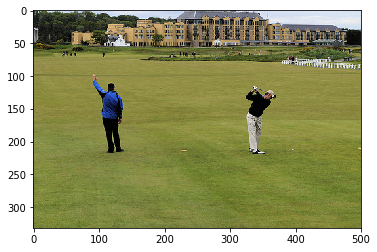

Epoch:  15 , index:  3202  loss:  2.059  | running avg loss:  2.859
Original caption: 
a black dog is swimming while carrying a tennis
a black dog swimming in the water with a tennis ball in his mouth
a black dog swims through the water with a tennis ball in its mouth .
a dog swims in water with a blue and green tennis ball in its mouth .
a dog with a ball in its mouth swims in the water .

Greedy caption: a black dog swims in the water

Beam caption:
a black dog swims in the [ -4.802268862724304 ]
a black dog is swimming in [ -5.119451642036438 ]
a black dog is playing in [ -5.146876811981201 ]


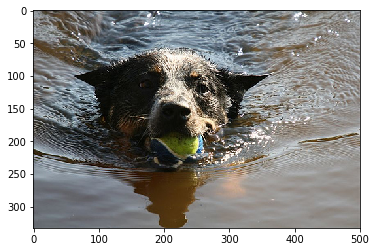

Epoch:  15 , index:  3583  loss:  4.56  | running avg loss:  2.859
Original caption: 
two boys are sprinting on a running track .
two boys race each other on foot .
two men in a running contest .
two young men running along a track .
two young men run on a track outside .

Greedy caption: a boy skateboards on a ramp

Beam caption:
a boy is doing a trick in [ -6.914937049150467 ]
a boy is doing a trick on [ -7.112829953432083 ]
a young man is jumping trick in [ -7.158063441514969 ]


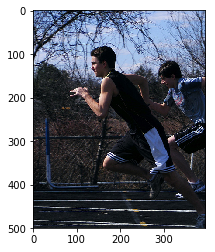

Epoch:  15 , index:  4224  loss:  4.516  | running avg loss:  2.858
Original caption: 
a strange piece of art with lights .
onlookers view picture with wires and lights .
the two people are viewing an artist 's piece .
the two people gazed at the unique pictures on the wall .
two people looking at a light exhibit of some sort .

Greedy caption: a man and a woman sit on a bench

Beam caption:
a man is sitting on a skateboard in [ -8.2861328125 ]
a man is looking at a skateboard in [ -8.729326486587524 ]
a man is sitting on a skateboard with [ -9.084710597991943 ]


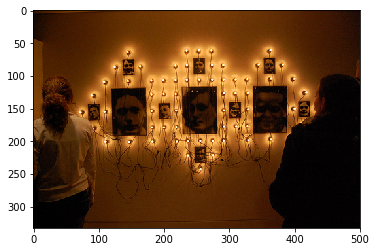

Epoch:  15 , index:  4408  loss:  2.09  | running avg loss:  2.858
Original caption: 
a girl wearing a black top is smiling with a silver truck in the background .
a woman in a black dress smiles in front of a silver truck .
a woman in a black shirt smiling front of a car
a woman wearing black stands in front of a pickup truck .
smiling girl in front of a white truck .

Greedy caption: a man in a black shirt and a blue shirt is standing in front of

Beam caption:
a woman in front of a red and [ -8.964600205421448 ]
a man in front of a red and [ -8.996245503425598 ]
a woman in front of a black and [ -9.366905093193054 ]


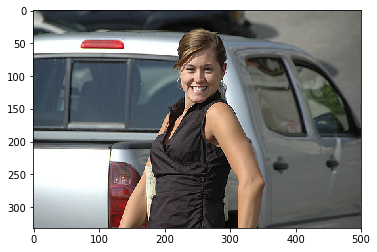

Epoch:  15 , index:  5293  loss:  4.493  | running avg loss:  2.857
Original caption: 
a team of four judges rates a competition .
four judges are sitting at a table with the center left one speaking .
four people are sitting at a table , with microphones and bottles of water in front of them .
man in red shirt speaks into microphone
the gentleman is speaking while the others are listening .

Greedy caption: a man in a black shirt is standing in front of a microphone

Beam caption:
a group of people are standing in front of [ -9.3648042678833 ]
a group of people are standing in a room [ -10.042402267456055 ]
a group of people are standing around a room [ -10.226486921310425 ]


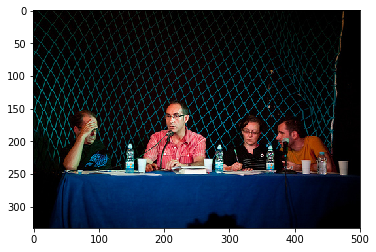

Epoch:  15 , index:  5676  loss:  3.126  | running avg loss:  2.856
Original caption: 
a girl who looks upset with her arms crossed .
an indian woman in a black shirt stands with her arms crossed looking at two other people talking to each other .
a person in a red and black shirt has their arms crossed and looks at the camera .
a teenage girl is standing with her arms crossed in a busy street .
woman in dark shirt standing alone in front of a yellow car .

Greedy caption: a man in a black shirt is standing in front of a crowd of people

Beam caption:
a group of a white t shirt is [ -8.497143745422363 ]
a group of a blue shirt and black [ -8.812678098678589 ]
a group of a blue shirt and white [ -8.863587141036987 ]


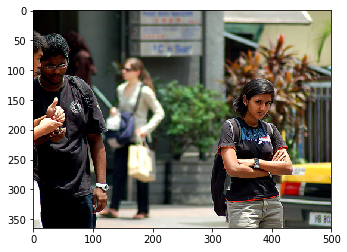




==== EPOCH DONE. === 



Epoch:  16 , index:  143  loss:  2.407  | running avg loss:  2.856
Original caption: 
a boy and girl in swimwear and arm floaters
a little boy and a little girl wearing water wings are running on a path beside a black fence ,
a little boy and girl in their swimsuits wearing arm floats .
the boy and girl are playing with arm floats on .
young boy and girl running with water wings on

Greedy caption: a little girl in a pink dress is running through a puddle

Beam caption:
a little girl is standing in front of a blue [ -10.326688528060913 ]
a little girl is standing in front of a white [ -10.558204412460327 ]
a little girl is standing in front of a green [ -10.562102556228638 ]


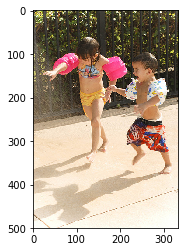

Epoch:  16 , index:  498  loss:  2.742  | running avg loss:  2.856
Original caption: 
two guys dressed in tuxes with red ties
two men dressed for a wedding laugh at the camera , with beverages in hand .
two men dressed up share a toast .
two men in matching suits are smiling and drinking .
two men in suits laugh and hold drinks .

Greedy caption: a man in a black shirt and tie

Beam caption:
a man in front of a picture [ -5.756415128707886 ]
a man is posing for a picture [ -6.79432475566864 ]
a man is posing for the camera [ -7.426311612129211 ]


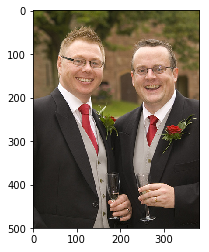

Epoch:  16 , index:  624  loss:  3.001  | running avg loss:  2.856
Original caption: 
a boy celebrating with paint on his face and clothing .
boy covered in finger paint .
closeup of young boy with his face and body painted .
the boy has orange paint on him .
the boy wearing orange face paint is carrying a toy fish in around his next .

Greedy caption: a man in a white shirt and a white t shirt is standing in front

Beam caption:
a young girl in the middle of [ -7.698976278305054 ]
a young man with their arms around [ -8.777383804321289 ]
a young girl in the air with [ -9.535140633583069 ]


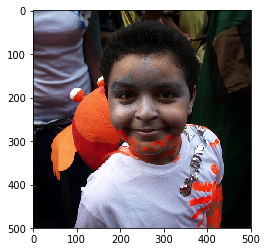

Epoch:  16 , index:  630  loss:  1.523  | running avg loss:  2.856
Original caption: 
a small girl spins in the waves in the bright sun .
a young girl plays in shallow water .
a young girl wears a shirt and shorts as she plays in the ocean 's surf .
girl running through the water near the shore .
the little girl splashes through the water .

Greedy caption: a young boy jumping into the water

Beam caption:
a young boys play in the sand [ -5.756949186325073 ]
a young boys playing in the sand [ -6.3100526332855225 ]
a young boys play in the ocean [ -6.42477011680603 ]


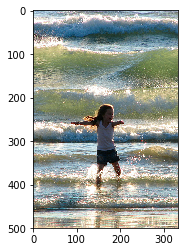

Epoch:  16 , index:  722  loss:  2.492  | running avg loss:  2.856
Original caption: 
a man holding money , standing in front of a street band and a store .
a man holds a dollar bill in front of his face while posing in front of a street band .
a man holds money in the air .
a man in a green jacket is standing outside a store holding some money in front of his face .
an african-american man wearing a green sweatshirt and blue vest is holding up 2 dollar bills in front of his face , while standing on a busy sidewalk in front of a group of men playing instruments .

Greedy caption: a man in a red shirt and a black hat is standing in front of

Beam caption:
a man in front of a street [ -6.4113898277282715 ]
a man in front of a sidewalk [ -6.56670618057251 ]
a man in front of a city [ -6.770976543426514 ]


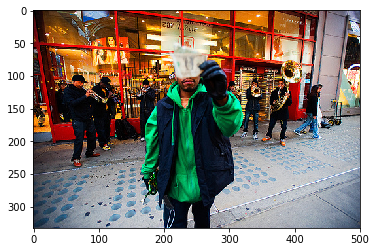

Epoch:  16 , index:  1146  loss:  1.862  | running avg loss:  2.855
Original caption: 
a little dog is attempting to catch a red ball .
a small black and brown long haired dog prepares to catch a red ball in the grass .
a small dog is about to catch a red ball while in the grass .
a small dog tries to catch a red ball .
dog catching red ball in a field .

Greedy caption: a dog is running in the grass

Beam caption:
a black dogs playing with a [ -5.407270431518555 ]
a black dogs are playing in [ -5.436651408672333 ]
a black dogs playing in the [ -5.46502023935318 ]


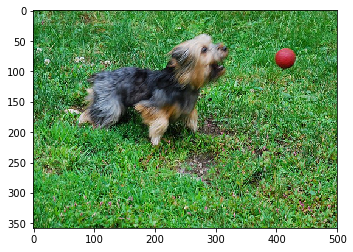

Epoch:  16 , index:  2764  loss:  2.763  | running avg loss:  2.854
Original caption: 
a man putting a little boy wearing orange into a child swing .
a young child being placed into a child swing by another adult
heavyset man taking child out of swing set .
parent holding up a child over a swing
the adult is helping the child into the swing .

Greedy caption: a young girl in a pink shirt is swinging on a swing

Beam caption:
a young girl is swinging on a swing [ -8.487050652503967 ]
a young girl is playing on a swing [ -8.698469758033752 ]
a young girl is playing with a swing [ -9.143756568431854 ]


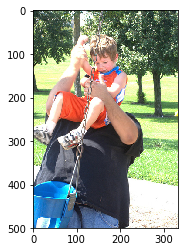

Epoch:  16 , index:  2863  loss:  1.861  | running avg loss:  2.853
Original caption: 
a group of adults gather for a picture in front of a brick house .
a group of people are posing for a picture .
a large group of people posing together outside of a house .
a large group portrate outside of a small office building .
a medium sized group of people pose in front of the camera .

Greedy caption: a group of people are standing in front of a building

Beam caption:
a group of people pose for a [ -5.523124933242798 ]
a group of people in front of [ -5.722024202346802 ]
a group of people are posing for [ -5.987967491149902 ]


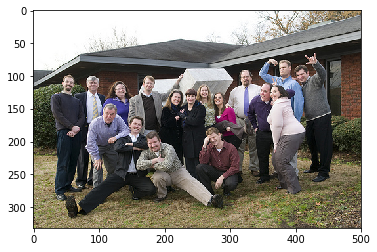

Epoch:  16 , index:  3233  loss:  3.706  | running avg loss:  2.853
Original caption: 
a man in a bathing suit stands near a yellow kayak .
a man in swimming trunks walking down to his belongings that are piled on a yellow canoe .
a man in swimming trunks walking toward bright yellow and orange kayaks .
a shirtless man walks toward a yellow kayak .
man prepares to take a kayak ride .

Greedy caption: a man in a yellow shirt is jumping into a lake

Beam caption:
a man in the side of a [ -6.6353830099105835 ]
a man in a rock climbing a [ -6.949266731739044 ]
a man in a surfboard near a [ -7.826309978961945 ]


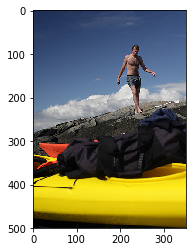

Epoch:  16 , index:  3261  loss:  3.069  | running avg loss:  2.853
Original caption: 
two people are on a very small boat on the water with big trees in the background .
two people are riding in a canoe near a forest .
two people are rowing a canoe through the water .
two people in a boat paddle their way past large trees .
two people row a boat .

Greedy caption: a man in a yellow kayak paddling through rough waters

Beam caption:
a man in a canoe in the water [ -6.5557639598846436 ]
a man with a canoe in the water [ -7.156728029251099 ]
a man in a canoe in the middle [ -7.731297731399536 ]


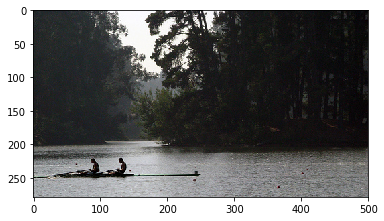

Epoch:  16 , index:  3274  loss:  1.694  | running avg loss:  2.853
Original caption: 
a girl is feeding a camel
a little girl feeds a
a little girl in a purple t-shirt feeds an animal .
a young girl feeding a camel .
the girl is at a petting zoo and feeding a camel .

Greedy caption: a girl is eating a peach

Beam caption:
a little girl is playing with her hand [ -9.405842542648315 ]
a young girl is playing with her hand [ -9.407576322555542 ]
a little girl in a violin in the [ -9.796026706695557 ]


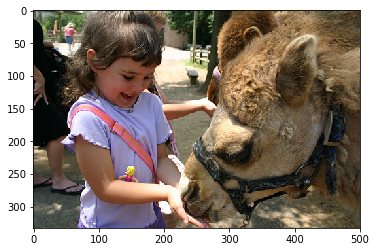

Epoch:  16 , index:  3443  loss:  1.848  | running avg loss:  2.853
Original caption: 
a dark man wearing sunglasses and a black leather jacket is passing by a window .
a man is looking down .
a man wearing a leather coat and a white shirt .
black man in sunglasses and leather jacket staring downward .
man in sunglasses and leather jacket looking down

Greedy caption: a man in a black jacket and tie is standing in front of a brick

Beam caption:
a man in front of a [ -4.441008687019348 ]
a woman in front of a [ -5.614919662475586 ]
a man in front of an [ -6.565474629402161 ]


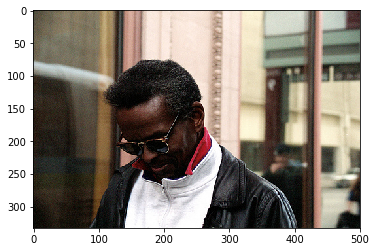

Epoch:  16 , index:  4224  loss:  4.03  | running avg loss:  2.853
Original caption: 
a strange piece of art with lights .
onlookers view picture with wires and lights .
the two people are viewing an artist 's piece .
the two people gazed at the unique pictures on the wall .
two people looking at a light exhibit of some sort .

Greedy caption: a man and a woman sit on a bench

Beam caption:
a man is sitting on a game at [ -7.4351770877838135 ]
a man is sitting on a game on [ -7.604287385940552 ]
a man is sitting on at a bench [ -7.998091697692871 ]


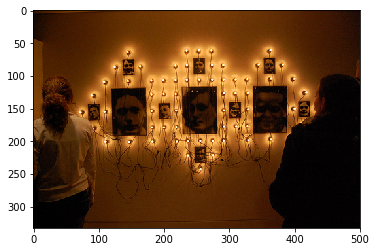

Epoch:  16 , index:  4261  loss:  1.682  | running avg loss:  2.853
Original caption: 
a black , white , and brown dog is playing with a green and pink ball on sand .
a dog is in the sand with a pink and green tennis ball in his mouth .
a little dog plays with a colorful ball in the sand .
a small terrier plays with a tennis ball on the beach .
the white dog , with dark patches , is playing in the sand with a tennis ball in its mouth .

Greedy caption: a small dog is running through the grass

Beam caption:
a small black and white dog [ -5.07182502746582 ]
a black and a black dog [ -5.418325424194336 ]
a black and a white dog [ -5.521435260772705 ]


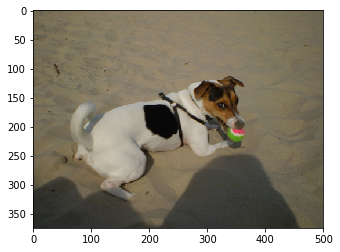

Epoch:  16 , index:  4697  loss:  3.734  | running avg loss:  2.852
Original caption: 
a skateboarder in flannel rides his skateboard to the top of a ramp .
a young man does a trick on his skateboard on a slope .
a young man does skateboard tricks on a ramp .
the skateboarder gets to the top of the ramp .
the skateboarder rides the pipe wall at a skater park .

Greedy caption: a man in a red shirt skateboarding

Beam caption:
a man is jumping over the [ -5.814528942108154 ]
a skateboarder is jumping over the [ -5.864421367645264 ]
a man in a trick in [ -5.952379465103149 ]


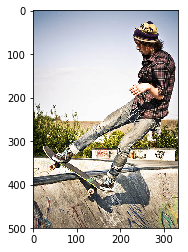

Epoch:  16 , index:  4872  loss:  1.978  | running avg loss:  2.852
Original caption: 
a man holding a sign with people walking around in the background .
a man in an old suit holding up a protest sign in a crowd of people .
a man stands by an animal rights sign at an outdoor event .
a man stands near a crowd holding a protest sign .
man with tan cap , suit jacket and plaid shirt behind a picture in an outdoor scene with other people in the background .

Greedy caption: a man in a black shirt and sunglasses is standing in front of a store

Beam caption:
a man in front of a table [ -6.791218400001526 ]
a man wearing a table of a [ -7.377918243408203 ]
a man wearing a table in a [ -7.6743693351745605 ]


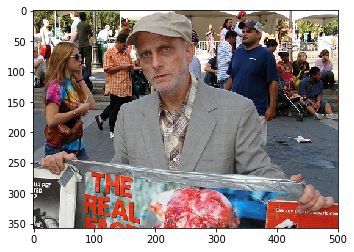

Epoch:  16 , index:  5120  loss:  2.422  | running avg loss:  2.852
Original caption: 
a dog runs over a stick in the leaves .
a small white dog is jumping over a branch on the ground covered with leaves .
a small white dog leaps over a root in the woods .
a white dog jumps over a log .
a white dog running in the fallen leaves .

Greedy caption: a dog is running through the woods

Beam caption:
a white dog is running through a grassy field [ -7.869781732559204 ]
a white dog is jumping over a grassy field [ -8.693058133125305 ]
a white and brown dog is in the snow [ -8.75418996810913 ]


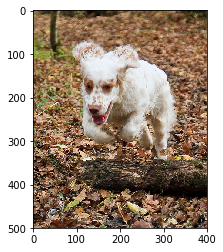

Epoch:  16 , index:  5474  loss:  2.718  | running avg loss:  2.852
Original caption: 
a girl in purple pants running with two dogs .
a girl is running through a field with a brown dog and white dog running beside her .
a girl running outside with three dogs
a girl runs with dogs in a dry field .
girl running through a field with a brown dog and a white dog .

Greedy caption: a dog runs through the grass

Beam caption:
a dog are playing in a [ -6.589982032775879 ]
a black dogs are playing in [ -6.684606075286865 ]
two dogs are playing in a [ -6.712541103363037 ]


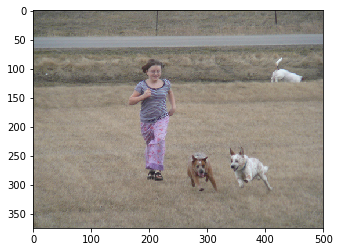

Epoch:  16 , index:  5639  loss:  4.206  | running avg loss:  2.852
Original caption: 
a horse mascot gives high fives to some football fans .
a horse mascot stands in front of several kids .
a mascot at a sporting event waves to the crowd .
a team mascot raising its hands toward people .
oklahoma horse mascot in a sea of red fans

Greedy caption: a man in a blue shirt is holding a sign

Beam caption:
a man in a roller of a [ -7.177563846111298 ]
a man is riding horses at a [ -7.902721881866455 ]
a man is riding horses in a [ -8.07602834701538 ]


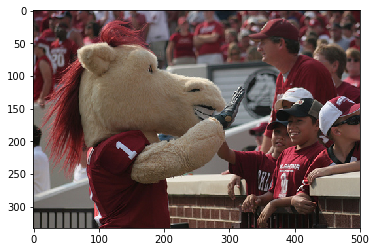

Epoch:  16 , index:  5748  loss:  2.315  | running avg loss:  2.852
Original caption: 
a black dog carries a bird in its mouth as it jumps over a fence .
a black dog jumping a wire fence with a dead bird in his mouth .
a dog , holding a bird in its mouth , jumping a fence .
a dog trying to jump a wire fence with something in his mouth .
the black dog is jumping over a fence with a bird in its mouth .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown dog chases another dog on the grass [ -8.306770205497742 ]
a brown dog is running through the grass with [ -9.00714898109436 ]
a brown dog chases another dog in the grass [ -9.011116027832031 ]


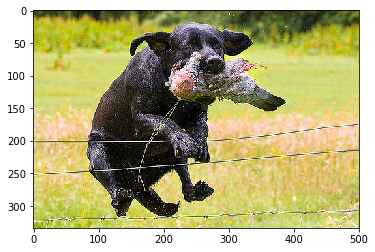

Epoch:  16 , index:  5870  loss:  1.981  | running avg loss:  2.852
Original caption: 
a girl in black is starring off into the distance .
a woman in a black coat with a camera on a tripod
a woman leans against the wall while a camera operates next to her .
a woman stands against a wall near a video camera .
a woman stands behind a video camera .

Greedy caption: a man wearing a white shirt and sunglasses is holding a sign

Beam caption:
a woman wearing a brown and [ -7.467851519584656 ]
a man wearing a brown and [ -7.570219993591309 ]
a woman wearing a camera in [ -7.608244299888611 ]


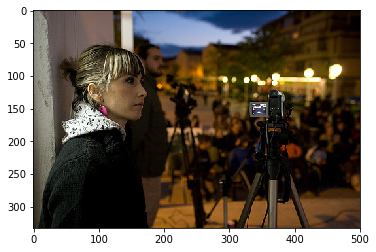

Epoch:  16 , index:  5877  loss:  3.929  | running avg loss:  2.852
Original caption: 
a black and tan doberman dog is jumping through some water .
a dog jumping through the water at a lake
black dog with black and tan face running through water .
doberman leaping through the water .
the doberman pincer is leaping through the water .

Greedy caption: a dog is running through the snow

Beam caption:
a black dogs play in the [ -4.732468605041504 ]
a brown dogs play in the [ -4.823037147521973 ]
a dog playing in the snow [ -5.254002571105957 ]


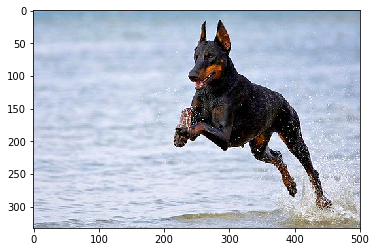




==== EPOCH DONE. === 



Epoch:  17 , index:  1761  loss:  3.123  | running avg loss:  2.85
Original caption: 
a large crowd in heavy clothing is posing for a camera .
large group of people walking
the people are standing in front of a building .
there is a crowd of people of men , women and children .
two men , a woman , and two young boys stand in front of a large gathering of people outside a building .

Greedy caption: a man in a red jacket and sunglasses is standing in front of a crowd

Beam caption:
a group of the middle of a [ -7.228623390197754 ]
a group of people pose for a [ -7.7844789028167725 ]
a group of the middle of the [ -7.851987838745117 ]


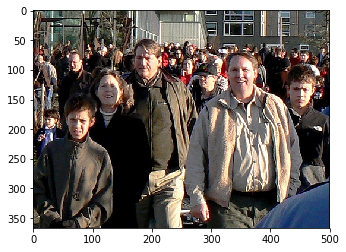

Epoch:  17 , index:  1799  loss:  3.44  | running avg loss:  2.85
Original caption: 
a man in a red coat skiing .
a man in red is skiing down a snow slope .
a man wearing a red coat is skiing in the snow .
a skier outfitted in red on a snow-covered mountain .
a snow skier in a red top and black pants moving down a hill .

Greedy caption: a man in a red jacket is snowboarding

Beam caption:
a man in the middle of [ -6.48252534866333 ]
a man is skiing down a [ -6.645415544509888 ]
a man is doing a flip [ -6.672895431518555 ]


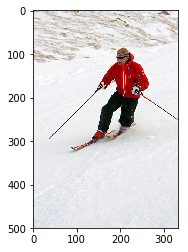

Epoch:  17 , index:  2502  loss:  2.007  | running avg loss:  2.85
Original caption: 
a pregnant protester holding up a pro-america sign .
a protesting woman is holding a poster .
a woman in a black and white dress is holding up a protest sign .
a woman wearing a black and white dress is holding a large sign .
woman in sleeveless black and white print top holding up a sign .

Greedy caption: a man in a red jacket and sunglasses is standing in front of a brick

Beam caption:
a group of people are walking down the [ -8.762265801429749 ]
a man and woman are walking down the [ -8.908290386199951 ]
a group of people are in the street [ -8.920760989189148 ]


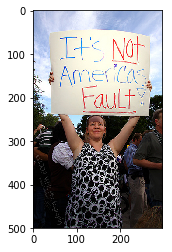

Epoch:  17 , index:  2641  loss:  1.115  | running avg loss:  2.849
Original caption: 
a man surfing in the ocean .
a surfer catches a wave and tries to hold on as the surf collapses around him .
a surfer is riding a surfboard on top of a breaking wave .
a surfer is riding a wave in a large body of water .
a surfer on a wave .

Greedy caption: a man is wakeboarding in the ocean

Beam caption:
a man is wakeboarding in the [ -5.278857707977295 ]
a man is wakeboarding on a [ -5.834826946258545 ]
a surfer is wakeboarding in the [ -5.850395202636719 ]


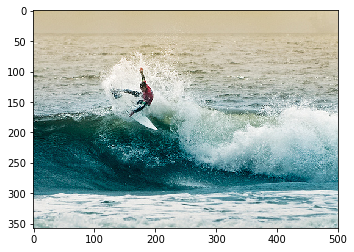

Epoch:  17 , index:  2680  loss:  3.078  | running avg loss:  2.849
Original caption: 
a man dressed in all white is talking to the people seated on the dirt floor .
a man in a long white robe and white head cap is pointing to a group of people sitting on a blanket .
a man in a white robe stands and talks to people who are sitting .
a man wearing a long white robe and a white cap , stands over a group of seated people .
the children are sitting with their shoes off .

Greedy caption: a group of children playing in a soccer game

Beam caption:
a group of children playing in a picture of [ -9.524084448814392 ]
a group of children playing in a picture in [ -9.63586699962616 ]
a group of children play in a picture of [ -9.798207640647888 ]


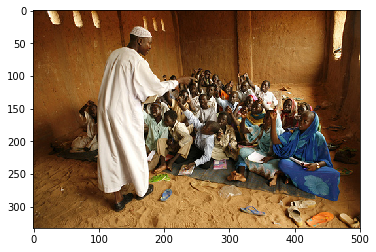

Epoch:  17 , index:  3076  loss:  2.173  | running avg loss:  2.849
Original caption: 
a black and brown dog attempts to catch a red ball in its mouth .
a brown and black dog approaching a red ball .
a brown and black dog is trying to catch a red ball in its mouth .
a dog with mouth open to catch the red ball .
a tan and black dog opens its mouth for a red ball .

Greedy caption: a brown dog is running through the grass

Beam caption:
a brown dogs are playing [ -4.162259101867676 ]
a brown dogs playing in [ -4.500411510467529 ]
a brown dogs playing with [ -4.846951961517334 ]


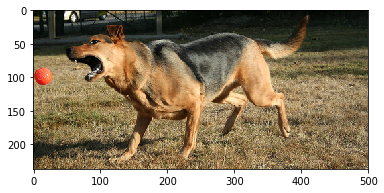

Epoch:  17 , index:  3109  loss:  2.905  | running avg loss:  2.849
Original caption: 
a few men sprint across the grass in competition with one another .
a man in a grey shirt is winning a race in the grass .
a man leads the way in a race .
people running a race and the guy in grey is in the lead .
two men running outside in a competition .

Greedy caption: a soccer player in a blue uniform kicking the ball

Beam caption:
a soccer players playing soccer game [ -5.140277862548828 ]
two young boys playing soccer game [ -5.480246543884277 ]
two soccer players playing soccer game [ -5.536196708679199 ]


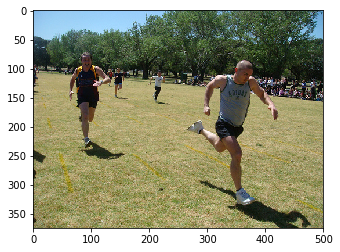

Epoch:  17 , index:  3484  loss:  3.256  | running avg loss:  2.849
Original caption: 
a girl runs past a large model of a heart .
a young girl plays in front of a museum display about the human heart .
the girl is by the display .
the girl wearing a blue shirt is running through a science center .
the little girl enjoys playing in the indoor playground .

Greedy caption: a little girl is playing in a fountain

Beam caption:
a little girl in a violin on a park [ -9.95716780424118 ]
a little girl in a violin in front of [ -9.976756513118744 ]
a little girl in a violin on a gym [ -10.148108899593353 ]


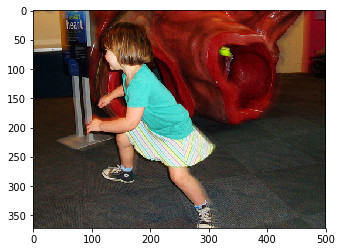

Epoch:  17 , index:  3833  loss:  5.593  | running avg loss:  2.849
Original caption: 
a baseball player is trying to run to a base while the baseman catches the ball .
a softball player runs towards first base while the pitcher attempts to throw her out .
the first baseman makes hte catch just in time to get the runner out in this softball game .
three people play baseball on a field at a park .
three young women are playing softball .

Greedy caption: a baseball player swings on a bat

Beam caption:
a baseball players are playing softball [ -3.8360515832901 ]
a baseball players trying to catch [ -5.161977410316467 ]
a man is playing softball on [ -5.679174184799194 ]


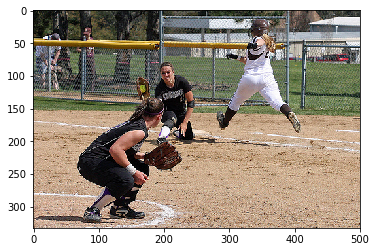

Epoch:  17 , index:  4041  loss:  1.924  | running avg loss:  2.849
Original caption: 
a black dog is running in the grass .
a black poodle is running through the grass .
a small black dog is in the grass .
the black dog is running through the grass .
the black dog is walking through the tall grass .

Greedy caption: a black and white dog is running through the grass

Beam caption:
a black dog are running through the ball [ -7.346768260002136 ]
a black dog are playing in the ball [ -7.563709259033203 ]
a black dog are playing with a black [ -7.720371425151825 ]


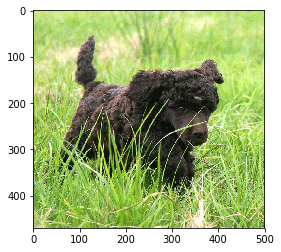

Epoch:  17 , index:  4458  loss:  2.827  | running avg loss:  2.848
Original caption: 
a child in pink holds an object that appears to be on fire .
a child playing with fire .
a little girl in a pink top is spinning a stick that has been set on fire .
child holding an object that is on fire .
little girl holds flaming object at sunset .

Greedy caption: a man in a red shirt is standing in front of a crowd of people

Beam caption:
a group of people are standing at a [ -9.256296396255493 ]
a group of people are playing instruments at [ -9.293773889541626 ]
a man is playing with the guitar at [ -9.345287799835205 ]


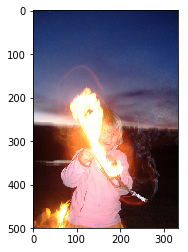

Epoch:  17 , index:  4627  loss:  2.409  | running avg loss:  2.848
Original caption: 
a silhouette of one dog chasing another dog .
a silhouette of two dogs running by a lake .
two dogs are silhouette as they chase each other along the water .
two dogs running on land along the water .
two dogs running on the shore .

Greedy caption: two dogs are running through the grass

Beam caption:
two dogs are playing in the [ -5.517707586288452 ]
two dogs playing with a field [ -5.554247558116913 ]
two dogs are playing in a [ -5.621151685714722 ]


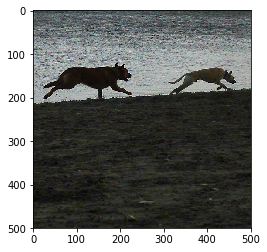

Epoch:  17 , index:  5201  loss:  3.155  | running avg loss:  2.848
Original caption: 
a crowd begins to march in a small downtown setting .
a group of people holding signs and marching through the streets .
a group of people with signs and banners walking down the street
a protest march is crossing the intersection of two streets near to a building with red awnings .
many people hold signs and march down the street .

Greedy caption: a man in a yellow coat and black shorts is standing in front of a

Beam caption:
a man in front of a [ -6.269527554512024 ]
a group of people in the [ -6.832663714885712 ]
a group of people of a [ -6.875917136669159 ]


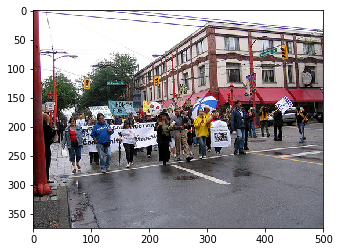

Epoch:  17 , index:  5399  loss:  2.668  | running avg loss:  2.848
Original caption: 
a bride in a white dress is holding a purple bouquet whilst standing next to her groom .
a couple pose on their wedding day .
a man and woman in a dark suit and formal white dress smile for a picture .
a wedding photo of a bride with purple flowers and her groom .
a young couple in wedding outfits poses for a picture .

Greedy caption: a bride and groom are playing with a bride

Beam caption:
a bride in front of a [ -7.060457468032837 ]
a bride in front of the [ -7.603788614273071 ]
two girls are posing for the [ -7.764800190925598 ]


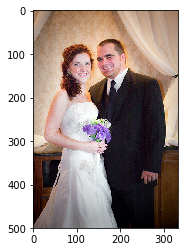

Epoch:  17 , index:  5566  loss:  3.785  | running avg loss:  2.848
Original caption: 
a brown dog is staring closely at a sleeping brown and white dog .
a little dog struggles with a man holding a slipper .
a small brown dog is playing with a fuzzy slipper .
the black and tan dog is on a rug , tugging on a slipper .
the little dog grabs a hold of the bedroom slipper with its mouth .

Greedy caption: a dog is running in the snow

Beam caption:
a brown and brown and brown [ -5.327548027038574 ]
a black and brown and brown [ -5.838927745819092 ]
a dog and a brown dog [ -6.079893589019775 ]


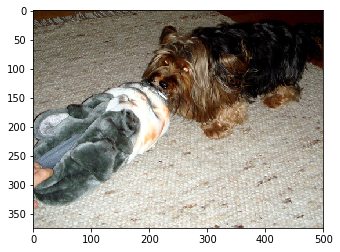

Epoch:  17 , index:  5583  loss:  2.479  | running avg loss:  2.848
Original caption: 
a child is riding on a man 's back .
a man and a boy wrestle inside a house .
a man is giving a little boy a piggy back on the floor .
a man wrestling with a child on the floor .
a young boy playing on another mans back

Greedy caption: a woman in a black shirt is sitting on a bench

Beam caption:
a group of people are sitting in front of [ -10.229383707046509 ]
a group of people are sitting on a chair [ -10.6410813331604 ]
a group of people are sitting on a subway [ -10.652697086334229 ]


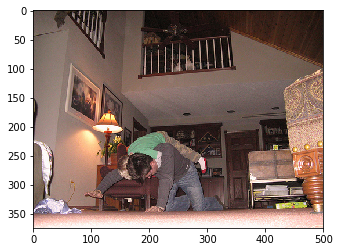




==== EPOCH DONE. === 



Epoch:  18 , index:  863  loss:  4.042  | running avg loss:  2.847
Original caption: 
the woman in yellow is throwing the football to the woman in brown .
two girls playing catch on a lawn
two girls throw a ball back and forth in their backyard .
two girls throwing a football in their backyard .
two women play catch in a yard .

Greedy caption: a boy in a blue shirt and jeans is running through a grassy field

Beam caption:
a group of children play soccer on a [ -9.467741250991821 ]
a group of children playing soccer on a [ -9.523184657096863 ]
a little boys play soccer on a field [ -9.626634120941162 ]


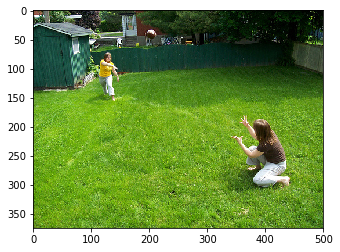

Epoch:  18 , index:  1770  loss:  2.888  | running avg loss:  2.846
Original caption: 
a white duck expanding its wings in the water .
a white duck is spreading its wings while sitting on the water .
a white duck spreads its wings while in the water .
white bird sitting in water spreading its wings
white duck flapping its wings in the water .

Greedy caption: a white bird is flying over a white dog

Beam caption:
a white bird on a bird in [ -6.179247677326202 ]
a white bird over a bird in [ -6.545187175273895 ]
a white and a white object in [ -6.721137762069702 ]


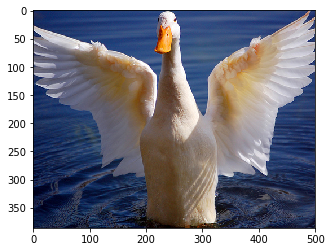

Epoch:  18 , index:  2380  loss:  1.697  | running avg loss:  2.846
Original caption: 
a brown dog and a black dog are playing with a red frisbee .
a lack dog and a brown and white dog run on a gravel surface with something red underfoot .
a large black dog in the dirt with a small brown dog .
a large brown dog and a larger black dog playing together with a ball .
two dogs are chasing a ball .

Greedy caption: a dog running in the grass

Beam caption:
a dog is running in a [ -5.02828985452652 ]
a dog is running in the [ -5.611192464828491 ]
a dog is running through a [ -5.765639066696167 ]


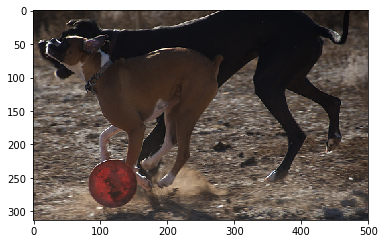

Epoch:  18 , index:  3259  loss:  4.324  | running avg loss:  2.845
Original caption: 
a football player is in action among other players .
a football player points .
an african-american football player , wearing jersey number 12 for the university of oklahoma , throws a football to his left .
on a football field , there is a played in a red jersey and the crowd is behind him .
several football players in a stadium

Greedy caption: a football player in a red jersey runs with the ball

Beam caption:
a football player in front of a [ -5.606446206569672 ]
a football player in a field of [ -5.730239987373352 ]
a football player in the field of [ -6.336495757102966 ]


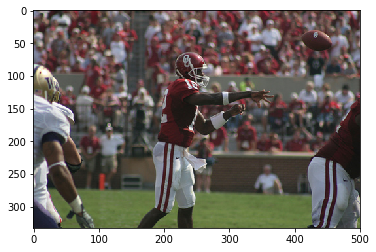

Epoch:  18 , index:  3391  loss:  3.758  | running avg loss:  2.846
Original caption: 
a group of people dressed as zombies .
a large group of people with facepaint on gather outside .
everybody is dressed as a zombie at this party .
many people have painted faces at night .
people dressed up in zombie costumes are standing around .

Greedy caption: a group of people are gathered together

Beam caption:
a group of people are gathered [ -5.048578441143036 ]
a group of people are standing [ -5.495856940746307 ]
a group of people are looking [ -5.552215278148651 ]


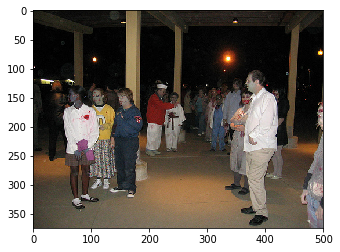

Epoch:  18 , index:  3591  loss:  1.239  | running avg loss:  2.846
Original caption: 
a black dog swimming through a river .
a black dog swims through the water .
black dog swimming in water .
the black dog gets soaked as it plays in the water .
the dog is swimming in the water .

Greedy caption: a black dog is swimming in the water

Beam caption:
a black dog is running through [ -3.847701072692871 ]
a black dog is swimming in [ -4.11931037902832 ]
a black and white dog is [ -4.372163772583008 ]


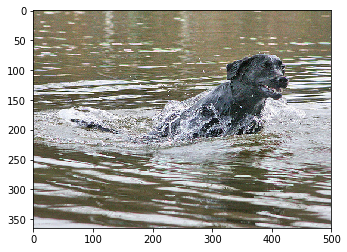

Epoch:  18 , index:  3633  loss:  3.777  | running avg loss:  2.845
Original caption: 
a photographer is holding his camera next to an orange barrier beside water .
a photographer is kneeling in front of a railing that is protects falling into water .
a photographer kneels down next to the edge of a dock with his camera .
a smiling photographer
the crouching man is holding a large camera .

Greedy caption: a man is rock climbing

Beam caption:
a man in the side of [ -4.683532476425171 ]
a man sits on a rock [ -5.9699254631996155 ]
a man sits on a red [ -6.608756124973297 ]


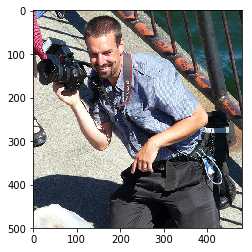

Epoch:  18 , index:  5511  loss:  2.22  | running avg loss:  2.844
Original caption: 
a man and his dog in the mountains .
a man and his dog on the top of a mountain .
a man holding a camera is sitting on a mountain with a black dog .
a man poses with his black dog at the top of a mountain .
a man with a dog .

Greedy caption: a man is standing on a cliff overlooking a valley

Beam caption:
a man in the snow covered in front of [ -8.89014482498169 ]
a man in the snow covered in the mountains [ -10.65595006942749 ]
a man in the snow covered in a trail [ -10.796803593635559 ]


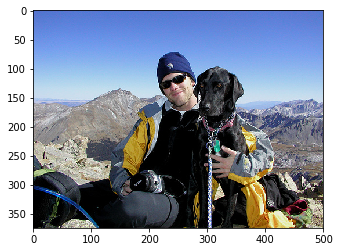

Epoch:  18 , index:  5533  loss:  2.445  | running avg loss:  2.844
Original caption: 
a climber is climbing a rock face above a mattress that is lying on the ground below .
a man climbs a rock .
a man is climbing a rocky mountain .
a man is on his back in a rocky cave .
a man with a dark brown shirt is climbing up a rocky elevation .

Greedy caption: a man is rock climbing

Beam caption:
a man climbing up a rock [ -5.09288378059864 ]
a man wearing a rock wall [ -5.385253727436066 ]
a man is climbing a rock [ -5.555878162384033 ]


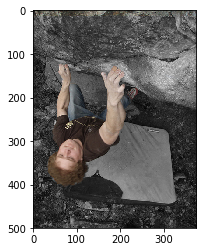

Epoch:  18 , index:  5840  loss:  2.775  | running avg loss:  2.844
Original caption: 
a girl in a purple tutu dances in the yard .
a little girl in a puffy purple skirt dances in a park .
a young girl twirls her fluffy purple skirt .
little girl is spinning around on the grass in a flowing purple skirt .
the little girl has a purple dress on .

Greedy caption: a boy in a red shirt is playing with a white and white bat

Beam caption:
a little girl is sitting on a grassy area [ -8.890529870986938 ]
a little girl is playing in a grassy area [ -8.895904660224915 ]
a little girl in front of a grassy area [ -9.065039157867432 ]


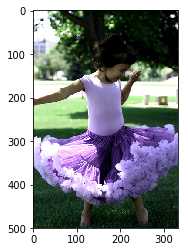




==== EPOCH DONE. === 



Epoch:  19 , index:  28  loss:  3.094  | running avg loss:  2.844
Original caption: 
a woman stands in front of a display case and another woman looks at a digital camera
a woman stands tall in front of a glass display while another woman takes a picture of something .
a woman stands with her arms out at her sides while another takes a picture .
a woman stands with her arms out in a store while another woman holds a camera .
one woman is taking a picture and another woman is standing sideways with her arm out .

Greedy caption: a man in a red shirt and tie is standing in front of a store

Beam caption:
a group of people are standing in front of [ -8.6567924618721 ]
a man is standing in front of a store [ -8.682267546653748 ]
a group of people in front of a store [ -8.738061010837555 ]


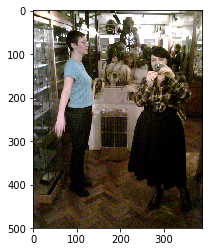

Epoch:  19 , index:  94  loss:  4.919  | running avg loss:  2.844
Original caption: 
a lady and her little girl are holding hands and walking up the sidewalk .
a mother and child run hand in hand through chinatown in an american city .
a woman and a child both wearing red outfits walking up a street
child in red holding the hand of person in red coat walking on sidewalk under awnings .
woman and little girl wearing red in asian area

Greedy caption: a man in a red shirt walks down the street

Beam caption:
a group of people on a woman in [ -9.297828793525696 ]
a group of people in a woman in [ -9.40521490573883 ]
a group of people outside of a building [ -10.05130136013031 ]


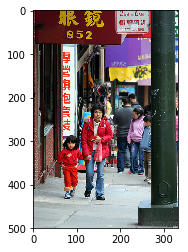

Epoch:  19 , index:  1397  loss:  3.152  | running avg loss:  2.843
Original caption: 
two girls take in the view .
two woman stand on a building ledge and look down on a city .
two women are standing next to a railing overlooking a city .
two women look out at many houses below .
two young girls look out to a town below them .

Greedy caption: a man and a woman sit on a bench

Beam caption:
a group of the middle of a building [ -9.520917393267155 ]
a group of the middle of the street [ -10.225556828081608 ]
a group of the middle of the water [ -10.328108288347721 ]


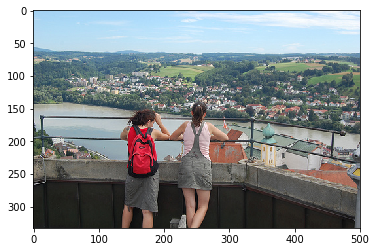

Epoch:  19 , index:  3039  loss:  3.042  | running avg loss:  2.842
Original caption: 
two furry light brown dogs lying on a hardwood floor .
two terriers play on the wood floor of their home .
two white dogs are laying in the doorway of a wooden floored apartment .
two white dogs playing in the house near a computer monitor .
two white , long haired dog are in a hallway on a wooden floor .

Greedy caption: a dog is running through a field

Beam caption:
a black and white dog is jumping over [ -6.498447060585022 ]
a black and white dog is playing with [ -6.693887710571289 ]
a black and white dog is jumping up [ -6.695240378379822 ]


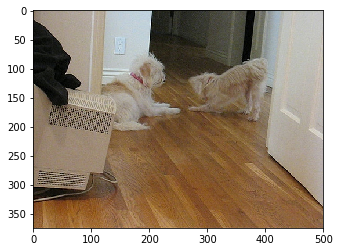

Epoch:  19 , index:  3360  loss:  1.809  | running avg loss:  2.842
Original caption: 
two boys fight for the ball .
two field hockey players fight for the ball .
two hockey players are trying to shoot the puck on the grass .
two opposing male players are chasing the ball in field hockey .
two teenagers participate in a game of field hockey .

Greedy caption: a boy in a blue shirt is playing soccer

Beam caption:
a young boys playing with a field [ -6.798696041107178 ]
two boys playing soccer on a field [ -7.485912561416626 ]
two boys playing soccer on the grass [ -7.791150808334351 ]


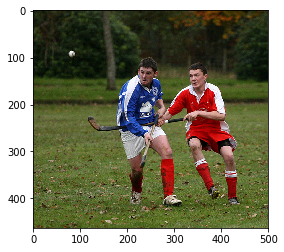

Epoch:  19 , index:  3602  loss:  4.643  | running avg loss:  2.842
Original caption: 
a bmx racer comes down a hill ; everything around him is a blur
a dirt biker rides down a trail .
a man in blue is riding a bicycle on a track .
a mountain biker is giong down a hill on his bike .
a mountain biker on a blue mountain bike gets air time .

Greedy caption: a man in a red shirt is riding a bike on a dirt trail

Beam caption:
a man is doing a bike on [ -7.039193630218506 ]
a mountain biker riding his bike on [ -7.305473327636719 ]
a man is doing a bike in [ -7.522949695587158 ]


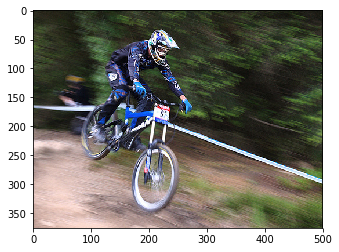

Epoch:  19 , index:  3941  loss:  3.492  | running avg loss:  2.842
Original caption: 
a boy in shorts kneeling on a tile courtyard , arms outstreached .
a boy with a short haircut and a blue shirt gestures happily to someone out of frame .
a child kneels and raises his arms .
a little boy is posing on a stone wall outside .
a small boy is kneeling on a step with his hands in the air .

Greedy caption: a little girl in a pink dress is walking on a sidewalk

Beam caption:
a little girl in a puddle in front [ -9.576535701751709 ]
a little girl in a puddle on the [ -9.69217586517334 ]
a little girl in a puddle on a [ -9.91693902015686 ]


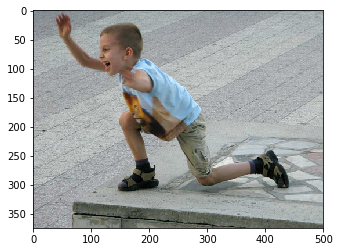

Epoch:  19 , index:  5367  loss:  1.894  | running avg loss:  2.841
Original caption: 
a boy rides his ripstik on the street .
a boy with a helmet skateboards across the street .
a child in a blue jacket and helmet is on a skateboard .
a young boy wearing a helmet skateboards on the street .
there is a boy with a helmet and a stripe down the side of his pants riding on a skateboard .

Greedy caption: a boy in a red shirt and jeans skateboards

Beam caption:
a young boys are walking on a [ -7.354052305221558 ]
a young boys are running on a [ -7.413838863372803 ]
a young boys running on a game [ -7.512596607208252 ]


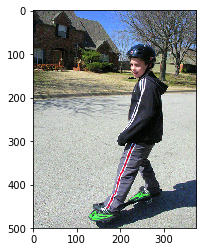

Epoch:  19 , index:  5555  loss:  2.504  | running avg loss:  2.841
Original caption: 
a boy in a harness climbs a rock wall .
a small boy hangs from a safety harness next to a climbing wall .
a young boy on a harness climbs up a boulder .
the boy is climbing a white rock wall .
the small child climbs a white rock wall .

Greedy caption: a man is climbing a rock wall

Beam caption:
a man is standing in front of a rock [ -7.71963357925415 ]
a man is standing in front of a hill [ -8.626578330993652 ]
a man is standing in front of a grassy [ -9.040489196777344 ]


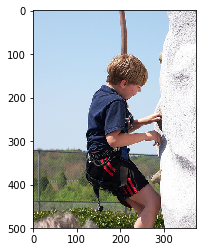




==== EPOCH DONE. === 





In [37]:
epochs = 20

inception.eval()
net.train()

loss_so_far = 0.0

total_samples = len(f.training_data)

for epoch in range(epochs):
    
    for (image_tensor, tokens, _, index) in f.return_train_batch():
    
        o.zero_grad()
        net.zero_grad()



        words = []

        loss=0.


        input_token = f.w2i[STARTWORD]
        input_tensor = torch.tensor(input_token)


        for token in tokens:

            if(input_token==f.w2i[STARTWORD]):
                out, hidden=net(input_tensor, image_tensor, process_image=True)
            else:
                out, hidden=net(input_tensor, hidden)


            class_label = torch.tensor(token).view(1)

            input_token = token
            input_tensor = torch.tensor(input_token)


            out = out.squeeze().view(1,-1)

            loss += l(out,class_label)


        loss = loss/len(tokens)

        loss.backward()
        o.step()

        loss_so_far += loss.detach().item()

        if(np.random.rand()<0.002): #5% of cases
            print("Epoch: ",epoch, ", index: ", index," loss: ",round(loss.detach().item(),3)," | running avg loss: ", round(loss_so_far/((epoch*total_samples)+(index+1)),3))

            torch.save(net.state_dict(), 'models/running_save_v6.pth')
            torch.save(net.state_dict(), 'models/running_inception_save_v6.pth')

            net.eval()
           
            #test dataset
            #random_train_index = np.random.randint(len(f.training_data))
            random_train_index = index
            train_filename = IMAGE_DIR+f.training_data[random_train_index]['filename']
            print("Original caption: ")
            [print(x['raw'].lower()) for x in f.training_data[random_train_index]['sentences']]
            print("")
            print("Greedy caption:", f.caption_image_greedy(net,train_filename))
            print("")
            print("Beam caption:")
            f.print_beam_caption(net, train_filename, 3)
            #IPython.display.Image(filename=test_filename) 
            pil_im = Image.open(train_filename, 'r')
            plt.figure()
            plt.imshow(np.asarray(pil_im))
            plt.show()
            net.train()
    
    print("\n\n")
    print("==== EPOCH DONE. === ")
    print("\n\n")

## Save the network

In [38]:
torch.save(net.state_dict(), 'models/epochs_40_loss_2_841_v6.pth')
torch.save(inception.state_dict(), 'models/inception_epochs_40.pth')

## Helper functions for visualizations

In [54]:
def rand_cmap(nlabels, type='bright', first_color_black=True, last_color_black=False, verbose=True):
    """
    Creates a random colormap to be used together with matplotlib. Useful for segmentation tasks
    :param nlabels: Number of labels (size of colormap)
    :param type: 'bright' for strong colors, 'soft' for pastel colors
    :param first_color_black: Option to use first color as black, True or False
    :param last_color_black: Option to use last color as black, True or False
    :param verbose: Prints the number of labels and shows the colormap. True or False
    :return: colormap for matplotlib
    """
    from matplotlib.colors import LinearSegmentedColormap
    import colorsys
    import numpy as np


    if type not in ('bright', 'soft'):
        print ('Please choose "bright" or "soft" for type')
        return

    if verbose:
        print('Number of labels: ' + str(nlabels))

    # Generate color map for bright colors, based on hsv
    if type == 'bright':
        randHSVcolors = [(np.random.uniform(low=0.0, high=1),
                          np.random.uniform(low=0.2, high=1),
                          np.random.uniform(low=0.9, high=1)) for i in range(nlabels)]

        # Convert HSV list to RGB
        randRGBcolors = []
        for HSVcolor in randHSVcolors:
            randRGBcolors.append(colorsys.hsv_to_rgb(HSVcolor[0], HSVcolor[1], HSVcolor[2]))

        if first_color_black:
            randRGBcolors[0] = [0, 0, 0]

        if last_color_black:
            randRGBcolors[-1] = [0, 0, 0]

        random_colormap = LinearSegmentedColormap.from_list('new_map', randRGBcolors, N=nlabels)

    # Generate soft pastel colors, by limiting the RGB spectrum
    if type == 'soft':
        low = 0.6
        high = 0.95
        randRGBcolors = [(np.random.uniform(low=low, high=high),
                          np.random.uniform(low=low, high=high),
                          np.random.uniform(low=low, high=high)) for i in xrange(nlabels)]

        if first_color_black:
            randRGBcolors[0] = [0, 0, 0]

        if last_color_black:
            randRGBcolors[-1] = [0, 0, 0]
        random_colormap = LinearSegmentedColormap.from_list('new_map', randRGBcolors, N=nlabels)

    # Display colorbar
    if verbose:
        from matplotlib import colors, colorbar
        from matplotlib import pyplot as plt
        fig, ax = plt.subplots(1, 1, figsize=(15, 0.5))

        bounds = np.linspace(0, nlabels, nlabels + 1)
        norm = colors.BoundaryNorm(bounds, nlabels)

        cb = colorbar.ColorbarBase(ax, cmap=random_colormap, norm=norm, spacing='proportional', ticks=None,
                                   boundaries=bounds, format='%1i', orientation=u'horizontal')

    return random_colormap

## Start visualizations (First of word embeddings)

In [217]:

frequency_threshold = 50 #the word should have appeared at least this many times for us to visualize

all_word_embeddings = []
all_words = []

for word in f.word_frequency.keys():
    if(f.word_frequency[word]>=frequency_threshold):
        all_word_embeddings.append(net.input_embedding(torch.tensor(f.w2i[word])).detach().numpy())
        all_words.append(word)

In [119]:
len(all_words)

701

In [120]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)

In [121]:
X_2d = tsne.fit_transform(all_word_embeddings)

In [122]:
new_cmap = rand_cmap(10, type='bright', first_color_black=True, last_color_black=False, verbose=True)

Number of labels: 10


/Users/paraschopra/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


FigureCanvasNbAgg()

In [128]:
fig,ax = plt.subplots(figsize=(7, 7))
    
sc = plt.scatter(X_2d[:,0], X_2d[:,1])
#plt.legend()
#plt.show()

annot = ax.annotate("", xy=(0,0), xytext=(20,20),textcoords="offset points",
                    bbox=dict(boxstyle="round", fc="w"),
                    arrowprops=dict(arrowstyle="->", color='red'))
annot.set_visible(False)

def update_annot(ind):

    pos = sc.get_offsets()[ind["ind"][0]]
    annot.xy = pos
    text = "{}".format(" ".join([all_words[n] for n in ind["ind"]]))
    annot.set_text(text)
    annot.get_bbox_patch().set_facecolor('white')
    annot.get_bbox_patch().set_alpha(0.9)


def hover(event):
    
    vis = annot.get_visible()
    if event.inaxes == ax:
        cont, ind = sc.contains(event)
        if cont:
            
            
            update_annot(ind)
            
            annot.set_visible(True)
            fig.canvas.draw_idle()
        else:
            
            if vis:
                annot.set_visible(False)
                fig.canvas.draw_idle()
                
def onpick(event):
    ind = event.ind
    print(ind)
    label_pos_x = event.mouseevent.xdata
    label_pos_y = event.mouseevent.ydata
    annot.xy = (label_pos_x,label_pos_y)
    annot.set_text(y[ind])
    ax.figure.canvas.draw_idle()
    
    

fig.canvas.mpl_connect("motion_notify_event", hover)

#fig.canvas.mpl_connect('pick_event', onpick)

plt.show()

/Users/paraschopra/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


FigureCanvasNbAgg()

## find top 5 closest words due to similarity

In [426]:
from scipy import spatial
def return_cosine_sorted(target_word_embedding):
    
    words = []
    cosines = []
    
    for i in range(len(all_word_embeddings)):
        cosines.append(1 - spatial.distance.cosine(target_word_embedding, all_word_embeddings[i]))
        
    sorted_indexes = np.argsort(cosines)[::-1]
    
    return np.vstack((np.array(all_words)[sorted_indexes], np.array(cosines)[sorted_indexes])).T

In [146]:
all_words[10]

'chasing'

In [425]:
def return_similar_words(word, top_n=5):
    
    return return_cosine_sorted(return_embedding(word))[1:top_n+1]
    

In [424]:
def return_embedding(word):
    if(word in all_words):
        target_embedding_index = [i for i, s in enumerate(all_words) if word in s][0]
        return all_word_embeddings[target_embedding_index]
    else:
        return None

In [203]:
def return_analogy(source_word_1, source_word_2, target_word_1, top_n=5):
    
    em_sw_1 = return_embedding(source_word_1)
    em_sw_2 = return_embedding(source_word_2)
    em_tw_1 = return_embedding(target_word_1)
    
    if((em_sw_1 is None) | (em_sw_2 is None) | (em_tw_1 is None)):
        return 0
    
    target_embedding = em_tw_1 + (em_sw_2 - em_sw_1)
    return return_cosine_sorted(target_embedding)[1:top_n+1]
  

In [428]:
return_similar_words('boy')

array([['rider', '0.20609606802463531'],
       ['kids', '0.197774738073349'],
       ['kid', '0.16871631145477295'],
       ['shirts', '0.16610540449619293'],
       ['toddler', '0.165279820561409']], dtype='<U32')

In [233]:
return_analogy('green', 'grass', 'red')

array([['red', '0.5263711214065552'],
       ['be', '0.16292186081409454'],
       ['sandy', '0.157870814204216'],
       ['golden', '0.1550290733575821'],
       ['kissing', '0.1444557011127472']], dtype='<U32')

## embedding of images (visualize)

In [269]:
def cart2pol(x, y):
    rho = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return(rho, phi)

def pol2cart(rho, phi):
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return(x, y)

In [242]:
import itertools
all_image_embeddings = []
all_image_filenames = []

for i in range(len(f.training_data)):
    all_image_embeddings.append(inception(f.image_to_tensor('Flicker8k_Dataset/'+f.training_data[i]['filename'])).detach().numpy())
    all_image_filenames.append(f.training_data[i]['filename'])

KeyboardInterrupt: 

In [279]:
all_image_embeddings_temp = all_image_embeddings[:]
all_image_filenames_temp = all_image_filenames[:]

In [280]:
from matplotlib.offsetbox import (TextArea, DrawingArea, OffsetImage,
                                  AnnotationBbox)

In [281]:
from sklearn.manifold import TSNE
tsne_images = TSNE(n_components=2, random_state=0)

In [282]:
X_2d = tsne.fit_transform(np.squeeze(all_image_embeddings_temp))

In [285]:
fig,ax = plt.subplots(figsize=(10, 10))
    
sc = plt.scatter(X_2d[:,0], X_2d[:,1])


annot = ax.annotate("", xy=(0,0), xytext=(20,20),textcoords="offset points",
                    bbox=dict(boxstyle="round", fc="w"),
                    arrowprops=dict(arrowstyle="->", color='red'))
annot.set_visible(False)

def update_annot(ind):

    pos = sc.get_offsets()[ind["ind"][0]]
    annot.xy = pos
    #text = "{}".format(" ".join([all_words[n] for n in ind["ind"]]))
    #annot.set_text(text)
    
    rho = 10 #how for to draw centers of new images
    total_radians = 2* np.pi
    num_images = len(ind["ind"])
    if(num_images > 4): #at max 4
        num_images=4
    radians_offset = total_radians/num_images
    
    
    for i in range(num_images):
        
        
        hovered_filename = 'Flicker8k_Dataset/'+all_image_filenames_temp[ind["ind"][i]]
        arr_img = Image.open(hovered_filename, 'r')

        imagebox = OffsetImage(arr_img, zoom=0.3)
    #imagebox.image.axes = ax
    
        offset = pol2cart(rho, i*radians_offset)
        
       
    
        new_xy = (pos[0]+offset[0], pos[1]+offset[1])
        
        

        ab = AnnotationBbox(imagebox, new_xy)

        ax.add_artist(ab)
    
        annot.get_bbox_patch().set_facecolor('white')
        annot.get_bbox_patch().set_alpha(0.9)


def hover(event):
    
    vis = annot.get_visible()
    if event.inaxes == ax:
        cont, ind = sc.contains(event)
        if cont:
            
            
            update_annot(ind)
            
            annot.set_visible(True)
            fig.canvas.draw_idle()
        else:
            
            if vis:
                annot.set_visible(False)
                remove_all_images()
                fig.canvas.draw_idle()

def remove_all_images():
    for obj in ax.findobj(match = type(AnnotationBbox(1, 1))):
    
        obj.remove()
    
    

fig.canvas.mpl_connect("motion_notify_event", hover)

#fig.canvas.mpl_connect('pick_event', onpick)

plt.show()

/Users/paraschopra/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


FigureCanvasNbAgg()

## Similar images to a given image

In [345]:
def return_similar_images(image_filename, top_n=5):
    
    return return_cosine_sorted_image(return_embedding_image(image_filename))[1:top_n+1]
    

In [346]:
def return_cosine_sorted_image(target_image_embedding):
    
    
    
    cosines = []
    
    for i in range(len(all_image_embeddings)):
        cosines.append(1 - spatial.distance.cosine(target_image_embedding, all_image_embeddings[i]))
        
    sorted_indexes = np.argsort(cosines)[::-1]
    
    return np.vstack((np.array(all_image_filenames)[sorted_indexes], np.array(cosines)[sorted_indexes])).T

In [306]:
def return_embedding_image(image_filename):
    return inception(f.image_to_tensor(image_filename)).detach().numpy().squeeze()

In [316]:
search_filename = 'my-images/beach.jpg'
plot_image(search_filename)

/Users/paraschopra/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


FigureCanvasNbAgg()

In [292]:
def plot_image(filename):
    pil_im = Image.open(filename, 'r')
    plt.figure()
    plt.imshow(np.asarray(pil_im))
    plt.show()

In [317]:
similar_images = return_similar_images(search_filename)

(300,)


In [320]:
plot_image('Flicker8k_Dataset/'+similar_images[0][0])

/Users/paraschopra/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


FigureCanvasNbAgg()

## Search via captions

In [429]:
target_sentence = 'a dog jumping'
tokens= f.convert_sentence_to_tokens(target_sentence)

In [430]:
set_parameter_requires_grad(net, True)

In [431]:
embedding_tensor = torch.autograd.Variable(torch.randn(1,INPUT_EMBEDDING)*0.01, requires_grad=True)

In [432]:
l = torch.nn.CrossEntropyLoss(reduction='none')

In [433]:
print(embedding_tensor.shape)

torch.Size([1, 300])


In [434]:
epochs = 100000

loss_so_far = 0.0
lr = 0.001


with torch.autograd.set_detect_anomaly(True):

    for epoch in range(epochs):
        
        

        input_token = f.w2i[STARTWORD]
        input_tensor = torch.tensor(input_token)

        loss=0.

        for token in tokens:

            if(input_token==f.w2i[STARTWORD]):
                out, hidden=net(input_tensor, embedding_tensor, process_image=True, use_inception=False)
            else:
                out, hidden=net(input_tensor, hidden)


            class_label = torch.tensor(token).view(1)

            input_token = token
            input_tensor = torch.tensor(input_token)


            out = out.squeeze().view(1,-1)

            loss = loss + l(out,class_label)


        #loss = loss/len(tokens)

        loss.backward()

        #print(image_tensor.grad)
        
        embedding_tensor=  torch.autograd.Variable(embedding_tensor.clone() - lr * embedding_tensor.grad, requires_grad=True)
        

        loss_so_far += loss.detach().item()

        if(epoch %10 ==0):
            print("==== Epoch: ",epoch, " loss: ",round(loss.detach().item(),3)," | running avg loss: ", round(loss_so_far/(epoch+1),3))
            if(epoch %100 ==0):
                similar_images = return_cosine_sorted_image(embedding_tensor.detach().numpy().squeeze())
                print(similar_images[:3])
                #plot_image('Flicker8k_Dataset/'+similar_images[0][0])
        

==== Epoch:  0  loss:  14.449  | running avg loss:  14.449
[['2090327868_9f99e2740d.jpg' '0.171660378575325']
 ['3328397409_092de2bd32.jpg' '0.1563199907541275']
 ['2784625888_71a421e171.jpg' '0.15604965388774872']]
==== Epoch:  10  loss:  9.913  | running avg loss:  11.875
==== Epoch:  20  loss:  9.211  | running avg loss:  10.725
==== Epoch:  30  loss:  8.813  | running avg loss:  10.163
==== Epoch:  40  loss:  8.494  | running avg loss:  9.79
==== Epoch:  50  loss:  8.238  | running avg loss:  9.507
==== Epoch:  60  loss:  8.045  | running avg loss:  9.281
==== Epoch:  70  loss:  7.905  | running avg loss:  9.095
==== Epoch:  80  loss:  7.786  | running avg loss:  8.94
==== Epoch:  90  loss:  7.675  | running avg loss:  8.807
==== Epoch:  100  loss:  7.565  | running avg loss:  8.689
[['2335619125_2e2034f2c3.jpg' '0.11350174993276596']
 ['2912476706_9a0dbd3a67.jpg' '0.10283622145652771']
 ['488352274_9a22064cb3.jpg' '0.09583121538162231']]
==== Epoch:  110  loss:  7.461  | running a

KeyboardInterrupt: 

In [435]:
plot_image('Flicker8k_Dataset/488352274_9a22064cb3.jpg')

FigureCanvasNbAgg()